# Afriat

In [1]:
scan=0.1

In [2]:
import warnings
import os
import sys
import gc
import warnings

In [3]:
import anndata as ad
import scanpy as sc
import copy
import torch
from pathlib import Path
import networkx as nx
from sklearn.neighbors import kneighbors_graph
import numpy as np
import scanpy as sc
import pandas as pd
import numpy as np
import scipy.stats

sys.path.append("/home/icb/kemal.inecik/work/codes/tardis")
import tardis
tardis.config = tardis.config_server

In [4]:
torch.cuda.is_available()

False

In [5]:
%matplotlib inline
%config InlineBackend.figure_format='retina'
import matplotlib.pyplot as plt
import seaborn as sns

import pickle
_rcparams_path = "/home/icb/kemal.inecik/work/codes/tardis/training/local/figures/rcparams.pickle"
with open(_rcparams_path, 'rb') as file:
    _rcparams = pickle.load(file)
plt.rcParams.update(_rcparams)

In [6]:
adata_file_path = os.path.join(tardis.config.io_directories["processed"], "biolord_afriat.h5ad")
assert os.path.isfile(adata_file_path), f"File not already exist: `{adata_file_path}`"
adata = ad.read_h5ad(adata_file_path)
adata

AnnData object with n_obs × n_vars = 19053 × 5000
    obs: 'mouse', 'experiment', 'time_int', 'time_cat', 'zone', 'status_control'

In [7]:
model_level_metrics = [
    dict(
        metric_identifier = "metric_mi|status_control",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 256,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|zone",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|time_cat",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|mouse",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    )
]

In [8]:
warmup_epoch_range = [6, 48]
dtc_w1 = 100
dtc_w2 = 10

counteractive_minibatch_settings = dict(
    method = "categorical_random",
    method_kwargs = dict(
        within_labels = False,
        within_batch = False,
        within_categorical_covs = None,
        seed = "forward",
    )
)

disentenglement_targets_configurations=[
    dict(
        obs_key = "status_control",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "time_cat",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "zone",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    )
]

In [9]:
n_epochs_kl_warmup = 600

model_params = dict(
    n_hidden=512,
    n_layers=3, 
    n_latent=(24 + 8 * len(disentenglement_targets_configurations)),
    gene_likelihood = "nb",
    use_batch_norm = "none",
    use_layer_norm = "both",
    dropout_rate = 0.25,
    deeply_inject_disentengled_latents = True,
    include_auxillary_loss = True,
    beta_kl_weight = 0.5,
)

train_params = dict(
    max_epochs=600,
    train_size=0.8,
    batch_size=128,
    check_val_every_n_epoch=10,
    limit_train_batches=1.0, 
    limit_val_batches=1.0,
    learning_rate_monitor=True,
    # early stopping:
    early_stopping=False,
    early_stopping_patience=150,
    early_stopping_monitor="elbo_train",
    plan_kwargs = dict(
        n_epochs_kl_warmup=n_epochs_kl_warmup,
        lr=1e-4,
        weight_decay=1e-4,
        optimizer="AdamW",
        # lr-scheduler:
        reduce_lr_on_plateau=True,
        lr_patience=100,
        lr_scheduler_metric="elbo_train",
    )
)

dataset_params = dict(
    layer=None, 
    labels_key=None,
    batch_key=None,
    categorical_covariate_keys=None,
    disentenglement_targets_configurations=disentenglement_targets_configurations,
    model_level_metrics=model_level_metrics,
    model_level_metrics_helper_covariates=['zone', 'status_control', 'time_cat', 'mouse']
)

tardis.MyModel.setup_anndata(adata, **dataset_params)
dataset_params["adata_path"] = adata_file_path
dataset_params["adata"] = os.path.split(adata_file_path)[1]

tardis.MyModel.setup_wandb(
    wandb_configurations=tardis.config.wandb,
    hyperparams=dict(
        model_params=model_params,
        train_params=train_params,
        dataset_params=dataset_params,
    )
)

vae = tardis.MyModel(
    adata,
    **model_params
)
vae.train(**train_params)

dir_path = os.path.join(
    tardis.config.io_directories["models"],
    f"afriat_v2_4_scan_{0.1}"
)

vae.save(
    dir_path,
    overwrite=True,
)

/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/scvi/data/fields/_base_field.py:64: UserWarning: adata.X does not contain unnormalized count data. Are you sure this is what you want?
  self.validate_field(adata)


W&B logger initialized with the following parameters: 
Entity: inecik-academic
Project: tardis_conference
ID: 72cf96ao
Name: clone-wookie-136
Tags: tardis, conference, figures, final
Notes: Final runs for Tardis before conference.
URL: https://wandb.ai/inecik-academic/tardis_conference/runs/72cf96ao
Directory: /lustre/groups/ml01/workspace/kemal.inecik/wandb/run-20240504_155910-72cf96ao/files



/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:168: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_ ...
GPU available: False, used: False


TPU available: False, using: 0 TPU cores


IPU available: False, using: 0 IPUs


HPU available: False, using: 0 HPUs


`Trainer(limit_train_batches=1.0)` was configured so 100% of the batches per epoch will be used..


`Trainer(limit_val_batches=1.0)` was configured so 100% of the batches will be used..


/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:168: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_ ...
/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


Training:   0%|          | 0/600 [00:00<?, ?it/s]

Epoch 1/600:   0%|          | 0/600 [00:00<?, ?it/s]

/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `training` set. Number of elements in each group: 2575,3268,9400
  possible_indices = CachedPossibleGroupDefinitionIndices.get(
/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `training` set. Number of elements in each group: 2575,2555,1708,3430,1621,3354
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `training` set. Number of elements in each group: 4478,10765
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `validation` set. Number of elements in each group: 630,841,2339
  possible_indices = CachedPossibleGroupDefinitionIndices.get(
/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `validation` set. Number of elements in each group: 630,647,400,860,428,845
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `validation` set. Number of elements in each group: 1106,2704
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


Epoch 1/600:   0%|          | 1/600 [00:13<2:13:08, 13.34s/it]

Epoch 1/600:   0%|          | 1/600 [00:13<2:13:08, 13.34s/it, v_num=ao_1, total_loss_train=3.71e+3, kl_local_train=53.3]

Epoch 2/600:   0%|          | 1/600 [00:13<2:13:08, 13.34s/it, v_num=ao_1, total_loss_train=3.71e+3, kl_local_train=53.3]

Epoch 2/600:   0%|          | 2/600 [00:25<2:06:51, 12.73s/it, v_num=ao_1, total_loss_train=3.71e+3, kl_local_train=53.3]

Epoch 2/600:   0%|          | 2/600 [00:25<2:06:51, 12.73s/it, v_num=ao_1, total_loss_train=3.22e+3, kl_local_train=80.5]

Epoch 3/600:   0%|          | 2/600 [00:25<2:06:51, 12.73s/it, v_num=ao_1, total_loss_train=3.22e+3, kl_local_train=80.5]

Epoch 3/600:   0%|          | 3/600 [00:37<2:03:30, 12.41s/it, v_num=ao_1, total_loss_train=3.22e+3, kl_local_train=80.5]

Epoch 3/600:   0%|          | 3/600 [00:37<2:03:30, 12.41s/it, v_num=ao_1, total_loss_train=3.21e+3, kl_local_train=81.8]

Epoch 4/600:   0%|          | 3/600 [00:37<2:03:30, 12.41s/it, v_num=ao_1, total_loss_train=3.21e+3, kl_local_train=81.8]

Epoch 4/600:   1%|          | 4/600 [00:49<2:01:57, 12.28s/it, v_num=ao_1, total_loss_train=3.21e+3, kl_local_train=81.8]

Epoch 4/600:   1%|          | 4/600 [00:49<2:01:57, 12.28s/it, v_num=ao_1, total_loss_train=3.21e+3, kl_local_train=78.3]

Epoch 5/600:   1%|          | 4/600 [00:49<2:01:57, 12.28s/it, v_num=ao_1, total_loss_train=3.21e+3, kl_local_train=78.3]

Epoch 5/600:   1%|          | 5/600 [01:02<2:02:08, 12.32s/it, v_num=ao_1, total_loss_train=3.21e+3, kl_local_train=78.3]

Epoch 5/600:   1%|          | 5/600 [01:02<2:02:08, 12.32s/it, v_num=ao_1, total_loss_train=3.2e+3, kl_local_train=72]   

Epoch 6/600:   1%|          | 5/600 [01:03<2:02:08, 12.32s/it, v_num=ao_1, total_loss_train=3.2e+3, kl_local_train=72]

Epoch 6/600:   1%|          | 6/600 [01:15<2:04:10, 12.54s/it, v_num=ao_1, total_loss_train=3.2e+3, kl_local_train=72]

Epoch 6/600:   1%|          | 6/600 [01:15<2:04:10, 12.54s/it, v_num=ao_1, total_loss_train=3.2e+3, kl_local_train=62.8, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00749, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0349]

Epoch 7/600:   1%|          | 6/600 [01:15<2:04:10, 12.54s/it, v_num=ao_1, total_loss_train=3.2e+3, kl_local_train=62.8, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00749, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0349]

Epoch 7/600:   1%|          | 7/600 [01:27<2:01:54, 12.33s/it, v_num=ao_1, total_loss_train=3.2e+3, kl_local_train=62.8, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00749, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0349]

Epoch 7/600:   1%|          | 7/600 [01:27<2:01:54, 12.33s/it, v_num=ao_1, total_loss_train=3.2e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00749, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0349]

Epoch 8/600:   1%|          | 7/600 [01:27<2:01:54, 12.33s/it, v_num=ao_1, total_loss_train=3.2e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00749, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0349]

Epoch 8/600:   1%|▏         | 8/600 [01:38<2:00:10, 12.18s/it, v_num=ao_1, total_loss_train=3.2e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00749, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0349]

Epoch 8/600:   1%|▏         | 8/600 [01:38<2:00:10, 12.18s/it, v_num=ao_1, total_loss_train=3.2e+3, kl_local_train=33.7, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00749, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0349]

Epoch 9/600:   1%|▏         | 8/600 [01:38<2:00:10, 12.18s/it, v_num=ao_1, total_loss_train=3.2e+3, kl_local_train=33.7, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00749, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0349]

Epoch 9/600:   2%|▏         | 9/600 [01:50<1:58:43, 12.05s/it, v_num=ao_1, total_loss_train=3.2e+3, kl_local_train=33.7, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00749, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0349]

Epoch 9/600:   2%|▏         | 9/600 [01:50<1:58:43, 12.05s/it, v_num=ao_1, total_loss_train=3.2e+3, kl_local_train=24.4, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00749, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0349]

Epoch 10/600:   2%|▏         | 9/600 [01:50<1:58:43, 12.05s/it, v_num=ao_1, total_loss_train=3.2e+3, kl_local_train=24.4, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00749, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0349]

Epoch 10/600:   2%|▏         | 10/600 [02:02<1:58:10, 12.02s/it, v_num=ao_1, total_loss_train=3.2e+3, kl_local_train=24.4, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00749, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0349]

Epoch 10/600:   2%|▏         | 10/600 [02:02<1:58:10, 12.02s/it, v_num=ao_1, total_loss_train=3.2e+3, kl_local_train=25.1, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00749, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0349]

Epoch 11/600:   2%|▏         | 10/600 [02:03<1:58:10, 12.02s/it, v_num=ao_1, total_loss_train=3.2e+3, kl_local_train=25.1, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00749, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0349]

Epoch 11/600:   2%|▏         | 11/600 [02:15<2:00:55, 12.32s/it, v_num=ao_1, total_loss_train=3.2e+3, kl_local_train=25.1, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00749, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0349]

Epoch 11/600:   2%|▏         | 11/600 [02:15<2:00:55, 12.32s/it, v_num=ao_1, total_loss_train=3.19e+3, kl_local_train=32.8, metric_mi|status_control_train=0.0223, metric_mi|zone_train=0.0741, metric_mi|time_cat_train=0.0183, metric_mi|mouse_train=0.043] 

Epoch 12/600:   2%|▏         | 11/600 [02:15<2:00:55, 12.32s/it, v_num=ao_1, total_loss_train=3.19e+3, kl_local_train=32.8, metric_mi|status_control_train=0.0223, metric_mi|zone_train=0.0741, metric_mi|time_cat_train=0.0183, metric_mi|mouse_train=0.043]

Epoch 12/600:   2%|▏         | 12/600 [02:27<1:59:09, 12.16s/it, v_num=ao_1, total_loss_train=3.19e+3, kl_local_train=32.8, metric_mi|status_control_train=0.0223, metric_mi|zone_train=0.0741, metric_mi|time_cat_train=0.0183, metric_mi|mouse_train=0.043]

Epoch 12/600:   2%|▏         | 12/600 [02:27<1:59:09, 12.16s/it, v_num=ao_1, total_loss_train=3.19e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0223, metric_mi|zone_train=0.0741, metric_mi|time_cat_train=0.0183, metric_mi|mouse_train=0.043]

Epoch 13/600:   2%|▏         | 12/600 [02:27<1:59:09, 12.16s/it, v_num=ao_1, total_loss_train=3.19e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0223, metric_mi|zone_train=0.0741, metric_mi|time_cat_train=0.0183, metric_mi|mouse_train=0.043]

Epoch 13/600:   2%|▏         | 13/600 [02:39<1:57:42, 12.03s/it, v_num=ao_1, total_loss_train=3.19e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0223, metric_mi|zone_train=0.0741, metric_mi|time_cat_train=0.0183, metric_mi|mouse_train=0.043]

Epoch 13/600:   2%|▏         | 13/600 [02:39<1:57:42, 12.03s/it, v_num=ao_1, total_loss_train=3.18e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0223, metric_mi|zone_train=0.0741, metric_mi|time_cat_train=0.0183, metric_mi|mouse_train=0.043]

Epoch 14/600:   2%|▏         | 13/600 [02:39<1:57:42, 12.03s/it, v_num=ao_1, total_loss_train=3.18e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0223, metric_mi|zone_train=0.0741, metric_mi|time_cat_train=0.0183, metric_mi|mouse_train=0.043]

Epoch 14/600:   2%|▏         | 14/600 [02:50<1:56:37, 11.94s/it, v_num=ao_1, total_loss_train=3.18e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0223, metric_mi|zone_train=0.0741, metric_mi|time_cat_train=0.0183, metric_mi|mouse_train=0.043]

Epoch 14/600:   2%|▏         | 14/600 [02:50<1:56:37, 11.94s/it, v_num=ao_1, total_loss_train=3.18e+3, kl_local_train=46, metric_mi|status_control_train=0.0223, metric_mi|zone_train=0.0741, metric_mi|time_cat_train=0.0183, metric_mi|mouse_train=0.043]  

Epoch 15/600:   2%|▏         | 14/600 [02:50<1:56:37, 11.94s/it, v_num=ao_1, total_loss_train=3.18e+3, kl_local_train=46, metric_mi|status_control_train=0.0223, metric_mi|zone_train=0.0741, metric_mi|time_cat_train=0.0183, metric_mi|mouse_train=0.043]

Epoch 15/600:   2%|▎         | 15/600 [03:02<1:56:20, 11.93s/it, v_num=ao_1, total_loss_train=3.18e+3, kl_local_train=46, metric_mi|status_control_train=0.0223, metric_mi|zone_train=0.0741, metric_mi|time_cat_train=0.0183, metric_mi|mouse_train=0.043]

Epoch 15/600:   2%|▎         | 15/600 [03:02<1:56:20, 11.93s/it, v_num=ao_1, total_loss_train=3.18e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0223, metric_mi|zone_train=0.0741, metric_mi|time_cat_train=0.0183, metric_mi|mouse_train=0.043]

Epoch 16/600:   2%|▎         | 15/600 [03:04<1:56:20, 11.93s/it, v_num=ao_1, total_loss_train=3.18e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0223, metric_mi|zone_train=0.0741, metric_mi|time_cat_train=0.0183, metric_mi|mouse_train=0.043]

Epoch 16/600:   3%|▎         | 16/600 [03:15<1:59:13, 12.25s/it, v_num=ao_1, total_loss_train=3.18e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0223, metric_mi|zone_train=0.0741, metric_mi|time_cat_train=0.0183, metric_mi|mouse_train=0.043]

Epoch 16/600:   3%|▎         | 16/600 [03:15<1:59:13, 12.25s/it, v_num=ao_1, total_loss_train=3.18e+3, kl_local_train=53.4, metric_mi|status_control_train=0.0283, metric_mi|zone_train=0.0656, metric_mi|time_cat_train=0.043, metric_mi|mouse_train=0.0632]

Epoch 17/600:   3%|▎         | 16/600 [03:15<1:59:13, 12.25s/it, v_num=ao_1, total_loss_train=3.18e+3, kl_local_train=53.4, metric_mi|status_control_train=0.0283, metric_mi|zone_train=0.0656, metric_mi|time_cat_train=0.043, metric_mi|mouse_train=0.0632]

Epoch 17/600:   3%|▎         | 17/600 [03:27<1:57:21, 12.08s/it, v_num=ao_1, total_loss_train=3.18e+3, kl_local_train=53.4, metric_mi|status_control_train=0.0283, metric_mi|zone_train=0.0656, metric_mi|time_cat_train=0.043, metric_mi|mouse_train=0.0632]

Epoch 17/600:   3%|▎         | 17/600 [03:27<1:57:21, 12.08s/it, v_num=ao_1, total_loss_train=3.18e+3, kl_local_train=58.9, metric_mi|status_control_train=0.0283, metric_mi|zone_train=0.0656, metric_mi|time_cat_train=0.043, metric_mi|mouse_train=0.0632]

Epoch 18/600:   3%|▎         | 17/600 [03:27<1:57:21, 12.08s/it, v_num=ao_1, total_loss_train=3.18e+3, kl_local_train=58.9, metric_mi|status_control_train=0.0283, metric_mi|zone_train=0.0656, metric_mi|time_cat_train=0.043, metric_mi|mouse_train=0.0632]

Epoch 18/600:   3%|▎         | 18/600 [03:39<1:55:56, 11.95s/it, v_num=ao_1, total_loss_train=3.18e+3, kl_local_train=58.9, metric_mi|status_control_train=0.0283, metric_mi|zone_train=0.0656, metric_mi|time_cat_train=0.043, metric_mi|mouse_train=0.0632]

Epoch 18/600:   3%|▎         | 18/600 [03:39<1:55:56, 11.95s/it, v_num=ao_1, total_loss_train=3.17e+3, kl_local_train=62.6, metric_mi|status_control_train=0.0283, metric_mi|zone_train=0.0656, metric_mi|time_cat_train=0.043, metric_mi|mouse_train=0.0632]

Epoch 19/600:   3%|▎         | 18/600 [03:39<1:55:56, 11.95s/it, v_num=ao_1, total_loss_train=3.17e+3, kl_local_train=62.6, metric_mi|status_control_train=0.0283, metric_mi|zone_train=0.0656, metric_mi|time_cat_train=0.043, metric_mi|mouse_train=0.0632]

Epoch 19/600:   3%|▎         | 19/600 [03:50<1:54:51, 11.86s/it, v_num=ao_1, total_loss_train=3.17e+3, kl_local_train=62.6, metric_mi|status_control_train=0.0283, metric_mi|zone_train=0.0656, metric_mi|time_cat_train=0.043, metric_mi|mouse_train=0.0632]

Epoch 19/600:   3%|▎         | 19/600 [03:50<1:54:51, 11.86s/it, v_num=ao_1, total_loss_train=3.17e+3, kl_local_train=66.9, metric_mi|status_control_train=0.0283, metric_mi|zone_train=0.0656, metric_mi|time_cat_train=0.043, metric_mi|mouse_train=0.0632]

Epoch 20/600:   3%|▎         | 19/600 [03:50<1:54:51, 11.86s/it, v_num=ao_1, total_loss_train=3.17e+3, kl_local_train=66.9, metric_mi|status_control_train=0.0283, metric_mi|zone_train=0.0656, metric_mi|time_cat_train=0.043, metric_mi|mouse_train=0.0632]

Epoch 20/600:   3%|▎         | 20/600 [04:02<1:54:14, 11.82s/it, v_num=ao_1, total_loss_train=3.17e+3, kl_local_train=66.9, metric_mi|status_control_train=0.0283, metric_mi|zone_train=0.0656, metric_mi|time_cat_train=0.043, metric_mi|mouse_train=0.0632]

Epoch 20/600:   3%|▎         | 20/600 [04:02<1:54:14, 11.82s/it, v_num=ao_1, total_loss_train=3.17e+3, kl_local_train=70.6, metric_mi|status_control_train=0.0283, metric_mi|zone_train=0.0656, metric_mi|time_cat_train=0.043, metric_mi|mouse_train=0.0632]

Epoch 21/600:   3%|▎         | 20/600 [04:03<1:54:14, 11.82s/it, v_num=ao_1, total_loss_train=3.17e+3, kl_local_train=70.6, metric_mi|status_control_train=0.0283, metric_mi|zone_train=0.0656, metric_mi|time_cat_train=0.043, metric_mi|mouse_train=0.0632]

Epoch 21/600:   4%|▎         | 21/600 [04:15<1:57:22, 12.16s/it, v_num=ao_1, total_loss_train=3.17e+3, kl_local_train=70.6, metric_mi|status_control_train=0.0283, metric_mi|zone_train=0.0656, metric_mi|time_cat_train=0.043, metric_mi|mouse_train=0.0632]

Epoch 21/600:   4%|▎         | 21/600 [04:15<1:57:22, 12.16s/it, v_num=ao_1, total_loss_train=3.17e+3, kl_local_train=74.1, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0691, metric_mi|time_cat_train=0.0625, metric_mi|mouse_train=0.0802]

Epoch 22/600:   4%|▎         | 21/600 [04:15<1:57:22, 12.16s/it, v_num=ao_1, total_loss_train=3.17e+3, kl_local_train=74.1, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0691, metric_mi|time_cat_train=0.0625, metric_mi|mouse_train=0.0802]

Epoch 22/600:   4%|▎         | 22/600 [04:27<1:55:49, 12.02s/it, v_num=ao_1, total_loss_train=3.17e+3, kl_local_train=74.1, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0691, metric_mi|time_cat_train=0.0625, metric_mi|mouse_train=0.0802]

Epoch 22/600:   4%|▎         | 22/600 [04:27<1:55:49, 12.02s/it, v_num=ao_1, total_loss_train=3.17e+3, kl_local_train=76.9, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0691, metric_mi|time_cat_train=0.0625, metric_mi|mouse_train=0.0802]

Epoch 23/600:   4%|▎         | 22/600 [04:27<1:55:49, 12.02s/it, v_num=ao_1, total_loss_train=3.17e+3, kl_local_train=76.9, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0691, metric_mi|time_cat_train=0.0625, metric_mi|mouse_train=0.0802]

Epoch 23/600:   4%|▍         | 23/600 [04:38<1:54:38, 11.92s/it, v_num=ao_1, total_loss_train=3.17e+3, kl_local_train=76.9, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0691, metric_mi|time_cat_train=0.0625, metric_mi|mouse_train=0.0802]

Epoch 23/600:   4%|▍         | 23/600 [04:38<1:54:38, 11.92s/it, v_num=ao_1, total_loss_train=3.17e+3, kl_local_train=80.7, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0691, metric_mi|time_cat_train=0.0625, metric_mi|mouse_train=0.0802]

Epoch 24/600:   4%|▍         | 23/600 [04:38<1:54:38, 11.92s/it, v_num=ao_1, total_loss_train=3.17e+3, kl_local_train=80.7, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0691, metric_mi|time_cat_train=0.0625, metric_mi|mouse_train=0.0802]

Epoch 24/600:   4%|▍         | 24/600 [04:50<1:53:45, 11.85s/it, v_num=ao_1, total_loss_train=3.17e+3, kl_local_train=80.7, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0691, metric_mi|time_cat_train=0.0625, metric_mi|mouse_train=0.0802]

Epoch 24/600:   4%|▍         | 24/600 [04:50<1:53:45, 11.85s/it, v_num=ao_1, total_loss_train=3.18e+3, kl_local_train=84.3, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0691, metric_mi|time_cat_train=0.0625, metric_mi|mouse_train=0.0802]

Epoch 25/600:   4%|▍         | 24/600 [04:50<1:53:45, 11.85s/it, v_num=ao_1, total_loss_train=3.18e+3, kl_local_train=84.3, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0691, metric_mi|time_cat_train=0.0625, metric_mi|mouse_train=0.0802]

Epoch 25/600:   4%|▍         | 25/600 [05:02<1:53:23, 11.83s/it, v_num=ao_1, total_loss_train=3.18e+3, kl_local_train=84.3, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0691, metric_mi|time_cat_train=0.0625, metric_mi|mouse_train=0.0802]

Epoch 25/600:   4%|▍         | 25/600 [05:02<1:53:23, 11.83s/it, v_num=ao_1, total_loss_train=3.18e+3, kl_local_train=89, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0691, metric_mi|time_cat_train=0.0625, metric_mi|mouse_train=0.0802]  

Epoch 26/600:   4%|▍         | 25/600 [05:03<1:53:23, 11.83s/it, v_num=ao_1, total_loss_train=3.18e+3, kl_local_train=89, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0691, metric_mi|time_cat_train=0.0625, metric_mi|mouse_train=0.0802]

Epoch 26/600:   4%|▍         | 26/600 [05:15<1:56:18, 12.16s/it, v_num=ao_1, total_loss_train=3.18e+3, kl_local_train=89, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.0691, metric_mi|time_cat_train=0.0625, metric_mi|mouse_train=0.0802]

Epoch 26/600:   4%|▍         | 26/600 [05:15<1:56:18, 12.16s/it, v_num=ao_1, total_loss_train=3.18e+3, kl_local_train=93.3, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0718, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0924]

Epoch 27/600:   4%|▍         | 26/600 [05:15<1:56:18, 12.16s/it, v_num=ao_1, total_loss_train=3.18e+3, kl_local_train=93.3, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0718, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0924]

Epoch 27/600:   4%|▍         | 27/600 [05:26<1:54:46, 12.02s/it, v_num=ao_1, total_loss_train=3.18e+3, kl_local_train=93.3, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0718, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0924]

Epoch 27/600:   4%|▍         | 27/600 [05:26<1:54:46, 12.02s/it, v_num=ao_1, total_loss_train=3.18e+3, kl_local_train=97.9, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0718, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0924]

Epoch 28/600:   4%|▍         | 27/600 [05:26<1:54:46, 12.02s/it, v_num=ao_1, total_loss_train=3.18e+3, kl_local_train=97.9, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0718, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0924]

Epoch 28/600:   5%|▍         | 28/600 [05:38<1:53:39, 11.92s/it, v_num=ao_1, total_loss_train=3.18e+3, kl_local_train=97.9, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0718, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0924]

Epoch 28/600:   5%|▍         | 28/600 [05:38<1:53:39, 11.92s/it, v_num=ao_1, total_loss_train=3.18e+3, kl_local_train=101, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0718, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0924] 

Epoch 29/600:   5%|▍         | 28/600 [05:38<1:53:39, 11.92s/it, v_num=ao_1, total_loss_train=3.18e+3, kl_local_train=101, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0718, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0924]

Epoch 29/600:   5%|▍         | 29/600 [05:50<1:52:48, 11.85s/it, v_num=ao_1, total_loss_train=3.18e+3, kl_local_train=101, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0718, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0924]

Epoch 29/600:   5%|▍         | 29/600 [05:50<1:52:48, 11.85s/it, v_num=ao_1, total_loss_train=3.18e+3, kl_local_train=104, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0718, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0924]

Epoch 30/600:   5%|▍         | 29/600 [05:50<1:52:48, 11.85s/it, v_num=ao_1, total_loss_train=3.18e+3, kl_local_train=104, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0718, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0924]

Epoch 30/600:   5%|▌         | 30/600 [06:02<1:52:50, 11.88s/it, v_num=ao_1, total_loss_train=3.18e+3, kl_local_train=104, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0718, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0924]

Epoch 30/600:   5%|▌         | 30/600 [06:02<1:52:50, 11.88s/it, v_num=ao_1, total_loss_train=3.18e+3, kl_local_train=105, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0718, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0924]

Epoch 31/600:   5%|▌         | 30/600 [06:03<1:52:50, 11.88s/it, v_num=ao_1, total_loss_train=3.18e+3, kl_local_train=105, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0718, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0924]

Epoch 31/600:   5%|▌         | 31/600 [06:15<1:56:38, 12.30s/it, v_num=ao_1, total_loss_train=3.18e+3, kl_local_train=105, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0718, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0924]

Epoch 31/600:   5%|▌         | 31/600 [06:15<1:56:38, 12.30s/it, v_num=ao_1, total_loss_train=3.18e+3, kl_local_train=106, metric_mi|status_control_train=0.0774, metric_mi|zone_train=0.0772, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.101]

Epoch 32/600:   5%|▌         | 31/600 [06:15<1:56:38, 12.30s/it, v_num=ao_1, total_loss_train=3.18e+3, kl_local_train=106, metric_mi|status_control_train=0.0774, metric_mi|zone_train=0.0772, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.101]

Epoch 32/600:   5%|▌         | 32/600 [06:27<1:55:43, 12.22s/it, v_num=ao_1, total_loss_train=3.18e+3, kl_local_train=106, metric_mi|status_control_train=0.0774, metric_mi|zone_train=0.0772, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.101]

Epoch 32/600:   5%|▌         | 32/600 [06:27<1:55:43, 12.22s/it, v_num=ao_1, total_loss_train=3.18e+3, kl_local_train=104, metric_mi|status_control_train=0.0774, metric_mi|zone_train=0.0772, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.101]

Epoch 33/600:   5%|▌         | 32/600 [06:27<1:55:43, 12.22s/it, v_num=ao_1, total_loss_train=3.18e+3, kl_local_train=104, metric_mi|status_control_train=0.0774, metric_mi|zone_train=0.0772, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.101]

Epoch 33/600:   6%|▌         | 33/600 [06:39<1:55:07, 12.18s/it, v_num=ao_1, total_loss_train=3.18e+3, kl_local_train=104, metric_mi|status_control_train=0.0774, metric_mi|zone_train=0.0772, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.101]

Epoch 33/600:   6%|▌         | 33/600 [06:39<1:55:07, 12.18s/it, v_num=ao_1, total_loss_train=3.19e+3, kl_local_train=105, metric_mi|status_control_train=0.0774, metric_mi|zone_train=0.0772, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.101]

Epoch 34/600:   6%|▌         | 33/600 [06:39<1:55:07, 12.18s/it, v_num=ao_1, total_loss_train=3.19e+3, kl_local_train=105, metric_mi|status_control_train=0.0774, metric_mi|zone_train=0.0772, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.101]

Epoch 34/600:   6%|▌         | 34/600 [06:51<1:54:34, 12.15s/it, v_num=ao_1, total_loss_train=3.19e+3, kl_local_train=105, metric_mi|status_control_train=0.0774, metric_mi|zone_train=0.0772, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.101]

Epoch 34/600:   6%|▌         | 34/600 [06:51<1:54:34, 12.15s/it, v_num=ao_1, total_loss_train=3.19e+3, kl_local_train=103, metric_mi|status_control_train=0.0774, metric_mi|zone_train=0.0772, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.101]

Epoch 35/600:   6%|▌         | 34/600 [06:51<1:54:34, 12.15s/it, v_num=ao_1, total_loss_train=3.19e+3, kl_local_train=103, metric_mi|status_control_train=0.0774, metric_mi|zone_train=0.0772, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.101]

Epoch 35/600:   6%|▌         | 35/600 [07:03<1:54:45, 12.19s/it, v_num=ao_1, total_loss_train=3.19e+3, kl_local_train=103, metric_mi|status_control_train=0.0774, metric_mi|zone_train=0.0772, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.101]

Epoch 35/600:   6%|▌         | 35/600 [07:03<1:54:45, 12.19s/it, v_num=ao_1, total_loss_train=3.19e+3, kl_local_train=102, metric_mi|status_control_train=0.0774, metric_mi|zone_train=0.0772, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.101]

Epoch 36/600:   6%|▌         | 35/600 [07:05<1:54:45, 12.19s/it, v_num=ao_1, total_loss_train=3.19e+3, kl_local_train=102, metric_mi|status_control_train=0.0774, metric_mi|zone_train=0.0772, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.101]

Epoch 36/600:   6%|▌         | 36/600 [07:17<1:58:14, 12.58s/it, v_num=ao_1, total_loss_train=3.19e+3, kl_local_train=102, metric_mi|status_control_train=0.0774, metric_mi|zone_train=0.0772, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.101]

Epoch 36/600:   6%|▌         | 36/600 [07:17<1:58:14, 12.58s/it, v_num=ao_1, total_loss_train=3.19e+3, kl_local_train=100, metric_mi|status_control_train=0.0886, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0965, metric_mi|mouse_train=0.105] 

Epoch 37/600:   6%|▌         | 36/600 [07:17<1:58:14, 12.58s/it, v_num=ao_1, total_loss_train=3.19e+3, kl_local_train=100, metric_mi|status_control_train=0.0886, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0965, metric_mi|mouse_train=0.105]

Epoch 37/600:   6%|▌         | 37/600 [07:29<1:57:09, 12.49s/it, v_num=ao_1, total_loss_train=3.19e+3, kl_local_train=100, metric_mi|status_control_train=0.0886, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0965, metric_mi|mouse_train=0.105]

Epoch 37/600:   6%|▌         | 37/600 [07:29<1:57:09, 12.49s/it, v_num=ao_1, total_loss_train=3.19e+3, kl_local_train=96.8, metric_mi|status_control_train=0.0886, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0965, metric_mi|mouse_train=0.105]

Epoch 38/600:   6%|▌         | 37/600 [07:29<1:57:09, 12.49s/it, v_num=ao_1, total_loss_train=3.19e+3, kl_local_train=96.8, metric_mi|status_control_train=0.0886, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0965, metric_mi|mouse_train=0.105]

Epoch 38/600:   6%|▋         | 38/600 [07:42<1:56:20, 12.42s/it, v_num=ao_1, total_loss_train=3.19e+3, kl_local_train=96.8, metric_mi|status_control_train=0.0886, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0965, metric_mi|mouse_train=0.105]

Epoch 38/600:   6%|▋         | 38/600 [07:42<1:56:20, 12.42s/it, v_num=ao_1, total_loss_train=3.19e+3, kl_local_train=96.3, metric_mi|status_control_train=0.0886, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0965, metric_mi|mouse_train=0.105]

Epoch 39/600:   6%|▋         | 38/600 [07:42<1:56:20, 12.42s/it, v_num=ao_1, total_loss_train=3.19e+3, kl_local_train=96.3, metric_mi|status_control_train=0.0886, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0965, metric_mi|mouse_train=0.105]

Epoch 39/600:   6%|▋         | 39/600 [07:54<1:55:43, 12.38s/it, v_num=ao_1, total_loss_train=3.19e+3, kl_local_train=96.3, metric_mi|status_control_train=0.0886, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0965, metric_mi|mouse_train=0.105]

Epoch 39/600:   6%|▋         | 39/600 [07:54<1:55:43, 12.38s/it, v_num=ao_1, total_loss_train=3.2e+3, kl_local_train=94.9, metric_mi|status_control_train=0.0886, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0965, metric_mi|mouse_train=0.105] 

Epoch 40/600:   6%|▋         | 39/600 [07:54<1:55:43, 12.38s/it, v_num=ao_1, total_loss_train=3.2e+3, kl_local_train=94.9, metric_mi|status_control_train=0.0886, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0965, metric_mi|mouse_train=0.105]

Epoch 40/600:   7%|▋         | 40/600 [08:06<1:54:14, 12.24s/it, v_num=ao_1, total_loss_train=3.2e+3, kl_local_train=94.9, metric_mi|status_control_train=0.0886, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0965, metric_mi|mouse_train=0.105]

Epoch 40/600:   7%|▋         | 40/600 [08:06<1:54:14, 12.24s/it, v_num=ao_1, total_loss_train=3.2e+3, kl_local_train=92.6, metric_mi|status_control_train=0.0886, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0965, metric_mi|mouse_train=0.105]

Epoch 41/600:   7%|▋         | 40/600 [08:07<1:54:14, 12.24s/it, v_num=ao_1, total_loss_train=3.2e+3, kl_local_train=92.6, metric_mi|status_control_train=0.0886, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0965, metric_mi|mouse_train=0.105]

Epoch 41/600:   7%|▋         | 41/600 [08:19<1:57:43, 12.64s/it, v_num=ao_1, total_loss_train=3.2e+3, kl_local_train=92.6, metric_mi|status_control_train=0.0886, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0965, metric_mi|mouse_train=0.105]

Epoch 41/600:   7%|▋         | 41/600 [08:19<1:57:43, 12.64s/it, v_num=ao_1, total_loss_train=3.2e+3, kl_local_train=91.4, metric_mi|status_control_train=0.0947, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.107]  

Epoch 42/600:   7%|▋         | 41/600 [08:19<1:57:43, 12.64s/it, v_num=ao_1, total_loss_train=3.2e+3, kl_local_train=91.4, metric_mi|status_control_train=0.0947, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.107]

Epoch 42/600:   7%|▋         | 42/600 [08:32<1:56:39, 12.54s/it, v_num=ao_1, total_loss_train=3.2e+3, kl_local_train=91.4, metric_mi|status_control_train=0.0947, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.107]

Epoch 42/600:   7%|▋         | 42/600 [08:32<1:56:39, 12.54s/it, v_num=ao_1, total_loss_train=3.2e+3, kl_local_train=90.9, metric_mi|status_control_train=0.0947, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.107]

Epoch 43/600:   7%|▋         | 42/600 [08:32<1:56:39, 12.54s/it, v_num=ao_1, total_loss_train=3.2e+3, kl_local_train=90.9, metric_mi|status_control_train=0.0947, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.107]

Epoch 43/600:   7%|▋         | 43/600 [08:44<1:55:47, 12.47s/it, v_num=ao_1, total_loss_train=3.2e+3, kl_local_train=90.9, metric_mi|status_control_train=0.0947, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.107]

Epoch 43/600:   7%|▋         | 43/600 [08:44<1:55:47, 12.47s/it, v_num=ao_1, total_loss_train=3.2e+3, kl_local_train=89.9, metric_mi|status_control_train=0.0947, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.107]

Epoch 44/600:   7%|▋         | 43/600 [08:44<1:55:47, 12.47s/it, v_num=ao_1, total_loss_train=3.2e+3, kl_local_train=89.9, metric_mi|status_control_train=0.0947, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.107]

Epoch 44/600:   7%|▋         | 44/600 [08:56<1:55:10, 12.43s/it, v_num=ao_1, total_loss_train=3.2e+3, kl_local_train=89.9, metric_mi|status_control_train=0.0947, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.107]

Epoch 44/600:   7%|▋         | 44/600 [08:56<1:55:10, 12.43s/it, v_num=ao_1, total_loss_train=3.2e+3, kl_local_train=89.7, metric_mi|status_control_train=0.0947, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.107]

Epoch 45/600:   7%|▋         | 44/600 [08:56<1:55:10, 12.43s/it, v_num=ao_1, total_loss_train=3.2e+3, kl_local_train=89.7, metric_mi|status_control_train=0.0947, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.107]

Epoch 45/600:   8%|▊         | 45/600 [09:09<1:54:40, 12.40s/it, v_num=ao_1, total_loss_train=3.2e+3, kl_local_train=89.7, metric_mi|status_control_train=0.0947, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.107]

Epoch 45/600:   8%|▊         | 45/600 [09:09<1:54:40, 12.40s/it, v_num=ao_1, total_loss_train=3.21e+3, kl_local_train=87.1, metric_mi|status_control_train=0.0947, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.107]

Epoch 46/600:   8%|▊         | 45/600 [09:10<1:54:40, 12.40s/it, v_num=ao_1, total_loss_train=3.21e+3, kl_local_train=87.1, metric_mi|status_control_train=0.0947, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.107]

Epoch 46/600:   8%|▊         | 46/600 [09:22<1:57:55, 12.77s/it, v_num=ao_1, total_loss_train=3.21e+3, kl_local_train=87.1, metric_mi|status_control_train=0.0947, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.107]

Epoch 46/600:   8%|▊         | 46/600 [09:22<1:57:55, 12.77s/it, v_num=ao_1, total_loss_train=3.21e+3, kl_local_train=87.1, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.109]

Epoch 47/600:   8%|▊         | 46/600 [09:22<1:57:55, 12.77s/it, v_num=ao_1, total_loss_train=3.21e+3, kl_local_train=87.1, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.109]

Epoch 47/600:   8%|▊         | 47/600 [09:35<1:57:00, 12.70s/it, v_num=ao_1, total_loss_train=3.21e+3, kl_local_train=87.1, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.109]

Epoch 47/600:   8%|▊         | 47/600 [09:35<1:57:00, 12.70s/it, v_num=ao_1, total_loss_train=3.21e+3, kl_local_train=87.1, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.109]

Epoch 48/600:   8%|▊         | 47/600 [09:35<1:57:00, 12.70s/it, v_num=ao_1, total_loss_train=3.21e+3, kl_local_train=87.1, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.109]

Epoch 48/600:   8%|▊         | 48/600 [09:47<1:56:01, 12.61s/it, v_num=ao_1, total_loss_train=3.21e+3, kl_local_train=87.1, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.109]

Epoch 48/600:   8%|▊         | 48/600 [09:47<1:56:01, 12.61s/it, v_num=ao_1, total_loss_train=3.21e+3, kl_local_train=87.7, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.109]

Epoch 49/600:   8%|▊         | 48/600 [09:47<1:56:01, 12.61s/it, v_num=ao_1, total_loss_train=3.21e+3, kl_local_train=87.7, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.109]

Epoch 49/600:   8%|▊         | 49/600 [09:59<1:55:03, 12.53s/it, v_num=ao_1, total_loss_train=3.21e+3, kl_local_train=87.7, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.109]

Epoch 49/600:   8%|▊         | 49/600 [09:59<1:55:03, 12.53s/it, v_num=ao_1, total_loss_train=3.21e+3, kl_local_train=85.4, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.109]

Epoch 50/600:   8%|▊         | 49/600 [09:59<1:55:03, 12.53s/it, v_num=ao_1, total_loss_train=3.21e+3, kl_local_train=85.4, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.109]

Epoch 50/600:   8%|▊         | 50/600 [10:12<1:54:08, 12.45s/it, v_num=ao_1, total_loss_train=3.21e+3, kl_local_train=85.4, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.109]

Epoch 50/600:   8%|▊         | 50/600 [10:12<1:54:08, 12.45s/it, v_num=ao_1, total_loss_train=3.22e+3, kl_local_train=86, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.109]  

Epoch 51/600:   8%|▊         | 50/600 [10:13<1:54:08, 12.45s/it, v_num=ao_1, total_loss_train=3.22e+3, kl_local_train=86, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.109]

Epoch 51/600:   8%|▊         | 51/600 [10:25<1:57:02, 12.79s/it, v_num=ao_1, total_loss_train=3.22e+3, kl_local_train=86, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.109]

Epoch 51/600:   8%|▊         | 51/600 [10:25<1:57:02, 12.79s/it, v_num=ao_1, total_loss_train=3.22e+3, kl_local_train=86.3, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.11]

Epoch 52/600:   8%|▊         | 51/600 [10:25<1:57:02, 12.79s/it, v_num=ao_1, total_loss_train=3.22e+3, kl_local_train=86.3, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.11]

Epoch 52/600:   9%|▊         | 52/600 [10:38<1:55:30, 12.65s/it, v_num=ao_1, total_loss_train=3.22e+3, kl_local_train=86.3, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.11]

Epoch 52/600:   9%|▊         | 52/600 [10:38<1:55:30, 12.65s/it, v_num=ao_1, total_loss_train=3.21e+3, kl_local_train=84.2, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.11]

Epoch 53/600:   9%|▊         | 52/600 [10:38<1:55:30, 12.65s/it, v_num=ao_1, total_loss_train=3.21e+3, kl_local_train=84.2, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.11]

Epoch 53/600:   9%|▉         | 53/600 [10:50<1:54:25, 12.55s/it, v_num=ao_1, total_loss_train=3.21e+3, kl_local_train=84.2, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.11]

Epoch 53/600:   9%|▉         | 53/600 [10:50<1:54:25, 12.55s/it, v_num=ao_1, total_loss_train=3.21e+3, kl_local_train=83.8, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.11]

Epoch 54/600:   9%|▉         | 53/600 [10:50<1:54:25, 12.55s/it, v_num=ao_1, total_loss_train=3.21e+3, kl_local_train=83.8, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.11]

Epoch 54/600:   9%|▉         | 54/600 [11:02<1:53:34, 12.48s/it, v_num=ao_1, total_loss_train=3.21e+3, kl_local_train=83.8, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.11]

Epoch 54/600:   9%|▉         | 54/600 [11:02<1:53:34, 12.48s/it, v_num=ao_1, total_loss_train=3.21e+3, kl_local_train=83.6, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.11]

Epoch 55/600:   9%|▉         | 54/600 [11:02<1:53:34, 12.48s/it, v_num=ao_1, total_loss_train=3.21e+3, kl_local_train=83.6, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.11]

Epoch 55/600:   9%|▉         | 55/600 [11:15<1:52:43, 12.41s/it, v_num=ao_1, total_loss_train=3.21e+3, kl_local_train=83.6, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.11]

Epoch 55/600:   9%|▉         | 55/600 [11:15<1:52:43, 12.41s/it, v_num=ao_1, total_loss_train=3.21e+3, kl_local_train=83.6, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.11]

Epoch 56/600:   9%|▉         | 55/600 [11:16<1:52:43, 12.41s/it, v_num=ao_1, total_loss_train=3.21e+3, kl_local_train=83.6, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.11]

Epoch 56/600:   9%|▉         | 56/600 [11:28<1:55:56, 12.79s/it, v_num=ao_1, total_loss_train=3.21e+3, kl_local_train=83.6, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.11]

Epoch 56/600:   9%|▉         | 56/600 [11:28<1:55:56, 12.79s/it, v_num=ao_1, total_loss_train=3.21e+3, kl_local_train=82.1, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 57/600:   9%|▉         | 56/600 [11:28<1:55:56, 12.79s/it, v_num=ao_1, total_loss_train=3.21e+3, kl_local_train=82.1, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 57/600:  10%|▉         | 57/600 [11:41<1:54:37, 12.67s/it, v_num=ao_1, total_loss_train=3.21e+3, kl_local_train=82.1, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 57/600:  10%|▉         | 57/600 [11:41<1:54:37, 12.67s/it, v_num=ao_1, total_loss_train=3.2e+3, kl_local_train=81.3, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111] 

Epoch 58/600:  10%|▉         | 57/600 [11:41<1:54:37, 12.67s/it, v_num=ao_1, total_loss_train=3.2e+3, kl_local_train=81.3, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 58/600:  10%|▉         | 58/600 [11:53<1:53:41, 12.59s/it, v_num=ao_1, total_loss_train=3.2e+3, kl_local_train=81.3, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 58/600:  10%|▉         | 58/600 [11:53<1:53:41, 12.59s/it, v_num=ao_1, total_loss_train=3.2e+3, kl_local_train=81.2, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 59/600:  10%|▉         | 58/600 [11:53<1:53:41, 12.59s/it, v_num=ao_1, total_loss_train=3.2e+3, kl_local_train=81.2, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 59/600:  10%|▉         | 59/600 [12:05<1:52:59, 12.53s/it, v_num=ao_1, total_loss_train=3.2e+3, kl_local_train=81.2, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 59/600:  10%|▉         | 59/600 [12:05<1:52:59, 12.53s/it, v_num=ao_1, total_loss_train=3.2e+3, kl_local_train=81.2, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 60/600:  10%|▉         | 59/600 [12:05<1:52:59, 12.53s/it, v_num=ao_1, total_loss_train=3.2e+3, kl_local_train=81.2, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 60/600:  10%|█         | 60/600 [12:18<1:52:10, 12.46s/it, v_num=ao_1, total_loss_train=3.2e+3, kl_local_train=81.2, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 60/600:  10%|█         | 60/600 [12:18<1:52:10, 12.46s/it, v_num=ao_1, total_loss_train=3.2e+3, kl_local_train=80.8, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 61/600:  10%|█         | 60/600 [12:19<1:52:10, 12.46s/it, v_num=ao_1, total_loss_train=3.2e+3, kl_local_train=80.8, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 61/600:  10%|█         | 61/600 [12:31<1:55:12, 12.82s/it, v_num=ao_1, total_loss_train=3.2e+3, kl_local_train=80.8, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 61/600:  10%|█         | 61/600 [12:31<1:55:12, 12.82s/it, v_num=ao_1, total_loss_train=3.2e+3, kl_local_train=80.5, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 62/600:  10%|█         | 61/600 [12:31<1:55:12, 12.82s/it, v_num=ao_1, total_loss_train=3.2e+3, kl_local_train=80.5, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 62/600:  10%|█         | 62/600 [12:44<1:53:52, 12.70s/it, v_num=ao_1, total_loss_train=3.2e+3, kl_local_train=80.5, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 62/600:  10%|█         | 62/600 [12:44<1:53:52, 12.70s/it, v_num=ao_1, total_loss_train=3.2e+3, kl_local_train=80, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]  

Epoch 63/600:  10%|█         | 62/600 [12:44<1:53:52, 12.70s/it, v_num=ao_1, total_loss_train=3.2e+3, kl_local_train=80, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 63/600:  10%|█         | 63/600 [12:56<1:52:51, 12.61s/it, v_num=ao_1, total_loss_train=3.2e+3, kl_local_train=80, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 63/600:  10%|█         | 63/600 [12:56<1:52:51, 12.61s/it, v_num=ao_1, total_loss_train=3.19e+3, kl_local_train=79.2, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 64/600:  10%|█         | 63/600 [12:56<1:52:51, 12.61s/it, v_num=ao_1, total_loss_train=3.19e+3, kl_local_train=79.2, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 64/600:  11%|█         | 64/600 [13:09<1:52:07, 12.55s/it, v_num=ao_1, total_loss_train=3.19e+3, kl_local_train=79.2, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 64/600:  11%|█         | 64/600 [13:09<1:52:07, 12.55s/it, v_num=ao_1, total_loss_train=3.19e+3, kl_local_train=78.8, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 65/600:  11%|█         | 64/600 [13:09<1:52:07, 12.55s/it, v_num=ao_1, total_loss_train=3.19e+3, kl_local_train=78.8, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 65/600:  11%|█         | 65/600 [13:21<1:51:23, 12.49s/it, v_num=ao_1, total_loss_train=3.19e+3, kl_local_train=78.8, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 65/600:  11%|█         | 65/600 [13:21<1:51:23, 12.49s/it, v_num=ao_1, total_loss_train=3.19e+3, kl_local_train=78.2, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 66/600:  11%|█         | 65/600 [13:22<1:51:23, 12.49s/it, v_num=ao_1, total_loss_train=3.19e+3, kl_local_train=78.2, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 66/600:  11%|█         | 66/600 [13:35<1:54:17, 12.84s/it, v_num=ao_1, total_loss_train=3.19e+3, kl_local_train=78.2, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 66/600:  11%|█         | 66/600 [13:35<1:54:17, 12.84s/it, v_num=ao_1, total_loss_train=3.19e+3, kl_local_train=77.1, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.11]

Epoch 67/600:  11%|█         | 66/600 [13:35<1:54:17, 12.84s/it, v_num=ao_1, total_loss_train=3.19e+3, kl_local_train=77.1, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.11]

Epoch 67/600:  11%|█         | 67/600 [13:47<1:52:56, 12.71s/it, v_num=ao_1, total_loss_train=3.19e+3, kl_local_train=77.1, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.11]

Epoch 67/600:  11%|█         | 67/600 [13:47<1:52:56, 12.71s/it, v_num=ao_1, total_loss_train=3.19e+3, kl_local_train=76.4, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.11]

Epoch 68/600:  11%|█         | 67/600 [13:47<1:52:56, 12.71s/it, v_num=ao_1, total_loss_train=3.19e+3, kl_local_train=76.4, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.11]

Epoch 68/600:  11%|█▏        | 68/600 [13:59<1:51:59, 12.63s/it, v_num=ao_1, total_loss_train=3.19e+3, kl_local_train=76.4, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.11]

Epoch 68/600:  11%|█▏        | 68/600 [13:59<1:51:59, 12.63s/it, v_num=ao_1, total_loss_train=3.19e+3, kl_local_train=76.4, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.11]

Epoch 69/600:  11%|█▏        | 68/600 [13:59<1:51:59, 12.63s/it, v_num=ao_1, total_loss_train=3.19e+3, kl_local_train=76.4, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.11]

Epoch 69/600:  12%|█▏        | 69/600 [14:12<1:51:08, 12.56s/it, v_num=ao_1, total_loss_train=3.19e+3, kl_local_train=76.4, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.11]

Epoch 69/600:  12%|█▏        | 69/600 [14:12<1:51:08, 12.56s/it, v_num=ao_1, total_loss_train=3.19e+3, kl_local_train=75.4, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.11]

Epoch 70/600:  12%|█▏        | 69/600 [14:12<1:51:08, 12.56s/it, v_num=ao_1, total_loss_train=3.19e+3, kl_local_train=75.4, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.11]

Epoch 70/600:  12%|█▏        | 70/600 [14:24<1:50:28, 12.51s/it, v_num=ao_1, total_loss_train=3.19e+3, kl_local_train=75.4, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.11]

Epoch 70/600:  12%|█▏        | 70/600 [14:24<1:50:28, 12.51s/it, v_num=ao_1, total_loss_train=3.18e+3, kl_local_train=75, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.11]  

Epoch 71/600:  12%|█▏        | 70/600 [14:25<1:50:28, 12.51s/it, v_num=ao_1, total_loss_train=3.18e+3, kl_local_train=75, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.11]

Epoch 71/600:  12%|█▏        | 71/600 [14:38<1:53:29, 12.87s/it, v_num=ao_1, total_loss_train=3.18e+3, kl_local_train=75, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.11]

Epoch 71/600:  12%|█▏        | 71/600 [14:38<1:53:29, 12.87s/it, v_num=ao_1, total_loss_train=3.18e+3, kl_local_train=74.4, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 72/600:  12%|█▏        | 71/600 [14:38<1:53:29, 12.87s/it, v_num=ao_1, total_loss_train=3.18e+3, kl_local_train=74.4, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 72/600:  12%|█▏        | 72/600 [14:51<1:52:28, 12.78s/it, v_num=ao_1, total_loss_train=3.18e+3, kl_local_train=74.4, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 72/600:  12%|█▏        | 72/600 [14:51<1:52:28, 12.78s/it, v_num=ao_1, total_loss_train=3.18e+3, kl_local_train=73.5, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 73/600:  12%|█▏        | 72/600 [14:51<1:52:28, 12.78s/it, v_num=ao_1, total_loss_train=3.18e+3, kl_local_train=73.5, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 73/600:  12%|█▏        | 73/600 [15:03<1:51:29, 12.69s/it, v_num=ao_1, total_loss_train=3.18e+3, kl_local_train=73.5, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 73/600:  12%|█▏        | 73/600 [15:03<1:51:29, 12.69s/it, v_num=ao_1, total_loss_train=3.18e+3, kl_local_train=73.2, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 74/600:  12%|█▏        | 73/600 [15:03<1:51:29, 12.69s/it, v_num=ao_1, total_loss_train=3.18e+3, kl_local_train=73.2, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 74/600:  12%|█▏        | 74/600 [15:15<1:50:37, 12.62s/it, v_num=ao_1, total_loss_train=3.18e+3, kl_local_train=73.2, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 74/600:  12%|█▏        | 74/600 [15:15<1:50:37, 12.62s/it, v_num=ao_1, total_loss_train=3.18e+3, kl_local_train=73.2, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 75/600:  12%|█▏        | 74/600 [15:15<1:50:37, 12.62s/it, v_num=ao_1, total_loss_train=3.18e+3, kl_local_train=73.2, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 75/600:  12%|█▎        | 75/600 [15:28<1:49:51, 12.55s/it, v_num=ao_1, total_loss_train=3.18e+3, kl_local_train=73.2, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 75/600:  12%|█▎        | 75/600 [15:28<1:49:51, 12.55s/it, v_num=ao_1, total_loss_train=3.18e+3, kl_local_train=72.6, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 76/600:  12%|█▎        | 75/600 [15:29<1:49:51, 12.55s/it, v_num=ao_1, total_loss_train=3.18e+3, kl_local_train=72.6, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 76/600:  13%|█▎        | 76/600 [15:41<1:52:29, 12.88s/it, v_num=ao_1, total_loss_train=3.18e+3, kl_local_train=72.6, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 76/600:  13%|█▎        | 76/600 [15:41<1:52:29, 12.88s/it, v_num=ao_1, total_loss_train=3.18e+3, kl_local_train=72.1, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 77/600:  13%|█▎        | 76/600 [15:41<1:52:29, 12.88s/it, v_num=ao_1, total_loss_train=3.18e+3, kl_local_train=72.1, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 77/600:  13%|█▎        | 77/600 [15:54<1:50:55, 12.73s/it, v_num=ao_1, total_loss_train=3.18e+3, kl_local_train=72.1, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 77/600:  13%|█▎        | 77/600 [15:54<1:50:55, 12.73s/it, v_num=ao_1, total_loss_train=3.17e+3, kl_local_train=72, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]  

Epoch 78/600:  13%|█▎        | 77/600 [15:54<1:50:55, 12.73s/it, v_num=ao_1, total_loss_train=3.17e+3, kl_local_train=72, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 78/600:  13%|█▎        | 78/600 [16:06<1:49:44, 12.61s/it, v_num=ao_1, total_loss_train=3.17e+3, kl_local_train=72, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 78/600:  13%|█▎        | 78/600 [16:06<1:49:44, 12.61s/it, v_num=ao_1, total_loss_train=3.17e+3, kl_local_train=71.4, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 79/600:  13%|█▎        | 78/600 [16:06<1:49:44, 12.61s/it, v_num=ao_1, total_loss_train=3.17e+3, kl_local_train=71.4, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 79/600:  13%|█▎        | 79/600 [16:19<1:48:45, 12.53s/it, v_num=ao_1, total_loss_train=3.17e+3, kl_local_train=71.4, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 79/600:  13%|█▎        | 79/600 [16:19<1:48:45, 12.53s/it, v_num=ao_1, total_loss_train=3.17e+3, kl_local_train=71.3, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 80/600:  13%|█▎        | 79/600 [16:19<1:48:45, 12.53s/it, v_num=ao_1, total_loss_train=3.17e+3, kl_local_train=71.3, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 80/600:  13%|█▎        | 80/600 [16:31<1:47:55, 12.45s/it, v_num=ao_1, total_loss_train=3.17e+3, kl_local_train=71.3, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 80/600:  13%|█▎        | 80/600 [16:31<1:47:55, 12.45s/it, v_num=ao_1, total_loss_train=3.17e+3, kl_local_train=70.8, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 81/600:  13%|█▎        | 80/600 [16:32<1:47:55, 12.45s/it, v_num=ao_1, total_loss_train=3.17e+3, kl_local_train=70.8, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 81/600:  14%|█▎        | 81/600 [16:44<1:50:32, 12.78s/it, v_num=ao_1, total_loss_train=3.17e+3, kl_local_train=70.8, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 81/600:  14%|█▎        | 81/600 [16:44<1:50:32, 12.78s/it, v_num=ao_1, total_loss_train=3.17e+3, kl_local_train=70.3, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.108] 

Epoch 82/600:  14%|█▎        | 81/600 [16:44<1:50:32, 12.78s/it, v_num=ao_1, total_loss_train=3.17e+3, kl_local_train=70.3, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.108]

Epoch 82/600:  14%|█▎        | 82/600 [16:57<1:49:13, 12.65s/it, v_num=ao_1, total_loss_train=3.17e+3, kl_local_train=70.3, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.108]

Epoch 82/600:  14%|█▎        | 82/600 [16:57<1:49:13, 12.65s/it, v_num=ao_1, total_loss_train=3.17e+3, kl_local_train=69.4, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.108]

Epoch 83/600:  14%|█▎        | 82/600 [16:57<1:49:13, 12.65s/it, v_num=ao_1, total_loss_train=3.17e+3, kl_local_train=69.4, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.108]

Epoch 83/600:  14%|█▍        | 83/600 [17:09<1:48:11, 12.56s/it, v_num=ao_1, total_loss_train=3.17e+3, kl_local_train=69.4, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.108]

Epoch 83/600:  14%|█▍        | 83/600 [17:09<1:48:11, 12.56s/it, v_num=ao_1, total_loss_train=3.17e+3, kl_local_train=69.4, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.108]

Epoch 84/600:  14%|█▍        | 83/600 [17:09<1:48:11, 12.56s/it, v_num=ao_1, total_loss_train=3.17e+3, kl_local_train=69.4, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.108]

Epoch 84/600:  14%|█▍        | 84/600 [17:21<1:47:25, 12.49s/it, v_num=ao_1, total_loss_train=3.17e+3, kl_local_train=69.4, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.108]

Epoch 84/600:  14%|█▍        | 84/600 [17:21<1:47:25, 12.49s/it, v_num=ao_1, total_loss_train=3.17e+3, kl_local_train=69.2, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.108]

Epoch 85/600:  14%|█▍        | 84/600 [17:21<1:47:25, 12.49s/it, v_num=ao_1, total_loss_train=3.17e+3, kl_local_train=69.2, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.108]

Epoch 85/600:  14%|█▍        | 85/600 [17:34<1:46:43, 12.43s/it, v_num=ao_1, total_loss_train=3.17e+3, kl_local_train=69.2, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.108]

Epoch 85/600:  14%|█▍        | 85/600 [17:34<1:46:43, 12.43s/it, v_num=ao_1, total_loss_train=3.16e+3, kl_local_train=68.7, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.108]

Epoch 86/600:  14%|█▍        | 85/600 [17:35<1:46:43, 12.43s/it, v_num=ao_1, total_loss_train=3.16e+3, kl_local_train=68.7, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.108]

Epoch 86/600:  14%|█▍        | 86/600 [17:47<1:49:20, 12.76s/it, v_num=ao_1, total_loss_train=3.16e+3, kl_local_train=68.7, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.108]

Epoch 86/600:  14%|█▍        | 86/600 [17:47<1:49:20, 12.76s/it, v_num=ao_1, total_loss_train=3.16e+3, kl_local_train=68.6, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 87/600:  14%|█▍        | 86/600 [17:47<1:49:20, 12.76s/it, v_num=ao_1, total_loss_train=3.16e+3, kl_local_train=68.6, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 87/600:  14%|█▍        | 87/600 [18:00<1:48:06, 12.64s/it, v_num=ao_1, total_loss_train=3.16e+3, kl_local_train=68.6, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 87/600:  14%|█▍        | 87/600 [18:00<1:48:06, 12.64s/it, v_num=ao_1, total_loss_train=3.16e+3, kl_local_train=68.4, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 88/600:  14%|█▍        | 87/600 [18:00<1:48:06, 12.64s/it, v_num=ao_1, total_loss_train=3.16e+3, kl_local_train=68.4, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 88/600:  15%|█▍        | 88/600 [18:12<1:47:05, 12.55s/it, v_num=ao_1, total_loss_train=3.16e+3, kl_local_train=68.4, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 88/600:  15%|█▍        | 88/600 [18:12<1:47:05, 12.55s/it, v_num=ao_1, total_loss_train=3.16e+3, kl_local_train=68.2, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 89/600:  15%|█▍        | 88/600 [18:12<1:47:05, 12.55s/it, v_num=ao_1, total_loss_train=3.16e+3, kl_local_train=68.2, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 89/600:  15%|█▍        | 89/600 [18:24<1:46:24, 12.49s/it, v_num=ao_1, total_loss_train=3.16e+3, kl_local_train=68.2, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 89/600:  15%|█▍        | 89/600 [18:24<1:46:24, 12.49s/it, v_num=ao_1, total_loss_train=3.16e+3, kl_local_train=67.2, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 90/600:  15%|█▍        | 89/600 [18:24<1:46:24, 12.49s/it, v_num=ao_1, total_loss_train=3.16e+3, kl_local_train=67.2, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 90/600:  15%|█▌        | 90/600 [18:37<1:45:48, 12.45s/it, v_num=ao_1, total_loss_train=3.16e+3, kl_local_train=67.2, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 90/600:  15%|█▌        | 90/600 [18:37<1:45:48, 12.45s/it, v_num=ao_1, total_loss_train=3.16e+3, kl_local_train=67.5, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 91/600:  15%|█▌        | 90/600 [18:38<1:45:48, 12.45s/it, v_num=ao_1, total_loss_train=3.16e+3, kl_local_train=67.5, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 91/600:  15%|█▌        | 91/600 [18:50<1:48:23, 12.78s/it, v_num=ao_1, total_loss_train=3.16e+3, kl_local_train=67.5, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 91/600:  15%|█▌        | 91/600 [18:50<1:48:23, 12.78s/it, v_num=ao_1, total_loss_train=3.16e+3, kl_local_train=66.4, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.103]  

Epoch 92/600:  15%|█▌        | 91/600 [18:50<1:48:23, 12.78s/it, v_num=ao_1, total_loss_train=3.16e+3, kl_local_train=66.4, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.103]

Epoch 92/600:  15%|█▌        | 92/600 [19:03<1:47:09, 12.66s/it, v_num=ao_1, total_loss_train=3.16e+3, kl_local_train=66.4, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.103]

Epoch 92/600:  15%|█▌        | 92/600 [19:03<1:47:09, 12.66s/it, v_num=ao_1, total_loss_train=3.16e+3, kl_local_train=66.6, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.103]

Epoch 93/600:  15%|█▌        | 92/600 [19:03<1:47:09, 12.66s/it, v_num=ao_1, total_loss_train=3.16e+3, kl_local_train=66.6, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.103]

Epoch 93/600:  16%|█▌        | 93/600 [19:15<1:46:09, 12.56s/it, v_num=ao_1, total_loss_train=3.16e+3, kl_local_train=66.6, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.103]

Epoch 93/600:  16%|█▌        | 93/600 [19:15<1:46:09, 12.56s/it, v_num=ao_1, total_loss_train=3.15e+3, kl_local_train=66.4, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.103]

Epoch 94/600:  16%|█▌        | 93/600 [19:15<1:46:09, 12.56s/it, v_num=ao_1, total_loss_train=3.15e+3, kl_local_train=66.4, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.103]

Epoch 94/600:  16%|█▌        | 94/600 [19:27<1:45:27, 12.51s/it, v_num=ao_1, total_loss_train=3.15e+3, kl_local_train=66.4, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.103]

Epoch 94/600:  16%|█▌        | 94/600 [19:27<1:45:27, 12.51s/it, v_num=ao_1, total_loss_train=3.15e+3, kl_local_train=65.7, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.103]

Epoch 95/600:  16%|█▌        | 94/600 [19:27<1:45:27, 12.51s/it, v_num=ao_1, total_loss_train=3.15e+3, kl_local_train=65.7, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.103]

Epoch 95/600:  16%|█▌        | 95/600 [19:40<1:44:48, 12.45s/it, v_num=ao_1, total_loss_train=3.15e+3, kl_local_train=65.7, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.103]

Epoch 95/600:  16%|█▌        | 95/600 [19:40<1:44:48, 12.45s/it, v_num=ao_1, total_loss_train=3.15e+3, kl_local_train=66, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.103]  

Epoch 96/600:  16%|█▌        | 95/600 [19:41<1:44:48, 12.45s/it, v_num=ao_1, total_loss_train=3.15e+3, kl_local_train=66, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.103]

Epoch 96/600:  16%|█▌        | 96/600 [19:53<1:47:51, 12.84s/it, v_num=ao_1, total_loss_train=3.15e+3, kl_local_train=66, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.103]

Epoch 96/600:  16%|█▌        | 96/600 [19:53<1:47:51, 12.84s/it, v_num=ao_1, total_loss_train=3.15e+3, kl_local_train=65.6, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.099, metric_mi|mouse_train=0.103]

Epoch 97/600:  16%|█▌        | 96/600 [19:53<1:47:51, 12.84s/it, v_num=ao_1, total_loss_train=3.15e+3, kl_local_train=65.6, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.099, metric_mi|mouse_train=0.103]

Epoch 97/600:  16%|█▌        | 97/600 [20:06<1:46:26, 12.70s/it, v_num=ao_1, total_loss_train=3.15e+3, kl_local_train=65.6, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.099, metric_mi|mouse_train=0.103]

Epoch 97/600:  16%|█▌        | 97/600 [20:06<1:46:26, 12.70s/it, v_num=ao_1, total_loss_train=3.15e+3, kl_local_train=65, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.099, metric_mi|mouse_train=0.103]  

Epoch 98/600:  16%|█▌        | 97/600 [20:06<1:46:26, 12.70s/it, v_num=ao_1, total_loss_train=3.15e+3, kl_local_train=65, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.099, metric_mi|mouse_train=0.103]

Epoch 98/600:  16%|█▋        | 98/600 [20:18<1:45:20, 12.59s/it, v_num=ao_1, total_loss_train=3.15e+3, kl_local_train=65, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.099, metric_mi|mouse_train=0.103]

Epoch 98/600:  16%|█▋        | 98/600 [20:18<1:45:20, 12.59s/it, v_num=ao_1, total_loss_train=3.15e+3, kl_local_train=64.6, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.099, metric_mi|mouse_train=0.103]

Epoch 99/600:  16%|█▋        | 98/600 [20:18<1:45:20, 12.59s/it, v_num=ao_1, total_loss_train=3.15e+3, kl_local_train=64.6, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.099, metric_mi|mouse_train=0.103]

Epoch 99/600:  16%|█▋        | 99/600 [20:33<1:50:09, 13.19s/it, v_num=ao_1, total_loss_train=3.15e+3, kl_local_train=64.6, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.099, metric_mi|mouse_train=0.103]

Epoch 99/600:  16%|█▋        | 99/600 [20:33<1:50:09, 13.19s/it, v_num=ao_1, total_loss_train=3.15e+3, kl_local_train=64.6, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.099, metric_mi|mouse_train=0.103]

Epoch 100/600:  16%|█▋        | 99/600 [20:33<1:50:09, 13.19s/it, v_num=ao_1, total_loss_train=3.15e+3, kl_local_train=64.6, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.099, metric_mi|mouse_train=0.103]

Epoch 100/600:  17%|█▋        | 100/600 [20:47<1:53:05, 13.57s/it, v_num=ao_1, total_loss_train=3.15e+3, kl_local_train=64.6, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.099, metric_mi|mouse_train=0.103]

Epoch 100/600:  17%|█▋        | 100/600 [20:47<1:53:05, 13.57s/it, v_num=ao_1, total_loss_train=3.15e+3, kl_local_train=64.1, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.099, metric_mi|mouse_train=0.103]

Epoch 101/600:  17%|█▋        | 100/600 [20:48<1:53:05, 13.57s/it, v_num=ao_1, total_loss_train=3.15e+3, kl_local_train=64.1, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.099, metric_mi|mouse_train=0.103]

Epoch 101/600:  17%|█▋        | 101/600 [21:03<1:58:08, 14.20s/it, v_num=ao_1, total_loss_train=3.15e+3, kl_local_train=64.1, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.099, metric_mi|mouse_train=0.103]

Epoch 101/600:  17%|█▋        | 101/600 [21:03<1:58:08, 14.20s/it, v_num=ao_1, total_loss_train=3.15e+3, kl_local_train=64.3, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0979, metric_mi|mouse_train=0.102]

Epoch 102/600:  17%|█▋        | 101/600 [21:03<1:58:08, 14.20s/it, v_num=ao_1, total_loss_train=3.15e+3, kl_local_train=64.3, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0979, metric_mi|mouse_train=0.102]

Epoch 102/600:  17%|█▋        | 102/600 [21:17<1:58:18, 14.25s/it, v_num=ao_1, total_loss_train=3.15e+3, kl_local_train=64.3, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0979, metric_mi|mouse_train=0.102]

Epoch 102/600:  17%|█▋        | 102/600 [21:17<1:58:18, 14.25s/it, v_num=ao_1, total_loss_train=3.14e+3, kl_local_train=63.6, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0979, metric_mi|mouse_train=0.102]

Epoch 103/600:  17%|█▋        | 102/600 [21:17<1:58:18, 14.25s/it, v_num=ao_1, total_loss_train=3.14e+3, kl_local_train=63.6, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0979, metric_mi|mouse_train=0.102]

Epoch 103/600:  17%|█▋        | 103/600 [21:32<1:58:30, 14.31s/it, v_num=ao_1, total_loss_train=3.14e+3, kl_local_train=63.6, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0979, metric_mi|mouse_train=0.102]

Epoch 103/600:  17%|█▋        | 103/600 [21:32<1:58:30, 14.31s/it, v_num=ao_1, total_loss_train=3.14e+3, kl_local_train=63.1, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0979, metric_mi|mouse_train=0.102]

Epoch 104/600:  17%|█▋        | 103/600 [21:32<1:58:30, 14.31s/it, v_num=ao_1, total_loss_train=3.14e+3, kl_local_train=63.1, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0979, metric_mi|mouse_train=0.102]

Epoch 104/600:  17%|█▋        | 104/600 [21:46<1:58:30, 14.33s/it, v_num=ao_1, total_loss_train=3.14e+3, kl_local_train=63.1, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0979, metric_mi|mouse_train=0.102]

Epoch 104/600:  17%|█▋        | 104/600 [21:46<1:58:30, 14.33s/it, v_num=ao_1, total_loss_train=3.14e+3, kl_local_train=62.7, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0979, metric_mi|mouse_train=0.102]

Epoch 105/600:  17%|█▋        | 104/600 [21:46<1:58:30, 14.33s/it, v_num=ao_1, total_loss_train=3.14e+3, kl_local_train=62.7, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0979, metric_mi|mouse_train=0.102]

Epoch 105/600:  18%|█▊        | 105/600 [22:00<1:58:13, 14.33s/it, v_num=ao_1, total_loss_train=3.14e+3, kl_local_train=62.7, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0979, metric_mi|mouse_train=0.102]

Epoch 105/600:  18%|█▊        | 105/600 [22:00<1:58:13, 14.33s/it, v_num=ao_1, total_loss_train=3.14e+3, kl_local_train=62.5, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0979, metric_mi|mouse_train=0.102]

Epoch 106/600:  18%|█▊        | 105/600 [22:02<1:58:13, 14.33s/it, v_num=ao_1, total_loss_train=3.14e+3, kl_local_train=62.5, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0979, metric_mi|mouse_train=0.102]

Epoch 106/600:  18%|█▊        | 106/600 [22:16<2:01:32, 14.76s/it, v_num=ao_1, total_loss_train=3.14e+3, kl_local_train=62.5, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.0979, metric_mi|mouse_train=0.102]

Epoch 106/600:  18%|█▊        | 106/600 [22:16<2:01:32, 14.76s/it, v_num=ao_1, total_loss_train=3.14e+3, kl_local_train=62.4, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0956, metric_mi|mouse_train=0.1] 

Epoch 107/600:  18%|█▊        | 106/600 [22:16<2:01:32, 14.76s/it, v_num=ao_1, total_loss_train=3.14e+3, kl_local_train=62.4, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0956, metric_mi|mouse_train=0.1]

Epoch 107/600:  18%|█▊        | 107/600 [22:30<2:00:27, 14.66s/it, v_num=ao_1, total_loss_train=3.14e+3, kl_local_train=62.4, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0956, metric_mi|mouse_train=0.1]

Epoch 107/600:  18%|█▊        | 107/600 [22:30<2:00:27, 14.66s/it, v_num=ao_1, total_loss_train=3.14e+3, kl_local_train=62.2, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0956, metric_mi|mouse_train=0.1]

Epoch 108/600:  18%|█▊        | 107/600 [22:30<2:00:27, 14.66s/it, v_num=ao_1, total_loss_train=3.14e+3, kl_local_train=62.2, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0956, metric_mi|mouse_train=0.1]

Epoch 108/600:  18%|█▊        | 108/600 [22:45<1:59:39, 14.59s/it, v_num=ao_1, total_loss_train=3.14e+3, kl_local_train=62.2, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0956, metric_mi|mouse_train=0.1]

Epoch 108/600:  18%|█▊        | 108/600 [22:45<1:59:39, 14.59s/it, v_num=ao_1, total_loss_train=3.14e+3, kl_local_train=62.4, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0956, metric_mi|mouse_train=0.1]

Epoch 109/600:  18%|█▊        | 108/600 [22:45<1:59:39, 14.59s/it, v_num=ao_1, total_loss_train=3.14e+3, kl_local_train=62.4, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0956, metric_mi|mouse_train=0.1]

Epoch 109/600:  18%|█▊        | 109/600 [22:59<1:59:06, 14.55s/it, v_num=ao_1, total_loss_train=3.14e+3, kl_local_train=62.4, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0956, metric_mi|mouse_train=0.1]

Epoch 109/600:  18%|█▊        | 109/600 [22:59<1:59:06, 14.55s/it, v_num=ao_1, total_loss_train=3.14e+3, kl_local_train=61.7, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0956, metric_mi|mouse_train=0.1]

Epoch 110/600:  18%|█▊        | 109/600 [22:59<1:59:06, 14.55s/it, v_num=ao_1, total_loss_train=3.14e+3, kl_local_train=61.7, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0956, metric_mi|mouse_train=0.1]

Epoch 110/600:  18%|█▊        | 110/600 [23:14<1:58:29, 14.51s/it, v_num=ao_1, total_loss_train=3.14e+3, kl_local_train=61.7, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0956, metric_mi|mouse_train=0.1]

Epoch 110/600:  18%|█▊        | 110/600 [23:14<1:58:29, 14.51s/it, v_num=ao_1, total_loss_train=3.14e+3, kl_local_train=61.6, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0956, metric_mi|mouse_train=0.1]

Epoch 111/600:  18%|█▊        | 110/600 [23:15<1:58:29, 14.51s/it, v_num=ao_1, total_loss_train=3.14e+3, kl_local_train=61.6, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0956, metric_mi|mouse_train=0.1]

Epoch 111/600:  18%|█▊        | 111/600 [23:29<2:01:06, 14.86s/it, v_num=ao_1, total_loss_train=3.14e+3, kl_local_train=61.6, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.0956, metric_mi|mouse_train=0.1]

Epoch 111/600:  18%|█▊        | 111/600 [23:29<2:01:06, 14.86s/it, v_num=ao_1, total_loss_train=3.14e+3, kl_local_train=61.1, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0938, metric_mi|mouse_train=0.0989]

Epoch 112/600:  18%|█▊        | 111/600 [23:29<2:01:06, 14.86s/it, v_num=ao_1, total_loss_train=3.14e+3, kl_local_train=61.1, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0938, metric_mi|mouse_train=0.0989]

Epoch 112/600:  19%|█▊        | 112/600 [23:44<1:59:50, 14.73s/it, v_num=ao_1, total_loss_train=3.14e+3, kl_local_train=61.1, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0938, metric_mi|mouse_train=0.0989]

Epoch 112/600:  19%|█▊        | 112/600 [23:44<1:59:50, 14.73s/it, v_num=ao_1, total_loss_train=3.13e+3, kl_local_train=60.7, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0938, metric_mi|mouse_train=0.0989]

Epoch 113/600:  19%|█▊        | 112/600 [23:44<1:59:50, 14.73s/it, v_num=ao_1, total_loss_train=3.13e+3, kl_local_train=60.7, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0938, metric_mi|mouse_train=0.0989]

Epoch 113/600:  19%|█▉        | 113/600 [23:58<1:58:47, 14.63s/it, v_num=ao_1, total_loss_train=3.13e+3, kl_local_train=60.7, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0938, metric_mi|mouse_train=0.0989]

Epoch 113/600:  19%|█▉        | 113/600 [23:58<1:58:47, 14.63s/it, v_num=ao_1, total_loss_train=3.13e+3, kl_local_train=60.7, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0938, metric_mi|mouse_train=0.0989]

Epoch 114/600:  19%|█▉        | 113/600 [23:58<1:58:47, 14.63s/it, v_num=ao_1, total_loss_train=3.13e+3, kl_local_train=60.7, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0938, metric_mi|mouse_train=0.0989]

Epoch 114/600:  19%|█▉        | 114/600 [24:13<1:57:55, 14.56s/it, v_num=ao_1, total_loss_train=3.13e+3, kl_local_train=60.7, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0938, metric_mi|mouse_train=0.0989]

Epoch 114/600:  19%|█▉        | 114/600 [24:13<1:57:55, 14.56s/it, v_num=ao_1, total_loss_train=3.13e+3, kl_local_train=60.7, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0938, metric_mi|mouse_train=0.0989]

Epoch 115/600:  19%|█▉        | 114/600 [24:13<1:57:55, 14.56s/it, v_num=ao_1, total_loss_train=3.13e+3, kl_local_train=60.7, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0938, metric_mi|mouse_train=0.0989]

Epoch 115/600:  19%|█▉        | 115/600 [24:27<1:57:07, 14.49s/it, v_num=ao_1, total_loss_train=3.13e+3, kl_local_train=60.7, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0938, metric_mi|mouse_train=0.0989]

Epoch 115/600:  19%|█▉        | 115/600 [24:27<1:57:07, 14.49s/it, v_num=ao_1, total_loss_train=3.13e+3, kl_local_train=60.2, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0938, metric_mi|mouse_train=0.0989]

Epoch 116/600:  19%|█▉        | 115/600 [24:28<1:57:07, 14.49s/it, v_num=ao_1, total_loss_train=3.13e+3, kl_local_train=60.2, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0938, metric_mi|mouse_train=0.0989]

Epoch 116/600:  19%|█▉        | 116/600 [24:43<1:59:52, 14.86s/it, v_num=ao_1, total_loss_train=3.13e+3, kl_local_train=60.2, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0938, metric_mi|mouse_train=0.0989]

Epoch 116/600:  19%|█▉        | 116/600 [24:43<1:59:52, 14.86s/it, v_num=ao_1, total_loss_train=3.13e+3, kl_local_train=60.4, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0902, metric_mi|mouse_train=0.0965]

Epoch 117/600:  19%|█▉        | 116/600 [24:43<1:59:52, 14.86s/it, v_num=ao_1, total_loss_train=3.13e+3, kl_local_train=60.4, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0902, metric_mi|mouse_train=0.0965]

Epoch 117/600:  20%|█▉        | 117/600 [24:57<1:57:40, 14.62s/it, v_num=ao_1, total_loss_train=3.13e+3, kl_local_train=60.4, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0902, metric_mi|mouse_train=0.0965]

Epoch 117/600:  20%|█▉        | 117/600 [24:57<1:57:40, 14.62s/it, v_num=ao_1, total_loss_train=3.13e+3, kl_local_train=60, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0902, metric_mi|mouse_train=0.0965]  

Epoch 118/600:  20%|█▉        | 117/600 [24:57<1:57:40, 14.62s/it, v_num=ao_1, total_loss_train=3.13e+3, kl_local_train=60, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0902, metric_mi|mouse_train=0.0965]

Epoch 118/600:  20%|█▉        | 118/600 [25:09<1:51:53, 13.93s/it, v_num=ao_1, total_loss_train=3.13e+3, kl_local_train=60, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0902, metric_mi|mouse_train=0.0965]

Epoch 118/600:  20%|█▉        | 118/600 [25:09<1:51:53, 13.93s/it, v_num=ao_1, total_loss_train=3.13e+3, kl_local_train=59.8, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0902, metric_mi|mouse_train=0.0965]

Epoch 119/600:  20%|█▉        | 118/600 [25:09<1:51:53, 13.93s/it, v_num=ao_1, total_loss_train=3.13e+3, kl_local_train=59.8, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0902, metric_mi|mouse_train=0.0965]

Epoch 119/600:  20%|█▉        | 119/600 [25:22<1:48:04, 13.48s/it, v_num=ao_1, total_loss_train=3.13e+3, kl_local_train=59.8, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0902, metric_mi|mouse_train=0.0965]

Epoch 119/600:  20%|█▉        | 119/600 [25:22<1:48:04, 13.48s/it, v_num=ao_1, total_loss_train=3.13e+3, kl_local_train=59.6, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0902, metric_mi|mouse_train=0.0965]

Epoch 120/600:  20%|█▉        | 119/600 [25:22<1:48:04, 13.48s/it, v_num=ao_1, total_loss_train=3.13e+3, kl_local_train=59.6, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0902, metric_mi|mouse_train=0.0965]

Epoch 120/600:  20%|██        | 120/600 [25:34<1:45:10, 13.15s/it, v_num=ao_1, total_loss_train=3.13e+3, kl_local_train=59.6, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0902, metric_mi|mouse_train=0.0965]

Epoch 120/600:  20%|██        | 120/600 [25:34<1:45:10, 13.15s/it, v_num=ao_1, total_loss_train=3.13e+3, kl_local_train=59.4, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0902, metric_mi|mouse_train=0.0965]

Epoch 121/600:  20%|██        | 120/600 [25:35<1:45:10, 13.15s/it, v_num=ao_1, total_loss_train=3.13e+3, kl_local_train=59.4, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0902, metric_mi|mouse_train=0.0965]

Epoch 121/600:  20%|██        | 121/600 [25:48<1:46:09, 13.30s/it, v_num=ao_1, total_loss_train=3.13e+3, kl_local_train=59.4, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0902, metric_mi|mouse_train=0.0965]

Epoch 121/600:  20%|██        | 121/600 [25:48<1:46:09, 13.30s/it, v_num=ao_1, total_loss_train=3.13e+3, kl_local_train=59.2, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0871, metric_mi|mouse_train=0.0945]

Epoch 122/600:  20%|██        | 121/600 [25:48<1:46:09, 13.30s/it, v_num=ao_1, total_loss_train=3.13e+3, kl_local_train=59.2, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0871, metric_mi|mouse_train=0.0945]

Epoch 122/600:  20%|██        | 122/600 [26:00<1:43:54, 13.04s/it, v_num=ao_1, total_loss_train=3.13e+3, kl_local_train=59.2, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0871, metric_mi|mouse_train=0.0945]

Epoch 122/600:  20%|██        | 122/600 [26:00<1:43:54, 13.04s/it, v_num=ao_1, total_loss_train=3.13e+3, kl_local_train=58.9, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0871, metric_mi|mouse_train=0.0945]

Epoch 123/600:  20%|██        | 122/600 [26:00<1:43:54, 13.04s/it, v_num=ao_1, total_loss_train=3.13e+3, kl_local_train=58.9, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0871, metric_mi|mouse_train=0.0945]

Epoch 123/600:  20%|██        | 123/600 [26:12<1:42:05, 12.84s/it, v_num=ao_1, total_loss_train=3.13e+3, kl_local_train=58.9, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0871, metric_mi|mouse_train=0.0945]

Epoch 123/600:  20%|██        | 123/600 [26:12<1:42:05, 12.84s/it, v_num=ao_1, total_loss_train=3.12e+3, kl_local_train=58.5, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0871, metric_mi|mouse_train=0.0945]

Epoch 124/600:  20%|██        | 123/600 [26:12<1:42:05, 12.84s/it, v_num=ao_1, total_loss_train=3.12e+3, kl_local_train=58.5, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0871, metric_mi|mouse_train=0.0945]

Epoch 124/600:  21%|██        | 124/600 [26:25<1:40:45, 12.70s/it, v_num=ao_1, total_loss_train=3.12e+3, kl_local_train=58.5, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0871, metric_mi|mouse_train=0.0945]

Epoch 124/600:  21%|██        | 124/600 [26:25<1:40:45, 12.70s/it, v_num=ao_1, total_loss_train=3.12e+3, kl_local_train=58.4, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0871, metric_mi|mouse_train=0.0945]

Epoch 125/600:  21%|██        | 124/600 [26:25<1:40:45, 12.70s/it, v_num=ao_1, total_loss_train=3.12e+3, kl_local_train=58.4, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0871, metric_mi|mouse_train=0.0945]

Epoch 125/600:  21%|██        | 125/600 [26:37<1:39:46, 12.60s/it, v_num=ao_1, total_loss_train=3.12e+3, kl_local_train=58.4, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0871, metric_mi|mouse_train=0.0945]

Epoch 125/600:  21%|██        | 125/600 [26:37<1:39:46, 12.60s/it, v_num=ao_1, total_loss_train=3.12e+3, kl_local_train=58, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0871, metric_mi|mouse_train=0.0945]  

Epoch 126/600:  21%|██        | 125/600 [26:38<1:39:46, 12.60s/it, v_num=ao_1, total_loss_train=3.12e+3, kl_local_train=58, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0871, metric_mi|mouse_train=0.0945]

Epoch 126/600:  21%|██        | 126/600 [26:51<1:42:15, 12.94s/it, v_num=ao_1, total_loss_train=3.12e+3, kl_local_train=58, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0871, metric_mi|mouse_train=0.0945]

Epoch 126/600:  21%|██        | 126/600 [26:51<1:42:15, 12.94s/it, v_num=ao_1, total_loss_train=3.12e+3, kl_local_train=57.7, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.092]

Epoch 127/600:  21%|██        | 126/600 [26:51<1:42:15, 12.94s/it, v_num=ao_1, total_loss_train=3.12e+3, kl_local_train=57.7, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.092]

Epoch 127/600:  21%|██        | 127/600 [27:03<1:40:53, 12.80s/it, v_num=ao_1, total_loss_train=3.12e+3, kl_local_train=57.7, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.092]

Epoch 127/600:  21%|██        | 127/600 [27:03<1:40:53, 12.80s/it, v_num=ao_1, total_loss_train=3.12e+3, kl_local_train=57.7, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.092]

Epoch 128/600:  21%|██        | 127/600 [27:03<1:40:53, 12.80s/it, v_num=ao_1, total_loss_train=3.12e+3, kl_local_train=57.7, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.092]

Epoch 128/600:  21%|██▏       | 128/600 [27:16<1:39:42, 12.67s/it, v_num=ao_1, total_loss_train=3.12e+3, kl_local_train=57.7, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.092]

Epoch 128/600:  21%|██▏       | 128/600 [27:16<1:39:42, 12.67s/it, v_num=ao_1, total_loss_train=3.12e+3, kl_local_train=57.5, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.092]

Epoch 129/600:  21%|██▏       | 128/600 [27:16<1:39:42, 12.67s/it, v_num=ao_1, total_loss_train=3.12e+3, kl_local_train=57.5, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.092]

Epoch 129/600:  22%|██▏       | 129/600 [27:28<1:38:51, 12.59s/it, v_num=ao_1, total_loss_train=3.12e+3, kl_local_train=57.5, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.092]

Epoch 129/600:  22%|██▏       | 129/600 [27:28<1:38:51, 12.59s/it, v_num=ao_1, total_loss_train=3.12e+3, kl_local_train=57.8, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.092]

Epoch 130/600:  22%|██▏       | 129/600 [27:28<1:38:51, 12.59s/it, v_num=ao_1, total_loss_train=3.12e+3, kl_local_train=57.8, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.092]

Epoch 130/600:  22%|██▏       | 130/600 [27:40<1:38:09, 12.53s/it, v_num=ao_1, total_loss_train=3.12e+3, kl_local_train=57.8, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.092]

Epoch 130/600:  22%|██▏       | 130/600 [27:40<1:38:09, 12.53s/it, v_num=ao_1, total_loss_train=3.12e+3, kl_local_train=57.2, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.092]

Epoch 131/600:  22%|██▏       | 130/600 [27:42<1:38:09, 12.53s/it, v_num=ao_1, total_loss_train=3.12e+3, kl_local_train=57.2, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.092]

Epoch 131/600:  22%|██▏       | 131/600 [27:54<1:40:42, 12.88s/it, v_num=ao_1, total_loss_train=3.12e+3, kl_local_train=57.2, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.092]

Epoch 131/600:  22%|██▏       | 131/600 [27:54<1:40:42, 12.88s/it, v_num=ao_1, total_loss_train=3.12e+3, kl_local_train=57.1, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0803, metric_mi|mouse_train=0.0903]

Epoch 132/600:  22%|██▏       | 131/600 [27:54<1:40:42, 12.88s/it, v_num=ao_1, total_loss_train=3.12e+3, kl_local_train=57.1, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0803, metric_mi|mouse_train=0.0903]

Epoch 132/600:  22%|██▏       | 132/600 [28:07<1:39:23, 12.74s/it, v_num=ao_1, total_loss_train=3.12e+3, kl_local_train=57.1, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0803, metric_mi|mouse_train=0.0903]

Epoch 132/600:  22%|██▏       | 132/600 [28:07<1:39:23, 12.74s/it, v_num=ao_1, total_loss_train=3.12e+3, kl_local_train=57.3, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0803, metric_mi|mouse_train=0.0903]

Epoch 133/600:  22%|██▏       | 132/600 [28:07<1:39:23, 12.74s/it, v_num=ao_1, total_loss_train=3.12e+3, kl_local_train=57.3, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0803, metric_mi|mouse_train=0.0903]

Epoch 133/600:  22%|██▏       | 133/600 [28:19<1:38:24, 12.64s/it, v_num=ao_1, total_loss_train=3.12e+3, kl_local_train=57.3, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0803, metric_mi|mouse_train=0.0903]

Epoch 133/600:  22%|██▏       | 133/600 [28:19<1:38:24, 12.64s/it, v_num=ao_1, total_loss_train=3.12e+3, kl_local_train=56.9, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0803, metric_mi|mouse_train=0.0903]

Epoch 134/600:  22%|██▏       | 133/600 [28:19<1:38:24, 12.64s/it, v_num=ao_1, total_loss_train=3.12e+3, kl_local_train=56.9, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0803, metric_mi|mouse_train=0.0903]

Epoch 134/600:  22%|██▏       | 134/600 [28:31<1:37:40, 12.58s/it, v_num=ao_1, total_loss_train=3.12e+3, kl_local_train=56.9, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0803, metric_mi|mouse_train=0.0903]

Epoch 134/600:  22%|██▏       | 134/600 [28:31<1:37:40, 12.58s/it, v_num=ao_1, total_loss_train=3.12e+3, kl_local_train=56.6, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0803, metric_mi|mouse_train=0.0903]

Epoch 135/600:  22%|██▏       | 134/600 [28:31<1:37:40, 12.58s/it, v_num=ao_1, total_loss_train=3.12e+3, kl_local_train=56.6, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0803, metric_mi|mouse_train=0.0903]

Epoch 135/600:  22%|██▎       | 135/600 [28:44<1:36:56, 12.51s/it, v_num=ao_1, total_loss_train=3.12e+3, kl_local_train=56.6, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0803, metric_mi|mouse_train=0.0903]

Epoch 135/600:  22%|██▎       | 135/600 [28:44<1:36:56, 12.51s/it, v_num=ao_1, total_loss_train=3.11e+3, kl_local_train=56.4, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0803, metric_mi|mouse_train=0.0903]

Epoch 136/600:  22%|██▎       | 135/600 [28:45<1:36:56, 12.51s/it, v_num=ao_1, total_loss_train=3.11e+3, kl_local_train=56.4, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0803, metric_mi|mouse_train=0.0903]

Epoch 136/600:  23%|██▎       | 136/600 [28:57<1:39:30, 12.87s/it, v_num=ao_1, total_loss_train=3.11e+3, kl_local_train=56.4, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0803, metric_mi|mouse_train=0.0903]

Epoch 136/600:  23%|██▎       | 136/600 [28:57<1:39:30, 12.87s/it, v_num=ao_1, total_loss_train=3.11e+3, kl_local_train=56.4, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0794, metric_mi|mouse_train=0.0901]

Epoch 137/600:  23%|██▎       | 136/600 [28:58<1:39:30, 12.87s/it, v_num=ao_1, total_loss_train=3.11e+3, kl_local_train=56.4, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0794, metric_mi|mouse_train=0.0901]

Epoch 137/600:  23%|██▎       | 137/600 [29:10<1:38:19, 12.74s/it, v_num=ao_1, total_loss_train=3.11e+3, kl_local_train=56.4, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0794, metric_mi|mouse_train=0.0901]

Epoch 137/600:  23%|██▎       | 137/600 [29:10<1:38:19, 12.74s/it, v_num=ao_1, total_loss_train=3.11e+3, kl_local_train=56.2, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0794, metric_mi|mouse_train=0.0901]

Epoch 138/600:  23%|██▎       | 137/600 [29:10<1:38:19, 12.74s/it, v_num=ao_1, total_loss_train=3.11e+3, kl_local_train=56.2, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0794, metric_mi|mouse_train=0.0901]

Epoch 138/600:  23%|██▎       | 138/600 [29:22<1:37:22, 12.65s/it, v_num=ao_1, total_loss_train=3.11e+3, kl_local_train=56.2, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0794, metric_mi|mouse_train=0.0901]

Epoch 138/600:  23%|██▎       | 138/600 [29:22<1:37:22, 12.65s/it, v_num=ao_1, total_loss_train=3.11e+3, kl_local_train=56.2, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0794, metric_mi|mouse_train=0.0901]

Epoch 139/600:  23%|██▎       | 138/600 [29:22<1:37:22, 12.65s/it, v_num=ao_1, total_loss_train=3.11e+3, kl_local_train=56.2, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0794, metric_mi|mouse_train=0.0901]

Epoch 139/600:  23%|██▎       | 139/600 [29:35<1:36:38, 12.58s/it, v_num=ao_1, total_loss_train=3.11e+3, kl_local_train=56.2, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0794, metric_mi|mouse_train=0.0901]

Epoch 139/600:  23%|██▎       | 139/600 [29:35<1:36:38, 12.58s/it, v_num=ao_1, total_loss_train=3.11e+3, kl_local_train=56.1, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0794, metric_mi|mouse_train=0.0901]

Epoch 140/600:  23%|██▎       | 139/600 [29:35<1:36:38, 12.58s/it, v_num=ao_1, total_loss_train=3.11e+3, kl_local_train=56.1, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0794, metric_mi|mouse_train=0.0901]

Epoch 140/600:  23%|██▎       | 140/600 [29:47<1:36:04, 12.53s/it, v_num=ao_1, total_loss_train=3.11e+3, kl_local_train=56.1, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0794, metric_mi|mouse_train=0.0901]

Epoch 140/600:  23%|██▎       | 140/600 [29:47<1:36:04, 12.53s/it, v_num=ao_1, total_loss_train=3.11e+3, kl_local_train=55.7, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0794, metric_mi|mouse_train=0.0901]

Epoch 141/600:  23%|██▎       | 140/600 [29:48<1:36:04, 12.53s/it, v_num=ao_1, total_loss_train=3.11e+3, kl_local_train=55.7, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0794, metric_mi|mouse_train=0.0901]

Epoch 141/600:  24%|██▎       | 141/600 [30:01<1:37:59, 12.81s/it, v_num=ao_1, total_loss_train=3.11e+3, kl_local_train=55.7, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0794, metric_mi|mouse_train=0.0901]

Epoch 141/600:  24%|██▎       | 141/600 [30:01<1:37:59, 12.81s/it, v_num=ao_1, total_loss_train=3.11e+3, kl_local_train=55.5, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0784, metric_mi|mouse_train=0.0891]

Epoch 142/600:  24%|██▎       | 141/600 [30:01<1:37:59, 12.81s/it, v_num=ao_1, total_loss_train=3.11e+3, kl_local_train=55.5, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0784, metric_mi|mouse_train=0.0891]

Epoch 142/600:  24%|██▎       | 142/600 [30:13<1:35:56, 12.57s/it, v_num=ao_1, total_loss_train=3.11e+3, kl_local_train=55.5, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0784, metric_mi|mouse_train=0.0891]

Epoch 142/600:  24%|██▎       | 142/600 [30:13<1:35:56, 12.57s/it, v_num=ao_1, total_loss_train=3.11e+3, kl_local_train=55.4, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0784, metric_mi|mouse_train=0.0891]

Epoch 143/600:  24%|██▎       | 142/600 [30:13<1:35:56, 12.57s/it, v_num=ao_1, total_loss_train=3.11e+3, kl_local_train=55.4, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0784, metric_mi|mouse_train=0.0891]

Epoch 143/600:  24%|██▍       | 143/600 [30:25<1:34:19, 12.38s/it, v_num=ao_1, total_loss_train=3.11e+3, kl_local_train=55.4, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0784, metric_mi|mouse_train=0.0891]

Epoch 143/600:  24%|██▍       | 143/600 [30:25<1:34:19, 12.38s/it, v_num=ao_1, total_loss_train=3.11e+3, kl_local_train=55.4, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0784, metric_mi|mouse_train=0.0891]

Epoch 144/600:  24%|██▍       | 143/600 [30:25<1:34:19, 12.38s/it, v_num=ao_1, total_loss_train=3.11e+3, kl_local_train=55.4, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0784, metric_mi|mouse_train=0.0891]

Epoch 144/600:  24%|██▍       | 144/600 [30:37<1:33:19, 12.28s/it, v_num=ao_1, total_loss_train=3.11e+3, kl_local_train=55.4, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0784, metric_mi|mouse_train=0.0891]

Epoch 144/600:  24%|██▍       | 144/600 [30:37<1:33:19, 12.28s/it, v_num=ao_1, total_loss_train=3.11e+3, kl_local_train=55.3, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0784, metric_mi|mouse_train=0.0891]

Epoch 145/600:  24%|██▍       | 144/600 [30:37<1:33:19, 12.28s/it, v_num=ao_1, total_loss_train=3.11e+3, kl_local_train=55.3, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0784, metric_mi|mouse_train=0.0891]

Epoch 145/600:  24%|██▍       | 145/600 [30:49<1:32:53, 12.25s/it, v_num=ao_1, total_loss_train=3.11e+3, kl_local_train=55.3, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0784, metric_mi|mouse_train=0.0891]

Epoch 145/600:  24%|██▍       | 145/600 [30:49<1:32:53, 12.25s/it, v_num=ao_1, total_loss_train=3.11e+3, kl_local_train=55, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0784, metric_mi|mouse_train=0.0891]  

Epoch 146/600:  24%|██▍       | 145/600 [30:50<1:32:53, 12.25s/it, v_num=ao_1, total_loss_train=3.11e+3, kl_local_train=55, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0784, metric_mi|mouse_train=0.0891]

Epoch 146/600:  24%|██▍       | 146/600 [31:02<1:34:35, 12.50s/it, v_num=ao_1, total_loss_train=3.11e+3, kl_local_train=55, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0784, metric_mi|mouse_train=0.0891]

Epoch 146/600:  24%|██▍       | 146/600 [31:02<1:34:35, 12.50s/it, v_num=ao_1, total_loss_train=3.11e+3, kl_local_train=55.1, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0773, metric_mi|mouse_train=0.0884]

Epoch 147/600:  24%|██▍       | 146/600 [31:02<1:34:35, 12.50s/it, v_num=ao_1, total_loss_train=3.11e+3, kl_local_train=55.1, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0773, metric_mi|mouse_train=0.0884]

Epoch 147/600:  24%|██▍       | 147/600 [31:14<1:32:59, 12.32s/it, v_num=ao_1, total_loss_train=3.11e+3, kl_local_train=55.1, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0773, metric_mi|mouse_train=0.0884]

Epoch 147/600:  24%|██▍       | 147/600 [31:14<1:32:59, 12.32s/it, v_num=ao_1, total_loss_train=3.11e+3, kl_local_train=54.9, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0773, metric_mi|mouse_train=0.0884]

Epoch 148/600:  24%|██▍       | 147/600 [31:14<1:32:59, 12.32s/it, v_num=ao_1, total_loss_train=3.11e+3, kl_local_train=54.9, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0773, metric_mi|mouse_train=0.0884]

Epoch 148/600:  25%|██▍       | 148/600 [31:26<1:31:35, 12.16s/it, v_num=ao_1, total_loss_train=3.11e+3, kl_local_train=54.9, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0773, metric_mi|mouse_train=0.0884]

Epoch 148/600:  25%|██▍       | 148/600 [31:26<1:31:35, 12.16s/it, v_num=ao_1, total_loss_train=3.1e+3, kl_local_train=54.7, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0773, metric_mi|mouse_train=0.0884] 

Epoch 149/600:  25%|██▍       | 148/600 [31:26<1:31:35, 12.16s/it, v_num=ao_1, total_loss_train=3.1e+3, kl_local_train=54.7, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0773, metric_mi|mouse_train=0.0884]

Epoch 149/600:  25%|██▍       | 149/600 [31:37<1:30:38, 12.06s/it, v_num=ao_1, total_loss_train=3.1e+3, kl_local_train=54.7, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0773, metric_mi|mouse_train=0.0884]

Epoch 149/600:  25%|██▍       | 149/600 [31:37<1:30:38, 12.06s/it, v_num=ao_1, total_loss_train=3.1e+3, kl_local_train=54.5, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0773, metric_mi|mouse_train=0.0884]

Epoch 150/600:  25%|██▍       | 149/600 [31:37<1:30:38, 12.06s/it, v_num=ao_1, total_loss_train=3.1e+3, kl_local_train=54.5, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0773, metric_mi|mouse_train=0.0884]

Epoch 150/600:  25%|██▌       | 150/600 [31:49<1:29:48, 11.97s/it, v_num=ao_1, total_loss_train=3.1e+3, kl_local_train=54.5, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0773, metric_mi|mouse_train=0.0884]

Epoch 150/600:  25%|██▌       | 150/600 [31:49<1:29:48, 11.97s/it, v_num=ao_1, total_loss_train=3.1e+3, kl_local_train=54.4, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0773, metric_mi|mouse_train=0.0884]

Epoch 151/600:  25%|██▌       | 150/600 [31:50<1:29:48, 11.97s/it, v_num=ao_1, total_loss_train=3.1e+3, kl_local_train=54.4, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0773, metric_mi|mouse_train=0.0884]

Epoch 151/600:  25%|██▌       | 151/600 [32:02<1:32:03, 12.30s/it, v_num=ao_1, total_loss_train=3.1e+3, kl_local_train=54.4, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0773, metric_mi|mouse_train=0.0884]

Epoch 151/600:  25%|██▌       | 151/600 [32:02<1:32:03, 12.30s/it, v_num=ao_1, total_loss_train=3.1e+3, kl_local_train=54.1, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0766, metric_mi|mouse_train=0.0879] 

Epoch 152/600:  25%|██▌       | 151/600 [32:02<1:32:03, 12.30s/it, v_num=ao_1, total_loss_train=3.1e+3, kl_local_train=54.1, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0766, metric_mi|mouse_train=0.0879]

Epoch 152/600:  25%|██▌       | 152/600 [32:14<1:30:45, 12.16s/it, v_num=ao_1, total_loss_train=3.1e+3, kl_local_train=54.1, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0766, metric_mi|mouse_train=0.0879]

Epoch 152/600:  25%|██▌       | 152/600 [32:14<1:30:45, 12.16s/it, v_num=ao_1, total_loss_train=3.1e+3, kl_local_train=54.4, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0766, metric_mi|mouse_train=0.0879]

Epoch 153/600:  25%|██▌       | 152/600 [32:14<1:30:45, 12.16s/it, v_num=ao_1, total_loss_train=3.1e+3, kl_local_train=54.4, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0766, metric_mi|mouse_train=0.0879]

Epoch 153/600:  26%|██▌       | 153/600 [32:26<1:29:43, 12.04s/it, v_num=ao_1, total_loss_train=3.1e+3, kl_local_train=54.4, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0766, metric_mi|mouse_train=0.0879]

Epoch 153/600:  26%|██▌       | 153/600 [32:26<1:29:43, 12.04s/it, v_num=ao_1, total_loss_train=3.1e+3, kl_local_train=53.9, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0766, metric_mi|mouse_train=0.0879]

Epoch 154/600:  26%|██▌       | 153/600 [32:26<1:29:43, 12.04s/it, v_num=ao_1, total_loss_train=3.1e+3, kl_local_train=53.9, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0766, metric_mi|mouse_train=0.0879]

Epoch 154/600:  26%|██▌       | 154/600 [32:38<1:29:01, 11.98s/it, v_num=ao_1, total_loss_train=3.1e+3, kl_local_train=53.9, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0766, metric_mi|mouse_train=0.0879]

Epoch 154/600:  26%|██▌       | 154/600 [32:38<1:29:01, 11.98s/it, v_num=ao_1, total_loss_train=3.1e+3, kl_local_train=54, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0766, metric_mi|mouse_train=0.0879]  

Epoch 155/600:  26%|██▌       | 154/600 [32:38<1:29:01, 11.98s/it, v_num=ao_1, total_loss_train=3.1e+3, kl_local_train=54, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0766, metric_mi|mouse_train=0.0879]

Epoch 155/600:  26%|██▌       | 155/600 [32:49<1:28:23, 11.92s/it, v_num=ao_1, total_loss_train=3.1e+3, kl_local_train=54, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0766, metric_mi|mouse_train=0.0879]

Epoch 155/600:  26%|██▌       | 155/600 [32:49<1:28:23, 11.92s/it, v_num=ao_1, total_loss_train=3.1e+3, kl_local_train=54.1, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0766, metric_mi|mouse_train=0.0879]

Epoch 156/600:  26%|██▌       | 155/600 [32:51<1:28:23, 11.92s/it, v_num=ao_1, total_loss_train=3.1e+3, kl_local_train=54.1, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0766, metric_mi|mouse_train=0.0879]

Epoch 156/600:  26%|██▌       | 156/600 [33:03<1:30:46, 12.27s/it, v_num=ao_1, total_loss_train=3.1e+3, kl_local_train=54.1, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0766, metric_mi|mouse_train=0.0879]

Epoch 156/600:  26%|██▌       | 156/600 [33:03<1:30:46, 12.27s/it, v_num=ao_1, total_loss_train=3.1e+3, kl_local_train=53.5, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0744, metric_mi|mouse_train=0.0866]

Epoch 157/600:  26%|██▌       | 156/600 [33:03<1:30:46, 12.27s/it, v_num=ao_1, total_loss_train=3.1e+3, kl_local_train=53.5, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0744, metric_mi|mouse_train=0.0866]

Epoch 157/600:  26%|██▌       | 157/600 [33:14<1:29:34, 12.13s/it, v_num=ao_1, total_loss_train=3.1e+3, kl_local_train=53.5, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0744, metric_mi|mouse_train=0.0866]

Epoch 157/600:  26%|██▌       | 157/600 [33:14<1:29:34, 12.13s/it, v_num=ao_1, total_loss_train=3.1e+3, kl_local_train=53.4, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0744, metric_mi|mouse_train=0.0866]

Epoch 158/600:  26%|██▌       | 157/600 [33:14<1:29:34, 12.13s/it, v_num=ao_1, total_loss_train=3.1e+3, kl_local_train=53.4, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0744, metric_mi|mouse_train=0.0866]

Epoch 158/600:  26%|██▋       | 158/600 [33:26<1:28:36, 12.03s/it, v_num=ao_1, total_loss_train=3.1e+3, kl_local_train=53.4, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0744, metric_mi|mouse_train=0.0866]

Epoch 158/600:  26%|██▋       | 158/600 [33:26<1:28:36, 12.03s/it, v_num=ao_1, total_loss_train=3.1e+3, kl_local_train=53.3, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0744, metric_mi|mouse_train=0.0866]

Epoch 159/600:  26%|██▋       | 158/600 [33:26<1:28:36, 12.03s/it, v_num=ao_1, total_loss_train=3.1e+3, kl_local_train=53.3, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0744, metric_mi|mouse_train=0.0866]

Epoch 159/600:  26%|██▋       | 159/600 [33:38<1:27:56, 11.97s/it, v_num=ao_1, total_loss_train=3.1e+3, kl_local_train=53.3, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0744, metric_mi|mouse_train=0.0866]

Epoch 159/600:  26%|██▋       | 159/600 [33:38<1:27:56, 11.97s/it, v_num=ao_1, total_loss_train=3.1e+3, kl_local_train=53.4, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0744, metric_mi|mouse_train=0.0866]

Epoch 160/600:  26%|██▋       | 159/600 [33:38<1:27:56, 11.97s/it, v_num=ao_1, total_loss_train=3.1e+3, kl_local_train=53.4, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0744, metric_mi|mouse_train=0.0866]

Epoch 160/600:  27%|██▋       | 160/600 [33:50<1:27:29, 11.93s/it, v_num=ao_1, total_loss_train=3.1e+3, kl_local_train=53.4, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0744, metric_mi|mouse_train=0.0866]

Epoch 160/600:  27%|██▋       | 160/600 [33:50<1:27:29, 11.93s/it, v_num=ao_1, total_loss_train=3.1e+3, kl_local_train=53.1, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0744, metric_mi|mouse_train=0.0866]

Epoch 161/600:  27%|██▋       | 160/600 [33:51<1:27:29, 11.93s/it, v_num=ao_1, total_loss_train=3.1e+3, kl_local_train=53.1, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0744, metric_mi|mouse_train=0.0866]

Epoch 161/600:  27%|██▋       | 161/600 [34:03<1:29:51, 12.28s/it, v_num=ao_1, total_loss_train=3.1e+3, kl_local_train=53.1, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0744, metric_mi|mouse_train=0.0866]

Epoch 161/600:  27%|██▋       | 161/600 [34:03<1:29:51, 12.28s/it, v_num=ao_1, total_loss_train=3.1e+3, kl_local_train=52.9, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0725, metric_mi|mouse_train=0.0852]

Epoch 162/600:  27%|██▋       | 161/600 [34:03<1:29:51, 12.28s/it, v_num=ao_1, total_loss_train=3.1e+3, kl_local_train=52.9, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0725, metric_mi|mouse_train=0.0852]

Epoch 162/600:  27%|██▋       | 162/600 [34:15<1:28:41, 12.15s/it, v_num=ao_1, total_loss_train=3.1e+3, kl_local_train=52.9, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0725, metric_mi|mouse_train=0.0852]

Epoch 162/600:  27%|██▋       | 162/600 [34:15<1:28:41, 12.15s/it, v_num=ao_1, total_loss_train=3.09e+3, kl_local_train=52.7, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0725, metric_mi|mouse_train=0.0852]

Epoch 163/600:  27%|██▋       | 162/600 [34:15<1:28:41, 12.15s/it, v_num=ao_1, total_loss_train=3.09e+3, kl_local_train=52.7, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0725, metric_mi|mouse_train=0.0852]

Epoch 163/600:  27%|██▋       | 163/600 [34:27<1:27:43, 12.04s/it, v_num=ao_1, total_loss_train=3.09e+3, kl_local_train=52.7, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0725, metric_mi|mouse_train=0.0852]

Epoch 163/600:  27%|██▋       | 163/600 [34:27<1:27:43, 12.04s/it, v_num=ao_1, total_loss_train=3.09e+3, kl_local_train=52.7, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0725, metric_mi|mouse_train=0.0852]

Epoch 164/600:  27%|██▋       | 163/600 [34:27<1:27:43, 12.04s/it, v_num=ao_1, total_loss_train=3.09e+3, kl_local_train=52.7, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0725, metric_mi|mouse_train=0.0852]

Epoch 164/600:  27%|██▋       | 164/600 [34:38<1:27:03, 11.98s/it, v_num=ao_1, total_loss_train=3.09e+3, kl_local_train=52.7, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0725, metric_mi|mouse_train=0.0852]

Epoch 164/600:  27%|██▋       | 164/600 [34:38<1:27:03, 11.98s/it, v_num=ao_1, total_loss_train=3.09e+3, kl_local_train=52.8, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0725, metric_mi|mouse_train=0.0852]

Epoch 165/600:  27%|██▋       | 164/600 [34:38<1:27:03, 11.98s/it, v_num=ao_1, total_loss_train=3.09e+3, kl_local_train=52.8, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0725, metric_mi|mouse_train=0.0852]

Epoch 165/600:  28%|██▊       | 165/600 [34:50<1:26:28, 11.93s/it, v_num=ao_1, total_loss_train=3.09e+3, kl_local_train=52.8, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0725, metric_mi|mouse_train=0.0852]

Epoch 165/600:  28%|██▊       | 165/600 [34:50<1:26:28, 11.93s/it, v_num=ao_1, total_loss_train=3.09e+3, kl_local_train=52.4, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0725, metric_mi|mouse_train=0.0852]

Epoch 166/600:  28%|██▊       | 165/600 [34:51<1:26:28, 11.93s/it, v_num=ao_1, total_loss_train=3.09e+3, kl_local_train=52.4, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0725, metric_mi|mouse_train=0.0852]

Epoch 166/600:  28%|██▊       | 166/600 [35:03<1:29:10, 12.33s/it, v_num=ao_1, total_loss_train=3.09e+3, kl_local_train=52.4, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0725, metric_mi|mouse_train=0.0852]

Epoch 166/600:  28%|██▊       | 166/600 [35:03<1:29:10, 12.33s/it, v_num=ao_1, total_loss_train=3.09e+3, kl_local_train=52.4, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0699, metric_mi|mouse_train=0.0837]

Epoch 167/600:  28%|██▊       | 166/600 [35:03<1:29:10, 12.33s/it, v_num=ao_1, total_loss_train=3.09e+3, kl_local_train=52.4, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0699, metric_mi|mouse_train=0.0837]

Epoch 167/600:  28%|██▊       | 167/600 [35:15<1:28:05, 12.21s/it, v_num=ao_1, total_loss_train=3.09e+3, kl_local_train=52.4, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0699, metric_mi|mouse_train=0.0837]

Epoch 167/600:  28%|██▊       | 167/600 [35:15<1:28:05, 12.21s/it, v_num=ao_1, total_loss_train=3.09e+3, kl_local_train=52.4, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0699, metric_mi|mouse_train=0.0837]

Epoch 168/600:  28%|██▊       | 167/600 [35:15<1:28:05, 12.21s/it, v_num=ao_1, total_loss_train=3.09e+3, kl_local_train=52.4, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0699, metric_mi|mouse_train=0.0837]

Epoch 168/600:  28%|██▊       | 168/600 [35:27<1:27:05, 12.10s/it, v_num=ao_1, total_loss_train=3.09e+3, kl_local_train=52.4, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0699, metric_mi|mouse_train=0.0837]

Epoch 168/600:  28%|██▊       | 168/600 [35:27<1:27:05, 12.10s/it, v_num=ao_1, total_loss_train=3.09e+3, kl_local_train=52.2, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0699, metric_mi|mouse_train=0.0837]

Epoch 169/600:  28%|██▊       | 168/600 [35:27<1:27:05, 12.10s/it, v_num=ao_1, total_loss_train=3.09e+3, kl_local_train=52.2, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0699, metric_mi|mouse_train=0.0837]

Epoch 169/600:  28%|██▊       | 169/600 [35:39<1:26:22, 12.02s/it, v_num=ao_1, total_loss_train=3.09e+3, kl_local_train=52.2, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0699, metric_mi|mouse_train=0.0837]

Epoch 169/600:  28%|██▊       | 169/600 [35:39<1:26:22, 12.02s/it, v_num=ao_1, total_loss_train=3.09e+3, kl_local_train=52, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0699, metric_mi|mouse_train=0.0837]  

Epoch 170/600:  28%|██▊       | 169/600 [35:39<1:26:22, 12.02s/it, v_num=ao_1, total_loss_train=3.09e+3, kl_local_train=52, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0699, metric_mi|mouse_train=0.0837]

Epoch 170/600:  28%|██▊       | 170/600 [35:51<1:25:39, 11.95s/it, v_num=ao_1, total_loss_train=3.09e+3, kl_local_train=52, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0699, metric_mi|mouse_train=0.0837]

Epoch 170/600:  28%|██▊       | 170/600 [35:51<1:25:39, 11.95s/it, v_num=ao_1, total_loss_train=3.09e+3, kl_local_train=52, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0699, metric_mi|mouse_train=0.0837]

Epoch 171/600:  28%|██▊       | 170/600 [35:52<1:25:39, 11.95s/it, v_num=ao_1, total_loss_train=3.09e+3, kl_local_train=52, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0699, metric_mi|mouse_train=0.0837]

Epoch 171/600:  28%|██▊       | 171/600 [36:04<1:27:53, 12.29s/it, v_num=ao_1, total_loss_train=3.09e+3, kl_local_train=52, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0699, metric_mi|mouse_train=0.0837]

Epoch 171/600:  28%|██▊       | 171/600 [36:04<1:27:53, 12.29s/it, v_num=ao_1, total_loss_train=3.09e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0977, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0676, metric_mi|mouse_train=0.082]

Epoch 172/600:  28%|██▊       | 171/600 [36:04<1:27:53, 12.29s/it, v_num=ao_1, total_loss_train=3.09e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0977, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0676, metric_mi|mouse_train=0.082]

Epoch 172/600:  29%|██▊       | 172/600 [36:16<1:26:39, 12.15s/it, v_num=ao_1, total_loss_train=3.09e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0977, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0676, metric_mi|mouse_train=0.082]

Epoch 172/600:  29%|██▊       | 172/600 [36:16<1:26:39, 12.15s/it, v_num=ao_1, total_loss_train=3.09e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0977, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0676, metric_mi|mouse_train=0.082]

Epoch 173/600:  29%|██▊       | 172/600 [36:16<1:26:39, 12.15s/it, v_num=ao_1, total_loss_train=3.09e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0977, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0676, metric_mi|mouse_train=0.082]

Epoch 173/600:  29%|██▉       | 173/600 [36:28<1:25:39, 12.04s/it, v_num=ao_1, total_loss_train=3.09e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0977, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0676, metric_mi|mouse_train=0.082]

Epoch 173/600:  29%|██▉       | 173/600 [36:28<1:25:39, 12.04s/it, v_num=ao_1, total_loss_train=3.09e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0977, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0676, metric_mi|mouse_train=0.082]

Epoch 174/600:  29%|██▉       | 173/600 [36:28<1:25:39, 12.04s/it, v_num=ao_1, total_loss_train=3.09e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0977, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0676, metric_mi|mouse_train=0.082]

Epoch 174/600:  29%|██▉       | 174/600 [36:39<1:24:54, 11.96s/it, v_num=ao_1, total_loss_train=3.09e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0977, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0676, metric_mi|mouse_train=0.082]

Epoch 174/600:  29%|██▉       | 174/600 [36:39<1:24:54, 11.96s/it, v_num=ao_1, total_loss_train=3.09e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0977, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0676, metric_mi|mouse_train=0.082]

Epoch 175/600:  29%|██▉       | 174/600 [36:39<1:24:54, 11.96s/it, v_num=ao_1, total_loss_train=3.09e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0977, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0676, metric_mi|mouse_train=0.082]

Epoch 175/600:  29%|██▉       | 175/600 [36:51<1:24:20, 11.91s/it, v_num=ao_1, total_loss_train=3.09e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0977, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0676, metric_mi|mouse_train=0.082]

Epoch 175/600:  29%|██▉       | 175/600 [36:51<1:24:20, 11.91s/it, v_num=ao_1, total_loss_train=3.09e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0977, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0676, metric_mi|mouse_train=0.082]

Epoch 176/600:  29%|██▉       | 175/600 [36:52<1:24:20, 11.91s/it, v_num=ao_1, total_loss_train=3.09e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0977, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0676, metric_mi|mouse_train=0.082]

Epoch 176/600:  29%|██▉       | 176/600 [37:04<1:26:30, 12.24s/it, v_num=ao_1, total_loss_train=3.09e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0977, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0676, metric_mi|mouse_train=0.082]

Epoch 176/600:  29%|██▉       | 176/600 [37:04<1:26:30, 12.24s/it, v_num=ao_1, total_loss_train=3.09e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0945, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0656, metric_mi|mouse_train=0.0809]

Epoch 177/600:  29%|██▉       | 176/600 [37:04<1:26:30, 12.24s/it, v_num=ao_1, total_loss_train=3.09e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0945, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0656, metric_mi|mouse_train=0.0809]

Epoch 177/600:  30%|██▉       | 177/600 [37:16<1:25:20, 12.11s/it, v_num=ao_1, total_loss_train=3.09e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0945, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0656, metric_mi|mouse_train=0.0809]

Epoch 177/600:  30%|██▉       | 177/600 [37:16<1:25:20, 12.11s/it, v_num=ao_1, total_loss_train=3.09e+3, kl_local_train=51, metric_mi|status_control_train=0.0945, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0656, metric_mi|mouse_train=0.0809]  

Epoch 178/600:  30%|██▉       | 177/600 [37:16<1:25:20, 12.11s/it, v_num=ao_1, total_loss_train=3.09e+3, kl_local_train=51, metric_mi|status_control_train=0.0945, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0656, metric_mi|mouse_train=0.0809]

Epoch 178/600:  30%|██▉       | 178/600 [37:28<1:24:22, 12.00s/it, v_num=ao_1, total_loss_train=3.09e+3, kl_local_train=51, metric_mi|status_control_train=0.0945, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0656, metric_mi|mouse_train=0.0809]

Epoch 178/600:  30%|██▉       | 178/600 [37:28<1:24:22, 12.00s/it, v_num=ao_1, total_loss_train=3.08e+3, kl_local_train=51, metric_mi|status_control_train=0.0945, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0656, metric_mi|mouse_train=0.0809]

Epoch 179/600:  30%|██▉       | 178/600 [37:28<1:24:22, 12.00s/it, v_num=ao_1, total_loss_train=3.08e+3, kl_local_train=51, metric_mi|status_control_train=0.0945, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0656, metric_mi|mouse_train=0.0809]

Epoch 179/600:  30%|██▉       | 179/600 [37:39<1:23:41, 11.93s/it, v_num=ao_1, total_loss_train=3.08e+3, kl_local_train=51, metric_mi|status_control_train=0.0945, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0656, metric_mi|mouse_train=0.0809]

Epoch 179/600:  30%|██▉       | 179/600 [37:39<1:23:41, 11.93s/it, v_num=ao_1, total_loss_train=3.08e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0945, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0656, metric_mi|mouse_train=0.0809]

Epoch 180/600:  30%|██▉       | 179/600 [37:39<1:23:41, 11.93s/it, v_num=ao_1, total_loss_train=3.08e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0945, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0656, metric_mi|mouse_train=0.0809]

Epoch 180/600:  30%|███       | 180/600 [37:51<1:23:02, 11.86s/it, v_num=ao_1, total_loss_train=3.08e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0945, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0656, metric_mi|mouse_train=0.0809]

Epoch 180/600:  30%|███       | 180/600 [37:51<1:23:02, 11.86s/it, v_num=ao_1, total_loss_train=3.08e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0945, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0656, metric_mi|mouse_train=0.0809]

Epoch 181/600:  30%|███       | 180/600 [37:52<1:23:02, 11.86s/it, v_num=ao_1, total_loss_train=3.08e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0945, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0656, metric_mi|mouse_train=0.0809]

Epoch 181/600:  30%|███       | 181/600 [38:04<1:25:20, 12.22s/it, v_num=ao_1, total_loss_train=3.08e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0945, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0656, metric_mi|mouse_train=0.0809]

Epoch 181/600:  30%|███       | 181/600 [38:04<1:25:20, 12.22s/it, v_num=ao_1, total_loss_train=3.08e+3, kl_local_train=51, metric_mi|status_control_train=0.092, metric_mi|zone_train=0.0975, metric_mi|time_cat_train=0.064, metric_mi|mouse_train=0.08]     

Epoch 182/600:  30%|███       | 181/600 [38:04<1:25:20, 12.22s/it, v_num=ao_1, total_loss_train=3.08e+3, kl_local_train=51, metric_mi|status_control_train=0.092, metric_mi|zone_train=0.0975, metric_mi|time_cat_train=0.064, metric_mi|mouse_train=0.08]

Epoch 182/600:  30%|███       | 182/600 [38:16<1:24:12, 12.09s/it, v_num=ao_1, total_loss_train=3.08e+3, kl_local_train=51, metric_mi|status_control_train=0.092, metric_mi|zone_train=0.0975, metric_mi|time_cat_train=0.064, metric_mi|mouse_train=0.08]

Epoch 182/600:  30%|███       | 182/600 [38:16<1:24:12, 12.09s/it, v_num=ao_1, total_loss_train=3.08e+3, kl_local_train=50.8, metric_mi|status_control_train=0.092, metric_mi|zone_train=0.0975, metric_mi|time_cat_train=0.064, metric_mi|mouse_train=0.08]

Epoch 183/600:  30%|███       | 182/600 [38:16<1:24:12, 12.09s/it, v_num=ao_1, total_loss_train=3.08e+3, kl_local_train=50.8, metric_mi|status_control_train=0.092, metric_mi|zone_train=0.0975, metric_mi|time_cat_train=0.064, metric_mi|mouse_train=0.08]

Epoch 183/600:  30%|███       | 183/600 [38:28<1:23:17, 11.98s/it, v_num=ao_1, total_loss_train=3.08e+3, kl_local_train=50.8, metric_mi|status_control_train=0.092, metric_mi|zone_train=0.0975, metric_mi|time_cat_train=0.064, metric_mi|mouse_train=0.08]

Epoch 183/600:  30%|███       | 183/600 [38:28<1:23:17, 11.98s/it, v_num=ao_1, total_loss_train=3.08e+3, kl_local_train=50.5, metric_mi|status_control_train=0.092, metric_mi|zone_train=0.0975, metric_mi|time_cat_train=0.064, metric_mi|mouse_train=0.08]

Epoch 184/600:  30%|███       | 183/600 [38:28<1:23:17, 11.98s/it, v_num=ao_1, total_loss_train=3.08e+3, kl_local_train=50.5, metric_mi|status_control_train=0.092, metric_mi|zone_train=0.0975, metric_mi|time_cat_train=0.064, metric_mi|mouse_train=0.08]

Epoch 184/600:  31%|███       | 184/600 [38:39<1:22:38, 11.92s/it, v_num=ao_1, total_loss_train=3.08e+3, kl_local_train=50.5, metric_mi|status_control_train=0.092, metric_mi|zone_train=0.0975, metric_mi|time_cat_train=0.064, metric_mi|mouse_train=0.08]

Epoch 184/600:  31%|███       | 184/600 [38:39<1:22:38, 11.92s/it, v_num=ao_1, total_loss_train=3.08e+3, kl_local_train=50.5, metric_mi|status_control_train=0.092, metric_mi|zone_train=0.0975, metric_mi|time_cat_train=0.064, metric_mi|mouse_train=0.08]

Epoch 185/600:  31%|███       | 184/600 [38:39<1:22:38, 11.92s/it, v_num=ao_1, total_loss_train=3.08e+3, kl_local_train=50.5, metric_mi|status_control_train=0.092, metric_mi|zone_train=0.0975, metric_mi|time_cat_train=0.064, metric_mi|mouse_train=0.08]

Epoch 185/600:  31%|███       | 185/600 [38:51<1:22:02, 11.86s/it, v_num=ao_1, total_loss_train=3.08e+3, kl_local_train=50.5, metric_mi|status_control_train=0.092, metric_mi|zone_train=0.0975, metric_mi|time_cat_train=0.064, metric_mi|mouse_train=0.08]

Epoch 185/600:  31%|███       | 185/600 [38:51<1:22:02, 11.86s/it, v_num=ao_1, total_loss_train=3.08e+3, kl_local_train=50.3, metric_mi|status_control_train=0.092, metric_mi|zone_train=0.0975, metric_mi|time_cat_train=0.064, metric_mi|mouse_train=0.08]

Epoch 186/600:  31%|███       | 185/600 [38:52<1:22:02, 11.86s/it, v_num=ao_1, total_loss_train=3.08e+3, kl_local_train=50.3, metric_mi|status_control_train=0.092, metric_mi|zone_train=0.0975, metric_mi|time_cat_train=0.064, metric_mi|mouse_train=0.08]

Epoch 186/600:  31%|███       | 186/600 [39:04<1:24:14, 12.21s/it, v_num=ao_1, total_loss_train=3.08e+3, kl_local_train=50.3, metric_mi|status_control_train=0.092, metric_mi|zone_train=0.0975, metric_mi|time_cat_train=0.064, metric_mi|mouse_train=0.08]

Epoch 186/600:  31%|███       | 186/600 [39:04<1:24:14, 12.21s/it, v_num=ao_1, total_loss_train=3.08e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0908, metric_mi|zone_train=0.0962, metric_mi|time_cat_train=0.0632, metric_mi|mouse_train=0.0794]

Epoch 187/600:  31%|███       | 186/600 [39:04<1:24:14, 12.21s/it, v_num=ao_1, total_loss_train=3.08e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0908, metric_mi|zone_train=0.0962, metric_mi|time_cat_train=0.0632, metric_mi|mouse_train=0.0794]

Epoch 187/600:  31%|███       | 187/600 [39:16<1:23:08, 12.08s/it, v_num=ao_1, total_loss_train=3.08e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0908, metric_mi|zone_train=0.0962, metric_mi|time_cat_train=0.0632, metric_mi|mouse_train=0.0794]

Epoch 187/600:  31%|███       | 187/600 [39:16<1:23:08, 12.08s/it, v_num=ao_1, total_loss_train=3.08e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0908, metric_mi|zone_train=0.0962, metric_mi|time_cat_train=0.0632, metric_mi|mouse_train=0.0794]

Epoch 188/600:  31%|███       | 187/600 [39:16<1:23:08, 12.08s/it, v_num=ao_1, total_loss_train=3.08e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0908, metric_mi|zone_train=0.0962, metric_mi|time_cat_train=0.0632, metric_mi|mouse_train=0.0794]

Epoch 188/600:  31%|███▏      | 188/600 [39:28<1:22:18, 11.99s/it, v_num=ao_1, total_loss_train=3.08e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0908, metric_mi|zone_train=0.0962, metric_mi|time_cat_train=0.0632, metric_mi|mouse_train=0.0794]

Epoch 188/600:  31%|███▏      | 188/600 [39:28<1:22:18, 11.99s/it, v_num=ao_1, total_loss_train=3.08e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0908, metric_mi|zone_train=0.0962, metric_mi|time_cat_train=0.0632, metric_mi|mouse_train=0.0794]

Epoch 189/600:  31%|███▏      | 188/600 [39:28<1:22:18, 11.99s/it, v_num=ao_1, total_loss_train=3.08e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0908, metric_mi|zone_train=0.0962, metric_mi|time_cat_train=0.0632, metric_mi|mouse_train=0.0794]

Epoch 189/600:  32%|███▏      | 189/600 [39:39<1:21:35, 11.91s/it, v_num=ao_1, total_loss_train=3.08e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0908, metric_mi|zone_train=0.0962, metric_mi|time_cat_train=0.0632, metric_mi|mouse_train=0.0794]

Epoch 189/600:  32%|███▏      | 189/600 [39:39<1:21:35, 11.91s/it, v_num=ao_1, total_loss_train=3.08e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0908, metric_mi|zone_train=0.0962, metric_mi|time_cat_train=0.0632, metric_mi|mouse_train=0.0794]

Epoch 190/600:  32%|███▏      | 189/600 [39:40<1:21:35, 11.91s/it, v_num=ao_1, total_loss_train=3.08e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0908, metric_mi|zone_train=0.0962, metric_mi|time_cat_train=0.0632, metric_mi|mouse_train=0.0794]

Epoch 190/600:  32%|███▏      | 190/600 [39:51<1:21:11, 11.88s/it, v_num=ao_1, total_loss_train=3.08e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0908, metric_mi|zone_train=0.0962, metric_mi|time_cat_train=0.0632, metric_mi|mouse_train=0.0794]

Epoch 190/600:  32%|███▏      | 190/600 [39:51<1:21:11, 11.88s/it, v_num=ao_1, total_loss_train=3.08e+3, kl_local_train=50, metric_mi|status_control_train=0.0908, metric_mi|zone_train=0.0962, metric_mi|time_cat_train=0.0632, metric_mi|mouse_train=0.0794]  

Epoch 191/600:  32%|███▏      | 190/600 [39:53<1:21:11, 11.88s/it, v_num=ao_1, total_loss_train=3.08e+3, kl_local_train=50, metric_mi|status_control_train=0.0908, metric_mi|zone_train=0.0962, metric_mi|time_cat_train=0.0632, metric_mi|mouse_train=0.0794]

Epoch 191/600:  32%|███▏      | 191/600 [40:04<1:23:37, 12.27s/it, v_num=ao_1, total_loss_train=3.08e+3, kl_local_train=50, metric_mi|status_control_train=0.0908, metric_mi|zone_train=0.0962, metric_mi|time_cat_train=0.0632, metric_mi|mouse_train=0.0794]

Epoch 191/600:  32%|███▏      | 191/600 [40:04<1:23:37, 12.27s/it, v_num=ao_1, total_loss_train=3.08e+3, kl_local_train=49.9, metric_mi|status_control_train=0.091, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.079]

Epoch 192/600:  32%|███▏      | 191/600 [40:04<1:23:37, 12.27s/it, v_num=ao_1, total_loss_train=3.08e+3, kl_local_train=49.9, metric_mi|status_control_train=0.091, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.079]

Epoch 192/600:  32%|███▏      | 192/600 [40:16<1:22:32, 12.14s/it, v_num=ao_1, total_loss_train=3.08e+3, kl_local_train=49.9, metric_mi|status_control_train=0.091, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.079]

Epoch 192/600:  32%|███▏      | 192/600 [40:16<1:22:32, 12.14s/it, v_num=ao_1, total_loss_train=3.08e+3, kl_local_train=49.8, metric_mi|status_control_train=0.091, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.079]

Epoch 193/600:  32%|███▏      | 192/600 [40:16<1:22:32, 12.14s/it, v_num=ao_1, total_loss_train=3.08e+3, kl_local_train=49.8, metric_mi|status_control_train=0.091, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.079]

Epoch 193/600:  32%|███▏      | 193/600 [40:28<1:21:36, 12.03s/it, v_num=ao_1, total_loss_train=3.08e+3, kl_local_train=49.8, metric_mi|status_control_train=0.091, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.079]

Epoch 193/600:  32%|███▏      | 193/600 [40:28<1:21:36, 12.03s/it, v_num=ao_1, total_loss_train=3.08e+3, kl_local_train=49.7, metric_mi|status_control_train=0.091, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.079]

Epoch 194/600:  32%|███▏      | 193/600 [40:28<1:21:36, 12.03s/it, v_num=ao_1, total_loss_train=3.08e+3, kl_local_train=49.7, metric_mi|status_control_train=0.091, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.079]

Epoch 194/600:  32%|███▏      | 194/600 [40:40<1:20:50, 11.95s/it, v_num=ao_1, total_loss_train=3.08e+3, kl_local_train=49.7, metric_mi|status_control_train=0.091, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.079]

Epoch 194/600:  32%|███▏      | 194/600 [40:40<1:20:50, 11.95s/it, v_num=ao_1, total_loss_train=3.08e+3, kl_local_train=49.5, metric_mi|status_control_train=0.091, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.079]

Epoch 195/600:  32%|███▏      | 194/600 [40:40<1:20:50, 11.95s/it, v_num=ao_1, total_loss_train=3.08e+3, kl_local_train=49.5, metric_mi|status_control_train=0.091, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.079]

Epoch 195/600:  32%|███▎      | 195/600 [40:52<1:20:21, 11.90s/it, v_num=ao_1, total_loss_train=3.08e+3, kl_local_train=49.5, metric_mi|status_control_train=0.091, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.079]

Epoch 195/600:  32%|███▎      | 195/600 [40:52<1:20:21, 11.90s/it, v_num=ao_1, total_loss_train=3.08e+3, kl_local_train=49.5, metric_mi|status_control_train=0.091, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.079]

Epoch 196/600:  32%|███▎      | 195/600 [40:53<1:20:21, 11.90s/it, v_num=ao_1, total_loss_train=3.08e+3, kl_local_train=49.5, metric_mi|status_control_train=0.091, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.079]

Epoch 196/600:  33%|███▎      | 196/600 [41:05<1:22:35, 12.26s/it, v_num=ao_1, total_loss_train=3.08e+3, kl_local_train=49.5, metric_mi|status_control_train=0.091, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.079]

Epoch 196/600:  33%|███▎      | 196/600 [41:05<1:22:35, 12.26s/it, v_num=ao_1, total_loss_train=3.07e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0881, metric_mi|zone_train=0.091, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0783]

Epoch 197/600:  33%|███▎      | 196/600 [41:05<1:22:35, 12.26s/it, v_num=ao_1, total_loss_train=3.07e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0881, metric_mi|zone_train=0.091, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0783]

Epoch 197/600:  33%|███▎      | 197/600 [41:17<1:21:29, 12.13s/it, v_num=ao_1, total_loss_train=3.07e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0881, metric_mi|zone_train=0.091, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0783]

Epoch 197/600:  33%|███▎      | 197/600 [41:17<1:21:29, 12.13s/it, v_num=ao_1, total_loss_train=3.07e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0881, metric_mi|zone_train=0.091, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0783]

Epoch 198/600:  33%|███▎      | 197/600 [41:17<1:21:29, 12.13s/it, v_num=ao_1, total_loss_train=3.07e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0881, metric_mi|zone_train=0.091, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0783]

Epoch 198/600:  33%|███▎      | 198/600 [41:28<1:20:39, 12.04s/it, v_num=ao_1, total_loss_train=3.07e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0881, metric_mi|zone_train=0.091, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0783]

Epoch 198/600:  33%|███▎      | 198/600 [41:28<1:20:39, 12.04s/it, v_num=ao_1, total_loss_train=3.07e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0881, metric_mi|zone_train=0.091, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0783]

Epoch 199/600:  33%|███▎      | 198/600 [41:28<1:20:39, 12.04s/it, v_num=ao_1, total_loss_train=3.07e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0881, metric_mi|zone_train=0.091, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0783]

Epoch 199/600:  33%|███▎      | 199/600 [41:40<1:19:59, 11.97s/it, v_num=ao_1, total_loss_train=3.07e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0881, metric_mi|zone_train=0.091, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0783]

Epoch 199/600:  33%|███▎      | 199/600 [41:40<1:19:59, 11.97s/it, v_num=ao_1, total_loss_train=3.07e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0881, metric_mi|zone_train=0.091, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0783]

Epoch 200/600:  33%|███▎      | 199/600 [41:40<1:19:59, 11.97s/it, v_num=ao_1, total_loss_train=3.07e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0881, metric_mi|zone_train=0.091, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0783]

Epoch 200/600:  33%|███▎      | 200/600 [41:52<1:19:22, 11.91s/it, v_num=ao_1, total_loss_train=3.07e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0881, metric_mi|zone_train=0.091, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0783]

Epoch 200/600:  33%|███▎      | 200/600 [41:52<1:19:22, 11.91s/it, v_num=ao_1, total_loss_train=3.07e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0881, metric_mi|zone_train=0.091, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0783]

Epoch 201/600:  33%|███▎      | 200/600 [41:53<1:19:22, 11.91s/it, v_num=ao_1, total_loss_train=3.07e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0881, metric_mi|zone_train=0.091, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0783]

Epoch 201/600:  34%|███▎      | 201/600 [42:05<1:21:33, 12.26s/it, v_num=ao_1, total_loss_train=3.07e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0881, metric_mi|zone_train=0.091, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0783]

Epoch 201/600:  34%|███▎      | 201/600 [42:05<1:21:33, 12.26s/it, v_num=ao_1, total_loss_train=3.07e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0863, metric_mi|zone_train=0.09, metric_mi|time_cat_train=0.0604, metric_mi|mouse_train=0.0775] 

Epoch 202/600:  34%|███▎      | 201/600 [42:05<1:21:33, 12.26s/it, v_num=ao_1, total_loss_train=3.07e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0863, metric_mi|zone_train=0.09, metric_mi|time_cat_train=0.0604, metric_mi|mouse_train=0.0775]

Epoch 202/600:  34%|███▎      | 202/600 [42:17<1:20:26, 12.13s/it, v_num=ao_1, total_loss_train=3.07e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0863, metric_mi|zone_train=0.09, metric_mi|time_cat_train=0.0604, metric_mi|mouse_train=0.0775]

Epoch 202/600:  34%|███▎      | 202/600 [42:17<1:20:26, 12.13s/it, v_num=ao_1, total_loss_train=3.07e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0863, metric_mi|zone_train=0.09, metric_mi|time_cat_train=0.0604, metric_mi|mouse_train=0.0775]

Epoch 203/600:  34%|███▎      | 202/600 [42:17<1:20:26, 12.13s/it, v_num=ao_1, total_loss_train=3.07e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0863, metric_mi|zone_train=0.09, metric_mi|time_cat_train=0.0604, metric_mi|mouse_train=0.0775]

Epoch 203/600:  34%|███▍      | 203/600 [42:29<1:19:36, 12.03s/it, v_num=ao_1, total_loss_train=3.07e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0863, metric_mi|zone_train=0.09, metric_mi|time_cat_train=0.0604, metric_mi|mouse_train=0.0775]

Epoch 203/600:  34%|███▍      | 203/600 [42:29<1:19:36, 12.03s/it, v_num=ao_1, total_loss_train=3.07e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0863, metric_mi|zone_train=0.09, metric_mi|time_cat_train=0.0604, metric_mi|mouse_train=0.0775]

Epoch 204/600:  34%|███▍      | 203/600 [42:29<1:19:36, 12.03s/it, v_num=ao_1, total_loss_train=3.07e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0863, metric_mi|zone_train=0.09, metric_mi|time_cat_train=0.0604, metric_mi|mouse_train=0.0775]

Epoch 204/600:  34%|███▍      | 204/600 [42:40<1:18:54, 11.96s/it, v_num=ao_1, total_loss_train=3.07e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0863, metric_mi|zone_train=0.09, metric_mi|time_cat_train=0.0604, metric_mi|mouse_train=0.0775]

Epoch 204/600:  34%|███▍      | 204/600 [42:40<1:18:54, 11.96s/it, v_num=ao_1, total_loss_train=3.07e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0863, metric_mi|zone_train=0.09, metric_mi|time_cat_train=0.0604, metric_mi|mouse_train=0.0775]

Epoch 205/600:  34%|███▍      | 204/600 [42:40<1:18:54, 11.96s/it, v_num=ao_1, total_loss_train=3.07e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0863, metric_mi|zone_train=0.09, metric_mi|time_cat_train=0.0604, metric_mi|mouse_train=0.0775]

Epoch 205/600:  34%|███▍      | 205/600 [42:52<1:18:20, 11.90s/it, v_num=ao_1, total_loss_train=3.07e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0863, metric_mi|zone_train=0.09, metric_mi|time_cat_train=0.0604, metric_mi|mouse_train=0.0775]

Epoch 205/600:  34%|███▍      | 205/600 [42:52<1:18:20, 11.90s/it, v_num=ao_1, total_loss_train=3.07e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0863, metric_mi|zone_train=0.09, metric_mi|time_cat_train=0.0604, metric_mi|mouse_train=0.0775]

Epoch 206/600:  34%|███▍      | 205/600 [42:53<1:18:20, 11.90s/it, v_num=ao_1, total_loss_train=3.07e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0863, metric_mi|zone_train=0.09, metric_mi|time_cat_train=0.0604, metric_mi|mouse_train=0.0775]

Epoch 206/600:  34%|███▍      | 206/600 [43:05<1:20:27, 12.25s/it, v_num=ao_1, total_loss_train=3.07e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0863, metric_mi|zone_train=0.09, metric_mi|time_cat_train=0.0604, metric_mi|mouse_train=0.0775]

Epoch 206/600:  34%|███▍      | 206/600 [43:05<1:20:27, 12.25s/it, v_num=ao_1, total_loss_train=3.07e+3, kl_local_train=48.7, metric_mi|status_control_train=0.085, metric_mi|zone_train=0.0877, metric_mi|time_cat_train=0.0595, metric_mi|mouse_train=0.0771]

Epoch 207/600:  34%|███▍      | 206/600 [43:05<1:20:27, 12.25s/it, v_num=ao_1, total_loss_train=3.07e+3, kl_local_train=48.7, metric_mi|status_control_train=0.085, metric_mi|zone_train=0.0877, metric_mi|time_cat_train=0.0595, metric_mi|mouse_train=0.0771]

Epoch 207/600:  34%|███▍      | 207/600 [43:17<1:19:23, 12.12s/it, v_num=ao_1, total_loss_train=3.07e+3, kl_local_train=48.7, metric_mi|status_control_train=0.085, metric_mi|zone_train=0.0877, metric_mi|time_cat_train=0.0595, metric_mi|mouse_train=0.0771]

Epoch 207/600:  34%|███▍      | 207/600 [43:17<1:19:23, 12.12s/it, v_num=ao_1, total_loss_train=3.07e+3, kl_local_train=48.6, metric_mi|status_control_train=0.085, metric_mi|zone_train=0.0877, metric_mi|time_cat_train=0.0595, metric_mi|mouse_train=0.0771]

Epoch 208/600:  34%|███▍      | 207/600 [43:17<1:19:23, 12.12s/it, v_num=ao_1, total_loss_train=3.07e+3, kl_local_train=48.6, metric_mi|status_control_train=0.085, metric_mi|zone_train=0.0877, metric_mi|time_cat_train=0.0595, metric_mi|mouse_train=0.0771]

Epoch 208/600:  35%|███▍      | 208/600 [43:29<1:18:35, 12.03s/it, v_num=ao_1, total_loss_train=3.07e+3, kl_local_train=48.6, metric_mi|status_control_train=0.085, metric_mi|zone_train=0.0877, metric_mi|time_cat_train=0.0595, metric_mi|mouse_train=0.0771]

Epoch 208/600:  35%|███▍      | 208/600 [43:29<1:18:35, 12.03s/it, v_num=ao_1, total_loss_train=3.07e+3, kl_local_train=48.4, metric_mi|status_control_train=0.085, metric_mi|zone_train=0.0877, metric_mi|time_cat_train=0.0595, metric_mi|mouse_train=0.0771]

Epoch 209/600:  35%|███▍      | 208/600 [43:29<1:18:35, 12.03s/it, v_num=ao_1, total_loss_train=3.07e+3, kl_local_train=48.4, metric_mi|status_control_train=0.085, metric_mi|zone_train=0.0877, metric_mi|time_cat_train=0.0595, metric_mi|mouse_train=0.0771]

Epoch 209/600:  35%|███▍      | 209/600 [43:41<1:17:56, 11.96s/it, v_num=ao_1, total_loss_train=3.07e+3, kl_local_train=48.4, metric_mi|status_control_train=0.085, metric_mi|zone_train=0.0877, metric_mi|time_cat_train=0.0595, metric_mi|mouse_train=0.0771]

Epoch 209/600:  35%|███▍      | 209/600 [43:41<1:17:56, 11.96s/it, v_num=ao_1, total_loss_train=3.07e+3, kl_local_train=48.5, metric_mi|status_control_train=0.085, metric_mi|zone_train=0.0877, metric_mi|time_cat_train=0.0595, metric_mi|mouse_train=0.0771]

Epoch 210/600:  35%|███▍      | 209/600 [43:41<1:17:56, 11.96s/it, v_num=ao_1, total_loss_train=3.07e+3, kl_local_train=48.5, metric_mi|status_control_train=0.085, metric_mi|zone_train=0.0877, metric_mi|time_cat_train=0.0595, metric_mi|mouse_train=0.0771]

Epoch 210/600:  35%|███▌      | 210/600 [43:52<1:17:19, 11.90s/it, v_num=ao_1, total_loss_train=3.07e+3, kl_local_train=48.5, metric_mi|status_control_train=0.085, metric_mi|zone_train=0.0877, metric_mi|time_cat_train=0.0595, metric_mi|mouse_train=0.0771]

Epoch 210/600:  35%|███▌      | 210/600 [43:52<1:17:19, 11.90s/it, v_num=ao_1, total_loss_train=3.07e+3, kl_local_train=48.3, metric_mi|status_control_train=0.085, metric_mi|zone_train=0.0877, metric_mi|time_cat_train=0.0595, metric_mi|mouse_train=0.0771]

Epoch 211/600:  35%|███▌      | 210/600 [43:54<1:17:19, 11.90s/it, v_num=ao_1, total_loss_train=3.07e+3, kl_local_train=48.3, metric_mi|status_control_train=0.085, metric_mi|zone_train=0.0877, metric_mi|time_cat_train=0.0595, metric_mi|mouse_train=0.0771]

Epoch 211/600:  35%|███▌      | 211/600 [44:06<1:20:26, 12.41s/it, v_num=ao_1, total_loss_train=3.07e+3, kl_local_train=48.3, metric_mi|status_control_train=0.085, metric_mi|zone_train=0.0877, metric_mi|time_cat_train=0.0595, metric_mi|mouse_train=0.0771]

Epoch 211/600:  35%|███▌      | 211/600 [44:06<1:20:26, 12.41s/it, v_num=ao_1, total_loss_train=3.07e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0804, metric_mi|zone_train=0.0859, metric_mi|time_cat_train=0.0577, metric_mi|mouse_train=0.0758]

Epoch 212/600:  35%|███▌      | 211/600 [44:06<1:20:26, 12.41s/it, v_num=ao_1, total_loss_train=3.07e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0804, metric_mi|zone_train=0.0859, metric_mi|time_cat_train=0.0577, metric_mi|mouse_train=0.0758]

Epoch 212/600:  35%|███▌      | 212/600 [44:18<1:20:00, 12.37s/it, v_num=ao_1, total_loss_train=3.07e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0804, metric_mi|zone_train=0.0859, metric_mi|time_cat_train=0.0577, metric_mi|mouse_train=0.0758]

Epoch 212/600:  35%|███▌      | 212/600 [44:18<1:20:00, 12.37s/it, v_num=ao_1, total_loss_train=3.07e+3, kl_local_train=48, metric_mi|status_control_train=0.0804, metric_mi|zone_train=0.0859, metric_mi|time_cat_train=0.0577, metric_mi|mouse_train=0.0758]  

Epoch 213/600:  35%|███▌      | 212/600 [44:18<1:20:00, 12.37s/it, v_num=ao_1, total_loss_train=3.07e+3, kl_local_train=48, metric_mi|status_control_train=0.0804, metric_mi|zone_train=0.0859, metric_mi|time_cat_train=0.0577, metric_mi|mouse_train=0.0758]

Epoch 213/600:  36%|███▌      | 213/600 [44:31<1:19:36, 12.34s/it, v_num=ao_1, total_loss_train=3.07e+3, kl_local_train=48, metric_mi|status_control_train=0.0804, metric_mi|zone_train=0.0859, metric_mi|time_cat_train=0.0577, metric_mi|mouse_train=0.0758]

Epoch 213/600:  36%|███▌      | 213/600 [44:31<1:19:36, 12.34s/it, v_num=ao_1, total_loss_train=3.07e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0804, metric_mi|zone_train=0.0859, metric_mi|time_cat_train=0.0577, metric_mi|mouse_train=0.0758]

Epoch 214/600:  36%|███▌      | 213/600 [44:31<1:19:36, 12.34s/it, v_num=ao_1, total_loss_train=3.07e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0804, metric_mi|zone_train=0.0859, metric_mi|time_cat_train=0.0577, metric_mi|mouse_train=0.0758]

Epoch 214/600:  36%|███▌      | 214/600 [44:43<1:19:13, 12.31s/it, v_num=ao_1, total_loss_train=3.07e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0804, metric_mi|zone_train=0.0859, metric_mi|time_cat_train=0.0577, metric_mi|mouse_train=0.0758]

Epoch 214/600:  36%|███▌      | 214/600 [44:43<1:19:13, 12.31s/it, v_num=ao_1, total_loss_train=3.07e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0804, metric_mi|zone_train=0.0859, metric_mi|time_cat_train=0.0577, metric_mi|mouse_train=0.0758]

Epoch 215/600:  36%|███▌      | 214/600 [44:43<1:19:13, 12.31s/it, v_num=ao_1, total_loss_train=3.07e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0804, metric_mi|zone_train=0.0859, metric_mi|time_cat_train=0.0577, metric_mi|mouse_train=0.0758]

Epoch 215/600:  36%|███▌      | 215/600 [44:55<1:18:50, 12.29s/it, v_num=ao_1, total_loss_train=3.07e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0804, metric_mi|zone_train=0.0859, metric_mi|time_cat_train=0.0577, metric_mi|mouse_train=0.0758]

Epoch 215/600:  36%|███▌      | 215/600 [44:55<1:18:50, 12.29s/it, v_num=ao_1, total_loss_train=3.07e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0804, metric_mi|zone_train=0.0859, metric_mi|time_cat_train=0.0577, metric_mi|mouse_train=0.0758]

Epoch 216/600:  36%|███▌      | 215/600 [44:56<1:18:50, 12.29s/it, v_num=ao_1, total_loss_train=3.07e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0804, metric_mi|zone_train=0.0859, metric_mi|time_cat_train=0.0577, metric_mi|mouse_train=0.0758]

Epoch 216/600:  36%|███▌      | 216/600 [45:09<1:21:38, 12.76s/it, v_num=ao_1, total_loss_train=3.07e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0804, metric_mi|zone_train=0.0859, metric_mi|time_cat_train=0.0577, metric_mi|mouse_train=0.0758]

Epoch 216/600:  36%|███▌      | 216/600 [45:09<1:21:38, 12.76s/it, v_num=ao_1, total_loss_train=3.07e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0787, metric_mi|zone_train=0.0839, metric_mi|time_cat_train=0.0564, metric_mi|mouse_train=0.075] 

Epoch 217/600:  36%|███▌      | 216/600 [45:09<1:21:38, 12.76s/it, v_num=ao_1, total_loss_train=3.07e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0787, metric_mi|zone_train=0.0839, metric_mi|time_cat_train=0.0564, metric_mi|mouse_train=0.075]

Epoch 217/600:  36%|███▌      | 217/600 [45:21<1:20:43, 12.65s/it, v_num=ao_1, total_loss_train=3.07e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0787, metric_mi|zone_train=0.0839, metric_mi|time_cat_train=0.0564, metric_mi|mouse_train=0.075]

Epoch 217/600:  36%|███▌      | 217/600 [45:21<1:20:43, 12.65s/it, v_num=ao_1, total_loss_train=3.07e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0787, metric_mi|zone_train=0.0839, metric_mi|time_cat_train=0.0564, metric_mi|mouse_train=0.075]

Epoch 218/600:  36%|███▌      | 217/600 [45:21<1:20:43, 12.65s/it, v_num=ao_1, total_loss_train=3.07e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0787, metric_mi|zone_train=0.0839, metric_mi|time_cat_train=0.0564, metric_mi|mouse_train=0.075]

Epoch 218/600:  36%|███▋      | 218/600 [45:34<1:20:01, 12.57s/it, v_num=ao_1, total_loss_train=3.07e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0787, metric_mi|zone_train=0.0839, metric_mi|time_cat_train=0.0564, metric_mi|mouse_train=0.075]

Epoch 218/600:  36%|███▋      | 218/600 [45:34<1:20:01, 12.57s/it, v_num=ao_1, total_loss_train=3.06e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0787, metric_mi|zone_train=0.0839, metric_mi|time_cat_train=0.0564, metric_mi|mouse_train=0.075]

Epoch 219/600:  36%|███▋      | 218/600 [45:34<1:20:01, 12.57s/it, v_num=ao_1, total_loss_train=3.06e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0787, metric_mi|zone_train=0.0839, metric_mi|time_cat_train=0.0564, metric_mi|mouse_train=0.075]

Epoch 219/600:  36%|███▋      | 219/600 [45:46<1:19:14, 12.48s/it, v_num=ao_1, total_loss_train=3.06e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0787, metric_mi|zone_train=0.0839, metric_mi|time_cat_train=0.0564, metric_mi|mouse_train=0.075]

Epoch 219/600:  36%|███▋      | 219/600 [45:46<1:19:14, 12.48s/it, v_num=ao_1, total_loss_train=3.06e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0787, metric_mi|zone_train=0.0839, metric_mi|time_cat_train=0.0564, metric_mi|mouse_train=0.075]

Epoch 220/600:  36%|███▋      | 219/600 [45:46<1:19:14, 12.48s/it, v_num=ao_1, total_loss_train=3.06e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0787, metric_mi|zone_train=0.0839, metric_mi|time_cat_train=0.0564, metric_mi|mouse_train=0.075]

Epoch 220/600:  37%|███▋      | 220/600 [45:58<1:18:47, 12.44s/it, v_num=ao_1, total_loss_train=3.06e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0787, metric_mi|zone_train=0.0839, metric_mi|time_cat_train=0.0564, metric_mi|mouse_train=0.075]

Epoch 220/600:  37%|███▋      | 220/600 [45:58<1:18:47, 12.44s/it, v_num=ao_1, total_loss_train=3.06e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0787, metric_mi|zone_train=0.0839, metric_mi|time_cat_train=0.0564, metric_mi|mouse_train=0.075]

Epoch 221/600:  37%|███▋      | 220/600 [46:00<1:18:47, 12.44s/it, v_num=ao_1, total_loss_train=3.06e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0787, metric_mi|zone_train=0.0839, metric_mi|time_cat_train=0.0564, metric_mi|mouse_train=0.075]

Epoch 221/600:  37%|███▋      | 221/600 [46:12<1:20:37, 12.76s/it, v_num=ao_1, total_loss_train=3.06e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0787, metric_mi|zone_train=0.0839, metric_mi|time_cat_train=0.0564, metric_mi|mouse_train=0.075]

Epoch 221/600:  37%|███▋      | 221/600 [46:12<1:20:37, 12.76s/it, v_num=ao_1, total_loss_train=3.06e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0758, metric_mi|zone_train=0.0822, metric_mi|time_cat_train=0.0552, metric_mi|mouse_train=0.0742]

Epoch 222/600:  37%|███▋      | 221/600 [46:12<1:20:37, 12.76s/it, v_num=ao_1, total_loss_train=3.06e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0758, metric_mi|zone_train=0.0822, metric_mi|time_cat_train=0.0552, metric_mi|mouse_train=0.0742]

Epoch 222/600:  37%|███▋      | 222/600 [46:24<1:19:28, 12.61s/it, v_num=ao_1, total_loss_train=3.06e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0758, metric_mi|zone_train=0.0822, metric_mi|time_cat_train=0.0552, metric_mi|mouse_train=0.0742]

Epoch 222/600:  37%|███▋      | 222/600 [46:24<1:19:28, 12.61s/it, v_num=ao_1, total_loss_train=3.06e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0758, metric_mi|zone_train=0.0822, metric_mi|time_cat_train=0.0552, metric_mi|mouse_train=0.0742]

Epoch 223/600:  37%|███▋      | 222/600 [46:24<1:19:28, 12.61s/it, v_num=ao_1, total_loss_train=3.06e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0758, metric_mi|zone_train=0.0822, metric_mi|time_cat_train=0.0552, metric_mi|mouse_train=0.0742]

Epoch 223/600:  37%|███▋      | 223/600 [46:36<1:18:35, 12.51s/it, v_num=ao_1, total_loss_train=3.06e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0758, metric_mi|zone_train=0.0822, metric_mi|time_cat_train=0.0552, metric_mi|mouse_train=0.0742]

Epoch 223/600:  37%|███▋      | 223/600 [46:36<1:18:35, 12.51s/it, v_num=ao_1, total_loss_train=3.06e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0758, metric_mi|zone_train=0.0822, metric_mi|time_cat_train=0.0552, metric_mi|mouse_train=0.0742]

Epoch 224/600:  37%|███▋      | 223/600 [46:36<1:18:35, 12.51s/it, v_num=ao_1, total_loss_train=3.06e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0758, metric_mi|zone_train=0.0822, metric_mi|time_cat_train=0.0552, metric_mi|mouse_train=0.0742]

Epoch 224/600:  37%|███▋      | 224/600 [46:49<1:18:00, 12.45s/it, v_num=ao_1, total_loss_train=3.06e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0758, metric_mi|zone_train=0.0822, metric_mi|time_cat_train=0.0552, metric_mi|mouse_train=0.0742]

Epoch 224/600:  37%|███▋      | 224/600 [46:49<1:18:00, 12.45s/it, v_num=ao_1, total_loss_train=3.06e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0758, metric_mi|zone_train=0.0822, metric_mi|time_cat_train=0.0552, metric_mi|mouse_train=0.0742]

Epoch 225/600:  37%|███▋      | 224/600 [46:49<1:18:00, 12.45s/it, v_num=ao_1, total_loss_train=3.06e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0758, metric_mi|zone_train=0.0822, metric_mi|time_cat_train=0.0552, metric_mi|mouse_train=0.0742]

Epoch 225/600:  38%|███▊      | 225/600 [47:01<1:17:32, 12.41s/it, v_num=ao_1, total_loss_train=3.06e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0758, metric_mi|zone_train=0.0822, metric_mi|time_cat_train=0.0552, metric_mi|mouse_train=0.0742]

Epoch 225/600:  38%|███▊      | 225/600 [47:01<1:17:32, 12.41s/it, v_num=ao_1, total_loss_train=3.06e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0758, metric_mi|zone_train=0.0822, metric_mi|time_cat_train=0.0552, metric_mi|mouse_train=0.0742]

Epoch 226/600:  38%|███▊      | 225/600 [47:02<1:17:32, 12.41s/it, v_num=ao_1, total_loss_train=3.06e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0758, metric_mi|zone_train=0.0822, metric_mi|time_cat_train=0.0552, metric_mi|mouse_train=0.0742]

Epoch 226/600:  38%|███▊      | 226/600 [47:14<1:19:19, 12.72s/it, v_num=ao_1, total_loss_train=3.06e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0758, metric_mi|zone_train=0.0822, metric_mi|time_cat_train=0.0552, metric_mi|mouse_train=0.0742]

Epoch 226/600:  38%|███▊      | 226/600 [47:14<1:19:19, 12.72s/it, v_num=ao_1, total_loss_train=3.06e+3, kl_local_train=47, metric_mi|status_control_train=0.0748, metric_mi|zone_train=0.0813, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0733]  

Epoch 227/600:  38%|███▊      | 226/600 [47:15<1:19:19, 12.72s/it, v_num=ao_1, total_loss_train=3.06e+3, kl_local_train=47, metric_mi|status_control_train=0.0748, metric_mi|zone_train=0.0813, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0733]

Epoch 227/600:  38%|███▊      | 227/600 [47:27<1:18:14, 12.59s/it, v_num=ao_1, total_loss_train=3.06e+3, kl_local_train=47, metric_mi|status_control_train=0.0748, metric_mi|zone_train=0.0813, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0733]

Epoch 227/600:  38%|███▊      | 227/600 [47:27<1:18:14, 12.59s/it, v_num=ao_1, total_loss_train=3.06e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0748, metric_mi|zone_train=0.0813, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0733]

Epoch 228/600:  38%|███▊      | 227/600 [47:27<1:18:14, 12.59s/it, v_num=ao_1, total_loss_train=3.06e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0748, metric_mi|zone_train=0.0813, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0733]

Epoch 228/600:  38%|███▊      | 228/600 [47:39<1:17:25, 12.49s/it, v_num=ao_1, total_loss_train=3.06e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0748, metric_mi|zone_train=0.0813, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0733]

Epoch 228/600:  38%|███▊      | 228/600 [47:39<1:17:25, 12.49s/it, v_num=ao_1, total_loss_train=3.06e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0748, metric_mi|zone_train=0.0813, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0733]

Epoch 229/600:  38%|███▊      | 228/600 [47:39<1:17:25, 12.49s/it, v_num=ao_1, total_loss_train=3.06e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0748, metric_mi|zone_train=0.0813, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0733]

Epoch 229/600:  38%|███▊      | 229/600 [47:51<1:16:46, 12.42s/it, v_num=ao_1, total_loss_train=3.06e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0748, metric_mi|zone_train=0.0813, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0733]

Epoch 229/600:  38%|███▊      | 229/600 [47:51<1:16:46, 12.42s/it, v_num=ao_1, total_loss_train=3.06e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0748, metric_mi|zone_train=0.0813, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0733]

Epoch 230/600:  38%|███▊      | 229/600 [47:51<1:16:46, 12.42s/it, v_num=ao_1, total_loss_train=3.06e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0748, metric_mi|zone_train=0.0813, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0733]

Epoch 230/600:  38%|███▊      | 230/600 [48:03<1:16:05, 12.34s/it, v_num=ao_1, total_loss_train=3.06e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0748, metric_mi|zone_train=0.0813, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0733]

Epoch 230/600:  38%|███▊      | 230/600 [48:03<1:16:05, 12.34s/it, v_num=ao_1, total_loss_train=3.06e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0748, metric_mi|zone_train=0.0813, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0733]

Epoch 231/600:  38%|███▊      | 230/600 [48:05<1:16:05, 12.34s/it, v_num=ao_1, total_loss_train=3.06e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0748, metric_mi|zone_train=0.0813, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0733]

Epoch 231/600:  38%|███▊      | 231/600 [48:17<1:18:19, 12.74s/it, v_num=ao_1, total_loss_train=3.06e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0748, metric_mi|zone_train=0.0813, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0733]

Epoch 231/600:  38%|███▊      | 231/600 [48:17<1:18:19, 12.74s/it, v_num=ao_1, total_loss_train=3.06e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0738, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0532, metric_mi|mouse_train=0.0731]

Epoch 232/600:  38%|███▊      | 231/600 [48:17<1:18:19, 12.74s/it, v_num=ao_1, total_loss_train=3.06e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0738, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0532, metric_mi|mouse_train=0.0731]

Epoch 232/600:  39%|███▊      | 232/600 [48:29<1:17:30, 12.64s/it, v_num=ao_1, total_loss_train=3.06e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0738, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0532, metric_mi|mouse_train=0.0731]

Epoch 232/600:  39%|███▊      | 232/600 [48:29<1:17:30, 12.64s/it, v_num=ao_1, total_loss_train=3.06e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0738, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0532, metric_mi|mouse_train=0.0731]

Epoch 233/600:  39%|███▊      | 232/600 [48:30<1:17:30, 12.64s/it, v_num=ao_1, total_loss_train=3.06e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0738, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0532, metric_mi|mouse_train=0.0731]

Epoch 233/600:  39%|███▉      | 233/600 [48:42<1:16:54, 12.57s/it, v_num=ao_1, total_loss_train=3.06e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0738, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0532, metric_mi|mouse_train=0.0731]

Epoch 233/600:  39%|███▉      | 233/600 [48:42<1:16:54, 12.57s/it, v_num=ao_1, total_loss_train=3.06e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0738, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0532, metric_mi|mouse_train=0.0731]

Epoch 234/600:  39%|███▉      | 233/600 [48:42<1:16:54, 12.57s/it, v_num=ao_1, total_loss_train=3.06e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0738, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0532, metric_mi|mouse_train=0.0731]

Epoch 234/600:  39%|███▉      | 234/600 [48:54<1:16:20, 12.52s/it, v_num=ao_1, total_loss_train=3.06e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0738, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0532, metric_mi|mouse_train=0.0731]

Epoch 234/600:  39%|███▉      | 234/600 [48:54<1:16:20, 12.52s/it, v_num=ao_1, total_loss_train=3.06e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0738, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0532, metric_mi|mouse_train=0.0731]

Epoch 235/600:  39%|███▉      | 234/600 [48:54<1:16:20, 12.52s/it, v_num=ao_1, total_loss_train=3.06e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0738, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0532, metric_mi|mouse_train=0.0731]

Epoch 235/600:  39%|███▉      | 235/600 [49:07<1:15:50, 12.47s/it, v_num=ao_1, total_loss_train=3.06e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0738, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0532, metric_mi|mouse_train=0.0731]

Epoch 235/600:  39%|███▉      | 235/600 [49:07<1:15:50, 12.47s/it, v_num=ao_1, total_loss_train=3.06e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0738, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0532, metric_mi|mouse_train=0.0731]

Epoch 236/600:  39%|███▉      | 235/600 [49:08<1:15:50, 12.47s/it, v_num=ao_1, total_loss_train=3.06e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0738, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0532, metric_mi|mouse_train=0.0731]

Epoch 236/600:  39%|███▉      | 236/600 [49:20<1:17:34, 12.79s/it, v_num=ao_1, total_loss_train=3.06e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0738, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0532, metric_mi|mouse_train=0.0731]

Epoch 236/600:  39%|███▉      | 236/600 [49:20<1:17:34, 12.79s/it, v_num=ao_1, total_loss_train=3.06e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0725, metric_mi|zone_train=0.0757, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.0725]

Epoch 237/600:  39%|███▉      | 236/600 [49:20<1:17:34, 12.79s/it, v_num=ao_1, total_loss_train=3.06e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0725, metric_mi|zone_train=0.0757, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.0725]

Epoch 237/600:  40%|███▉      | 237/600 [49:33<1:16:33, 12.65s/it, v_num=ao_1, total_loss_train=3.06e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0725, metric_mi|zone_train=0.0757, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.0725]

Epoch 237/600:  40%|███▉      | 237/600 [49:33<1:16:33, 12.65s/it, v_num=ao_1, total_loss_train=3.06e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0725, metric_mi|zone_train=0.0757, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.0725]

Epoch 238/600:  40%|███▉      | 237/600 [49:33<1:16:33, 12.65s/it, v_num=ao_1, total_loss_train=3.06e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0725, metric_mi|zone_train=0.0757, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.0725]

Epoch 238/600:  40%|███▉      | 238/600 [49:45<1:15:46, 12.56s/it, v_num=ao_1, total_loss_train=3.06e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0725, metric_mi|zone_train=0.0757, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.0725]

Epoch 238/600:  40%|███▉      | 238/600 [49:45<1:15:46, 12.56s/it, v_num=ao_1, total_loss_train=3.06e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0725, metric_mi|zone_train=0.0757, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.0725]

Epoch 239/600:  40%|███▉      | 238/600 [49:45<1:15:46, 12.56s/it, v_num=ao_1, total_loss_train=3.06e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0725, metric_mi|zone_train=0.0757, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.0725]

Epoch 239/600:  40%|███▉      | 239/600 [49:57<1:15:15, 12.51s/it, v_num=ao_1, total_loss_train=3.06e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0725, metric_mi|zone_train=0.0757, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.0725]

Epoch 239/600:  40%|███▉      | 239/600 [49:57<1:15:15, 12.51s/it, v_num=ao_1, total_loss_train=3.06e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0725, metric_mi|zone_train=0.0757, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.0725]

Epoch 240/600:  40%|███▉      | 239/600 [49:57<1:15:15, 12.51s/it, v_num=ao_1, total_loss_train=3.06e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0725, metric_mi|zone_train=0.0757, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.0725]

Epoch 240/600:  40%|████      | 240/600 [50:10<1:14:46, 12.46s/it, v_num=ao_1, total_loss_train=3.06e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0725, metric_mi|zone_train=0.0757, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.0725]

Epoch 240/600:  40%|████      | 240/600 [50:10<1:14:46, 12.46s/it, v_num=ao_1, total_loss_train=3.06e+3, kl_local_train=46, metric_mi|status_control_train=0.0725, metric_mi|zone_train=0.0757, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.0725]  

Epoch 241/600:  40%|████      | 240/600 [50:11<1:14:46, 12.46s/it, v_num=ao_1, total_loss_train=3.06e+3, kl_local_train=46, metric_mi|status_control_train=0.0725, metric_mi|zone_train=0.0757, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.0725]

Epoch 241/600:  40%|████      | 241/600 [50:23<1:16:50, 12.84s/it, v_num=ao_1, total_loss_train=3.06e+3, kl_local_train=46, metric_mi|status_control_train=0.0725, metric_mi|zone_train=0.0757, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.0725]

Epoch 241/600:  40%|████      | 241/600 [50:23<1:16:50, 12.84s/it, v_num=ao_1, total_loss_train=3.06e+3, kl_local_train=46, metric_mi|status_control_train=0.0706, metric_mi|zone_train=0.0751, metric_mi|time_cat_train=0.051, metric_mi|mouse_train=0.0714] 

Epoch 242/600:  40%|████      | 241/600 [50:23<1:16:50, 12.84s/it, v_num=ao_1, total_loss_train=3.06e+3, kl_local_train=46, metric_mi|status_control_train=0.0706, metric_mi|zone_train=0.0751, metric_mi|time_cat_train=0.051, metric_mi|mouse_train=0.0714]

Epoch 242/600:  40%|████      | 242/600 [50:36<1:15:53, 12.72s/it, v_num=ao_1, total_loss_train=3.06e+3, kl_local_train=46, metric_mi|status_control_train=0.0706, metric_mi|zone_train=0.0751, metric_mi|time_cat_train=0.051, metric_mi|mouse_train=0.0714]

Epoch 242/600:  40%|████      | 242/600 [50:36<1:15:53, 12.72s/it, v_num=ao_1, total_loss_train=3.06e+3, kl_local_train=46, metric_mi|status_control_train=0.0706, metric_mi|zone_train=0.0751, metric_mi|time_cat_train=0.051, metric_mi|mouse_train=0.0714]

Epoch 243/600:  40%|████      | 242/600 [50:36<1:15:53, 12.72s/it, v_num=ao_1, total_loss_train=3.06e+3, kl_local_train=46, metric_mi|status_control_train=0.0706, metric_mi|zone_train=0.0751, metric_mi|time_cat_train=0.051, metric_mi|mouse_train=0.0714]

Epoch 243/600:  40%|████      | 243/600 [50:48<1:14:53, 12.59s/it, v_num=ao_1, total_loss_train=3.06e+3, kl_local_train=46, metric_mi|status_control_train=0.0706, metric_mi|zone_train=0.0751, metric_mi|time_cat_train=0.051, metric_mi|mouse_train=0.0714]

Epoch 243/600:  40%|████      | 243/600 [50:48<1:14:53, 12.59s/it, v_num=ao_1, total_loss_train=3.06e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0706, metric_mi|zone_train=0.0751, metric_mi|time_cat_train=0.051, metric_mi|mouse_train=0.0714]

Epoch 244/600:  40%|████      | 243/600 [50:48<1:14:53, 12.59s/it, v_num=ao_1, total_loss_train=3.06e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0706, metric_mi|zone_train=0.0751, metric_mi|time_cat_train=0.051, metric_mi|mouse_train=0.0714]

Epoch 244/600:  41%|████      | 244/600 [51:00<1:14:18, 12.52s/it, v_num=ao_1, total_loss_train=3.06e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0706, metric_mi|zone_train=0.0751, metric_mi|time_cat_train=0.051, metric_mi|mouse_train=0.0714]

Epoch 244/600:  41%|████      | 244/600 [51:00<1:14:18, 12.52s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=46, metric_mi|status_control_train=0.0706, metric_mi|zone_train=0.0751, metric_mi|time_cat_train=0.051, metric_mi|mouse_train=0.0714]  

Epoch 245/600:  41%|████      | 244/600 [51:00<1:14:18, 12.52s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=46, metric_mi|status_control_train=0.0706, metric_mi|zone_train=0.0751, metric_mi|time_cat_train=0.051, metric_mi|mouse_train=0.0714]

Epoch 245/600:  41%|████      | 245/600 [51:13<1:13:45, 12.47s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=46, metric_mi|status_control_train=0.0706, metric_mi|zone_train=0.0751, metric_mi|time_cat_train=0.051, metric_mi|mouse_train=0.0714]

Epoch 245/600:  41%|████      | 245/600 [51:13<1:13:45, 12.47s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0706, metric_mi|zone_train=0.0751, metric_mi|time_cat_train=0.051, metric_mi|mouse_train=0.0714]

Epoch 246/600:  41%|████      | 245/600 [51:14<1:13:45, 12.47s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0706, metric_mi|zone_train=0.0751, metric_mi|time_cat_train=0.051, metric_mi|mouse_train=0.0714]

Epoch 246/600:  41%|████      | 246/600 [51:26<1:15:23, 12.78s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0706, metric_mi|zone_train=0.0751, metric_mi|time_cat_train=0.051, metric_mi|mouse_train=0.0714]

Epoch 246/600:  41%|████      | 246/600 [51:26<1:15:23, 12.78s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0699, metric_mi|zone_train=0.0736, metric_mi|time_cat_train=0.0502, metric_mi|mouse_train=0.071]

Epoch 247/600:  41%|████      | 246/600 [51:26<1:15:23, 12.78s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0699, metric_mi|zone_train=0.0736, metric_mi|time_cat_train=0.0502, metric_mi|mouse_train=0.071]

Epoch 247/600:  41%|████      | 247/600 [51:39<1:14:21, 12.64s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0699, metric_mi|zone_train=0.0736, metric_mi|time_cat_train=0.0502, metric_mi|mouse_train=0.071]

Epoch 247/600:  41%|████      | 247/600 [51:39<1:14:21, 12.64s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0699, metric_mi|zone_train=0.0736, metric_mi|time_cat_train=0.0502, metric_mi|mouse_train=0.071]

Epoch 248/600:  41%|████      | 247/600 [51:39<1:14:21, 12.64s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0699, metric_mi|zone_train=0.0736, metric_mi|time_cat_train=0.0502, metric_mi|mouse_train=0.071]

Epoch 248/600:  41%|████▏     | 248/600 [51:51<1:13:29, 12.53s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0699, metric_mi|zone_train=0.0736, metric_mi|time_cat_train=0.0502, metric_mi|mouse_train=0.071]

Epoch 248/600:  41%|████▏     | 248/600 [51:51<1:13:29, 12.53s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0699, metric_mi|zone_train=0.0736, metric_mi|time_cat_train=0.0502, metric_mi|mouse_train=0.071]

Epoch 249/600:  41%|████▏     | 248/600 [51:51<1:13:29, 12.53s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0699, metric_mi|zone_train=0.0736, metric_mi|time_cat_train=0.0502, metric_mi|mouse_train=0.071]

Epoch 249/600:  42%|████▏     | 249/600 [52:03<1:12:49, 12.45s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0699, metric_mi|zone_train=0.0736, metric_mi|time_cat_train=0.0502, metric_mi|mouse_train=0.071]

Epoch 249/600:  42%|████▏     | 249/600 [52:03<1:12:49, 12.45s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0699, metric_mi|zone_train=0.0736, metric_mi|time_cat_train=0.0502, metric_mi|mouse_train=0.071]

Epoch 250/600:  42%|████▏     | 249/600 [52:03<1:12:49, 12.45s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0699, metric_mi|zone_train=0.0736, metric_mi|time_cat_train=0.0502, metric_mi|mouse_train=0.071]

Epoch 250/600:  42%|████▏     | 250/600 [52:15<1:12:20, 12.40s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0699, metric_mi|zone_train=0.0736, metric_mi|time_cat_train=0.0502, metric_mi|mouse_train=0.071]

Epoch 250/600:  42%|████▏     | 250/600 [52:15<1:12:20, 12.40s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0699, metric_mi|zone_train=0.0736, metric_mi|time_cat_train=0.0502, metric_mi|mouse_train=0.071]

Epoch 251/600:  42%|████▏     | 250/600 [52:17<1:12:20, 12.40s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0699, metric_mi|zone_train=0.0736, metric_mi|time_cat_train=0.0502, metric_mi|mouse_train=0.071]

Epoch 251/600:  42%|████▏     | 251/600 [52:29<1:14:15, 12.77s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0699, metric_mi|zone_train=0.0736, metric_mi|time_cat_train=0.0502, metric_mi|mouse_train=0.071]

Epoch 251/600:  42%|████▏     | 251/600 [52:29<1:14:15, 12.77s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0675, metric_mi|zone_train=0.0717, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.07] 

Epoch 252/600:  42%|████▏     | 251/600 [52:29<1:14:15, 12.77s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0675, metric_mi|zone_train=0.0717, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.07]

Epoch 252/600:  42%|████▏     | 252/600 [52:41<1:13:27, 12.66s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0675, metric_mi|zone_train=0.0717, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.07]

Epoch 252/600:  42%|████▏     | 252/600 [52:41<1:13:27, 12.66s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0675, metric_mi|zone_train=0.0717, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.07]

Epoch 253/600:  42%|████▏     | 252/600 [52:41<1:13:27, 12.66s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0675, metric_mi|zone_train=0.0717, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.07]

Epoch 253/600:  42%|████▏     | 253/600 [52:54<1:12:40, 12.57s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0675, metric_mi|zone_train=0.0717, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.07]

Epoch 253/600:  42%|████▏     | 253/600 [52:54<1:12:40, 12.57s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0675, metric_mi|zone_train=0.0717, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.07]

Epoch 254/600:  42%|████▏     | 253/600 [52:54<1:12:40, 12.57s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0675, metric_mi|zone_train=0.0717, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.07]

Epoch 254/600:  42%|████▏     | 254/600 [53:06<1:12:01, 12.49s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0675, metric_mi|zone_train=0.0717, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.07]

Epoch 254/600:  42%|████▏     | 254/600 [53:06<1:12:01, 12.49s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0675, metric_mi|zone_train=0.0717, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.07]

Epoch 255/600:  42%|████▏     | 254/600 [53:06<1:12:01, 12.49s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0675, metric_mi|zone_train=0.0717, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.07]

Epoch 255/600:  42%|████▎     | 255/600 [53:18<1:11:33, 12.45s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0675, metric_mi|zone_train=0.0717, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.07]

Epoch 255/600:  42%|████▎     | 255/600 [53:18<1:11:33, 12.45s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0675, metric_mi|zone_train=0.0717, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.07]

Epoch 256/600:  42%|████▎     | 255/600 [53:20<1:11:33, 12.45s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0675, metric_mi|zone_train=0.0717, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.07]

Epoch 256/600:  43%|████▎     | 256/600 [53:32<1:13:25, 12.81s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0675, metric_mi|zone_train=0.0717, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.07]

Epoch 256/600:  43%|████▎     | 256/600 [53:32<1:13:25, 12.81s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0662, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0694]

Epoch 257/600:  43%|████▎     | 256/600 [53:32<1:13:25, 12.81s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0662, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0694]

Epoch 257/600:  43%|████▎     | 257/600 [53:45<1:12:34, 12.69s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0662, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0694]

Epoch 257/600:  43%|████▎     | 257/600 [53:45<1:12:34, 12.69s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0662, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0694]

Epoch 258/600:  43%|████▎     | 257/600 [53:45<1:12:34, 12.69s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0662, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0694]

Epoch 258/600:  43%|████▎     | 258/600 [53:57<1:11:48, 12.60s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0662, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0694]

Epoch 258/600:  43%|████▎     | 258/600 [53:57<1:11:48, 12.60s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0662, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0694]

Epoch 259/600:  43%|████▎     | 258/600 [53:57<1:11:48, 12.60s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0662, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0694]

Epoch 259/600:  43%|████▎     | 259/600 [54:09<1:11:13, 12.53s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0662, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0694]

Epoch 259/600:  43%|████▎     | 259/600 [54:09<1:11:13, 12.53s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=45, metric_mi|status_control_train=0.0662, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0694]  

Epoch 260/600:  43%|████▎     | 259/600 [54:09<1:11:13, 12.53s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=45, metric_mi|status_control_train=0.0662, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0694]

Epoch 260/600:  43%|████▎     | 260/600 [54:22<1:10:49, 12.50s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=45, metric_mi|status_control_train=0.0662, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0694]

Epoch 260/600:  43%|████▎     | 260/600 [54:22<1:10:49, 12.50s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=45, metric_mi|status_control_train=0.0662, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0694]

Epoch 261/600:  43%|████▎     | 260/600 [54:23<1:10:49, 12.50s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=45, metric_mi|status_control_train=0.0662, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0694]

Epoch 261/600:  44%|████▎     | 261/600 [54:35<1:12:39, 12.86s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=45, metric_mi|status_control_train=0.0662, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0694]

Epoch 261/600:  44%|████▎     | 261/600 [54:35<1:12:39, 12.86s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=45, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.0683, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0685] 

Epoch 262/600:  44%|████▎     | 261/600 [54:35<1:12:39, 12.86s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=45, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.0683, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0685]

Epoch 262/600:  44%|████▎     | 262/600 [54:48<1:11:43, 12.73s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=45, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.0683, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0685]

Epoch 262/600:  44%|████▎     | 262/600 [54:48<1:11:43, 12.73s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.0683, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0685]

Epoch 263/600:  44%|████▎     | 262/600 [54:48<1:11:43, 12.73s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.0683, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0685]

Epoch 263/600:  44%|████▍     | 263/600 [55:00<1:10:52, 12.62s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.0683, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0685]

Epoch 263/600:  44%|████▍     | 263/600 [55:00<1:10:52, 12.62s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.0683, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0685]

Epoch 264/600:  44%|████▍     | 263/600 [55:00<1:10:52, 12.62s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.0683, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0685]

Epoch 264/600:  44%|████▍     | 264/600 [55:12<1:10:07, 12.52s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.0683, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0685]

Epoch 264/600:  44%|████▍     | 264/600 [55:12<1:10:07, 12.52s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.0683, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0685]

Epoch 265/600:  44%|████▍     | 264/600 [55:12<1:10:07, 12.52s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.0683, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0685]

Epoch 265/600:  44%|████▍     | 265/600 [55:25<1:09:57, 12.53s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.0683, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0685]

Epoch 265/600:  44%|████▍     | 265/600 [55:25<1:09:57, 12.53s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.0683, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0685]

Epoch 266/600:  44%|████▍     | 265/600 [55:26<1:09:57, 12.53s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.0683, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0685]

Epoch 266/600:  44%|████▍     | 266/600 [55:39<1:11:21, 12.82s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.0683, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0685]

Epoch 266/600:  44%|████▍     | 266/600 [55:39<1:11:21, 12.82s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0666, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0683]

Epoch 267/600:  44%|████▍     | 266/600 [55:39<1:11:21, 12.82s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0666, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0683]

Epoch 267/600:  44%|████▍     | 267/600 [55:51<1:10:22, 12.68s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0666, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0683]

Epoch 267/600:  44%|████▍     | 267/600 [55:51<1:10:22, 12.68s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0666, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0683]

Epoch 268/600:  44%|████▍     | 267/600 [55:51<1:10:22, 12.68s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0666, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0683]

Epoch 268/600:  45%|████▍     | 268/600 [56:03<1:09:33, 12.57s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0666, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0683]

Epoch 268/600:  45%|████▍     | 268/600 [56:03<1:09:33, 12.57s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0666, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0683]

Epoch 269/600:  45%|████▍     | 268/600 [56:03<1:09:33, 12.57s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0666, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0683]

Epoch 269/600:  45%|████▍     | 269/600 [56:16<1:08:57, 12.50s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0666, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0683]

Epoch 269/600:  45%|████▍     | 269/600 [56:16<1:08:57, 12.50s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0666, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0683]

Epoch 270/600:  45%|████▍     | 269/600 [56:16<1:08:57, 12.50s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0666, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0683]

Epoch 270/600:  45%|████▌     | 270/600 [56:28<1:08:21, 12.43s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0666, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0683]

Epoch 270/600:  45%|████▌     | 270/600 [56:28<1:08:21, 12.43s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0666, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0683]

Epoch 271/600:  45%|████▌     | 270/600 [56:29<1:08:21, 12.43s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0666, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0683]

Epoch 271/600:  45%|████▌     | 271/600 [56:41<1:10:01, 12.77s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0666, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0683]

Epoch 271/600:  45%|████▌     | 271/600 [56:41<1:10:01, 12.77s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0608, metric_mi|zone_train=0.0652, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0667]

Epoch 272/600:  45%|████▌     | 271/600 [56:41<1:10:01, 12.77s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0608, metric_mi|zone_train=0.0652, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0667]

Epoch 272/600:  45%|████▌     | 272/600 [56:54<1:09:18, 12.68s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0608, metric_mi|zone_train=0.0652, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0667]

Epoch 272/600:  45%|████▌     | 272/600 [56:54<1:09:18, 12.68s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0608, metric_mi|zone_train=0.0652, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0667]

Epoch 273/600:  45%|████▌     | 272/600 [56:54<1:09:18, 12.68s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0608, metric_mi|zone_train=0.0652, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0667]

Epoch 273/600:  46%|████▌     | 273/600 [57:06<1:08:59, 12.66s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0608, metric_mi|zone_train=0.0652, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0667]

Epoch 273/600:  46%|████▌     | 273/600 [57:06<1:08:59, 12.66s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0608, metric_mi|zone_train=0.0652, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0667]

Epoch 274/600:  46%|████▌     | 273/600 [57:06<1:08:59, 12.66s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0608, metric_mi|zone_train=0.0652, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0667]

Epoch 274/600:  46%|████▌     | 274/600 [57:19<1:08:45, 12.66s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0608, metric_mi|zone_train=0.0652, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0667]

Epoch 274/600:  46%|████▌     | 274/600 [57:19<1:08:45, 12.66s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0608, metric_mi|zone_train=0.0652, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0667]

Epoch 275/600:  46%|████▌     | 274/600 [57:19<1:08:45, 12.66s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0608, metric_mi|zone_train=0.0652, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0667]

Epoch 275/600:  46%|████▌     | 275/600 [57:32<1:08:26, 12.64s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0608, metric_mi|zone_train=0.0652, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0667]

Epoch 275/600:  46%|████▌     | 275/600 [57:32<1:08:26, 12.64s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0608, metric_mi|zone_train=0.0652, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0667]

Epoch 276/600:  46%|████▌     | 275/600 [57:33<1:08:26, 12.64s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0608, metric_mi|zone_train=0.0652, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0667]

Epoch 276/600:  46%|████▌     | 276/600 [57:45<1:09:57, 12.95s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0608, metric_mi|zone_train=0.0652, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0667]

Epoch 276/600:  46%|████▌     | 276/600 [57:45<1:09:57, 12.95s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0605, metric_mi|zone_train=0.0628, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0666]

Epoch 277/600:  46%|████▌     | 276/600 [57:45<1:09:57, 12.95s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0605, metric_mi|zone_train=0.0628, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0666]

Epoch 277/600:  46%|████▌     | 277/600 [57:58<1:09:22, 12.89s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0605, metric_mi|zone_train=0.0628, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0666]

Epoch 277/600:  46%|████▌     | 277/600 [57:58<1:09:22, 12.89s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=44, metric_mi|status_control_train=0.0605, metric_mi|zone_train=0.0628, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0666]  

Epoch 278/600:  46%|████▌     | 277/600 [57:58<1:09:22, 12.89s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=44, metric_mi|status_control_train=0.0605, metric_mi|zone_train=0.0628, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0666]

Epoch 278/600:  46%|████▋     | 278/600 [58:11<1:08:47, 12.82s/it, v_num=ao_1, total_loss_train=3.05e+3, kl_local_train=44, metric_mi|status_control_train=0.0605, metric_mi|zone_train=0.0628, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0666]

Epoch 278/600:  46%|████▋     | 278/600 [58:11<1:08:47, 12.82s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0605, metric_mi|zone_train=0.0628, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0666]

Epoch 279/600:  46%|████▋     | 278/600 [58:11<1:08:47, 12.82s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0605, metric_mi|zone_train=0.0628, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0666]

Epoch 279/600:  46%|████▋     | 279/600 [58:23<1:07:57, 12.70s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0605, metric_mi|zone_train=0.0628, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0666]

Epoch 279/600:  46%|████▋     | 279/600 [58:23<1:07:57, 12.70s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0605, metric_mi|zone_train=0.0628, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0666]

Epoch 280/600:  46%|████▋     | 279/600 [58:23<1:07:57, 12.70s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0605, metric_mi|zone_train=0.0628, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0666]

Epoch 280/600:  47%|████▋     | 280/600 [58:35<1:07:06, 12.58s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0605, metric_mi|zone_train=0.0628, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0666]

Epoch 280/600:  47%|████▋     | 280/600 [58:35<1:07:06, 12.58s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0605, metric_mi|zone_train=0.0628, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0666]

Epoch 281/600:  47%|████▋     | 280/600 [58:37<1:07:06, 12.58s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0605, metric_mi|zone_train=0.0628, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0666]

Epoch 281/600:  47%|████▋     | 281/600 [58:49<1:08:43, 12.93s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0605, metric_mi|zone_train=0.0628, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0666]

Epoch 281/600:  47%|████▋     | 281/600 [58:49<1:08:43, 12.93s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0657] 

Epoch 282/600:  47%|████▋     | 281/600 [58:49<1:08:43, 12.93s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0657]

Epoch 282/600:  47%|████▋     | 282/600 [59:02<1:08:12, 12.87s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0657]

Epoch 282/600:  47%|████▋     | 282/600 [59:02<1:08:12, 12.87s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0657]

Epoch 283/600:  47%|████▋     | 282/600 [59:02<1:08:12, 12.87s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0657]

Epoch 283/600:  47%|████▋     | 283/600 [59:15<1:07:31, 12.78s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0657]

Epoch 283/600:  47%|████▋     | 283/600 [59:15<1:07:31, 12.78s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0657]

Epoch 284/600:  47%|████▋     | 283/600 [59:15<1:07:31, 12.78s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0657]

Epoch 284/600:  47%|████▋     | 284/600 [59:27<1:06:37, 12.65s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0657]

Epoch 284/600:  47%|████▋     | 284/600 [59:27<1:06:37, 12.65s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0657]

Epoch 285/600:  47%|████▋     | 284/600 [59:27<1:06:37, 12.65s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0657]

Epoch 285/600:  48%|████▊     | 285/600 [59:39<1:05:49, 12.54s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0657]

Epoch 285/600:  48%|████▊     | 285/600 [59:39<1:05:49, 12.54s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0657]

Epoch 286/600:  48%|████▊     | 285/600 [59:40<1:05:49, 12.54s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0657]

Epoch 286/600:  48%|████▊     | 286/600 [59:53<1:07:22, 12.88s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.063, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0657]

Epoch 286/600:  48%|████▊     | 286/600 [59:53<1:07:22, 12.88s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0573, metric_mi|zone_train=0.0615, metric_mi|time_cat_train=0.0408, metric_mi|mouse_train=0.0652]

Epoch 287/600:  48%|████▊     | 286/600 [59:53<1:07:22, 12.88s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0573, metric_mi|zone_train=0.0615, metric_mi|time_cat_train=0.0408, metric_mi|mouse_train=0.0652]

Epoch 287/600:  48%|████▊     | 287/600 [1:00:06<1:06:59, 12.84s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0573, metric_mi|zone_train=0.0615, metric_mi|time_cat_train=0.0408, metric_mi|mouse_train=0.0652]

Epoch 287/600:  48%|████▊     | 287/600 [1:00:06<1:06:59, 12.84s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0573, metric_mi|zone_train=0.0615, metric_mi|time_cat_train=0.0408, metric_mi|mouse_train=0.0652]

Epoch 288/600:  48%|████▊     | 287/600 [1:00:06<1:06:59, 12.84s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0573, metric_mi|zone_train=0.0615, metric_mi|time_cat_train=0.0408, metric_mi|mouse_train=0.0652]

Epoch 288/600:  48%|████▊     | 288/600 [1:00:18<1:06:07, 12.72s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0573, metric_mi|zone_train=0.0615, metric_mi|time_cat_train=0.0408, metric_mi|mouse_train=0.0652]

Epoch 288/600:  48%|████▊     | 288/600 [1:00:18<1:06:07, 12.72s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0573, metric_mi|zone_train=0.0615, metric_mi|time_cat_train=0.0408, metric_mi|mouse_train=0.0652]

Epoch 289/600:  48%|████▊     | 288/600 [1:00:18<1:06:07, 12.72s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0573, metric_mi|zone_train=0.0615, metric_mi|time_cat_train=0.0408, metric_mi|mouse_train=0.0652]

Epoch 289/600:  48%|████▊     | 289/600 [1:00:31<1:05:51, 12.70s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0573, metric_mi|zone_train=0.0615, metric_mi|time_cat_train=0.0408, metric_mi|mouse_train=0.0652]

Epoch 289/600:  48%|████▊     | 289/600 [1:00:31<1:05:51, 12.70s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0573, metric_mi|zone_train=0.0615, metric_mi|time_cat_train=0.0408, metric_mi|mouse_train=0.0652]

Epoch 290/600:  48%|████▊     | 289/600 [1:00:31<1:05:51, 12.70s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0573, metric_mi|zone_train=0.0615, metric_mi|time_cat_train=0.0408, metric_mi|mouse_train=0.0652]

Epoch 290/600:  48%|████▊     | 290/600 [1:00:43<1:05:24, 12.66s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0573, metric_mi|zone_train=0.0615, metric_mi|time_cat_train=0.0408, metric_mi|mouse_train=0.0652]

Epoch 290/600:  48%|████▊     | 290/600 [1:00:43<1:05:24, 12.66s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0573, metric_mi|zone_train=0.0615, metric_mi|time_cat_train=0.0408, metric_mi|mouse_train=0.0652]

Epoch 291/600:  48%|████▊     | 290/600 [1:00:45<1:05:24, 12.66s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0573, metric_mi|zone_train=0.0615, metric_mi|time_cat_train=0.0408, metric_mi|mouse_train=0.0652]

Epoch 291/600:  48%|████▊     | 291/600 [1:00:57<1:07:00, 13.01s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0573, metric_mi|zone_train=0.0615, metric_mi|time_cat_train=0.0408, metric_mi|mouse_train=0.0652]

Epoch 291/600:  48%|████▊     | 291/600 [1:00:57<1:07:00, 13.01s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0567, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0402, metric_mi|mouse_train=0.065] 

Epoch 292/600:  48%|████▊     | 291/600 [1:00:57<1:07:00, 13.01s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0567, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0402, metric_mi|mouse_train=0.065]

Epoch 292/600:  49%|████▊     | 292/600 [1:01:10<1:06:03, 12.87s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0567, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0402, metric_mi|mouse_train=0.065]

Epoch 292/600:  49%|████▊     | 292/600 [1:01:10<1:06:03, 12.87s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0567, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0402, metric_mi|mouse_train=0.065]

Epoch 293/600:  49%|████▊     | 292/600 [1:01:10<1:06:03, 12.87s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0567, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0402, metric_mi|mouse_train=0.065]

Epoch 293/600:  49%|████▉     | 293/600 [1:01:22<1:05:09, 12.73s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0567, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0402, metric_mi|mouse_train=0.065]

Epoch 293/600:  49%|████▉     | 293/600 [1:01:22<1:05:09, 12.73s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0567, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0402, metric_mi|mouse_train=0.065]

Epoch 294/600:  49%|████▉     | 293/600 [1:01:22<1:05:09, 12.73s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0567, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0402, metric_mi|mouse_train=0.065]

Epoch 294/600:  49%|████▉     | 294/600 [1:01:34<1:04:14, 12.60s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0567, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0402, metric_mi|mouse_train=0.065]

Epoch 294/600:  49%|████▉     | 294/600 [1:01:34<1:04:14, 12.60s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0567, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0402, metric_mi|mouse_train=0.065]

Epoch 295/600:  49%|████▉     | 294/600 [1:01:34<1:04:14, 12.60s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0567, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0402, metric_mi|mouse_train=0.065]

Epoch 295/600:  49%|████▉     | 295/600 [1:01:47<1:03:30, 12.50s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0567, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0402, metric_mi|mouse_train=0.065]

Epoch 295/600:  49%|████▉     | 295/600 [1:01:47<1:03:30, 12.50s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0567, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0402, metric_mi|mouse_train=0.065]

Epoch 296/600:  49%|████▉     | 295/600 [1:01:48<1:03:30, 12.50s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0567, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0402, metric_mi|mouse_train=0.065]

Epoch 296/600:  49%|████▉     | 296/600 [1:02:01<1:05:35, 12.95s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0567, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0402, metric_mi|mouse_train=0.065]

Epoch 296/600:  49%|████▉     | 296/600 [1:02:01<1:05:35, 12.95s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0554, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0645]

Epoch 297/600:  49%|████▉     | 296/600 [1:02:01<1:05:35, 12.95s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0554, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0645]

Epoch 297/600:  50%|████▉     | 297/600 [1:02:13<1:04:57, 12.86s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0554, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0645]

Epoch 297/600:  50%|████▉     | 297/600 [1:02:13<1:04:57, 12.86s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0554, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0645]

Epoch 298/600:  50%|████▉     | 297/600 [1:02:13<1:04:57, 12.86s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0554, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0645]

Epoch 298/600:  50%|████▉     | 298/600 [1:02:28<1:07:57, 13.50s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0554, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0645]

Epoch 298/600:  50%|████▉     | 298/600 [1:02:28<1:07:57, 13.50s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0554, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0645]

Epoch 299/600:  50%|████▉     | 298/600 [1:02:28<1:07:57, 13.50s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0554, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0645]

Epoch 299/600:  50%|████▉     | 299/600 [1:02:43<1:09:51, 13.93s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0554, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0645]

Epoch 299/600:  50%|████▉     | 299/600 [1:02:43<1:09:51, 13.93s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0554, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0645]

Epoch 300/600:  50%|████▉     | 299/600 [1:02:43<1:09:51, 13.93s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0554, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0645]

Epoch 300/600:  50%|█████     | 300/600 [1:02:58<1:11:11, 14.24s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0554, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0645]

Epoch 300/600:  50%|█████     | 300/600 [1:02:58<1:11:11, 14.24s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=43, metric_mi|status_control_train=0.0554, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0645]  

Epoch 301/600:  50%|█████     | 300/600 [1:02:59<1:11:11, 14.24s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=43, metric_mi|status_control_train=0.0554, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0645]

Epoch 301/600:  50%|█████     | 301/600 [1:03:14<1:14:10, 14.88s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=43, metric_mi|status_control_train=0.0554, metric_mi|zone_train=0.0584, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0645]

Epoch 301/600:  50%|█████     | 301/600 [1:03:15<1:14:10, 14.88s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=43, metric_mi|status_control_train=0.0545, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0641]

Epoch 302/600:  50%|█████     | 301/600 [1:03:15<1:14:10, 14.88s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=43, metric_mi|status_control_train=0.0545, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0641]

Epoch 302/600:  50%|█████     | 302/600 [1:03:29<1:14:05, 14.92s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=43, metric_mi|status_control_train=0.0545, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0641]

Epoch 302/600:  50%|█████     | 302/600 [1:03:30<1:14:05, 14.92s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0545, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0641]

Epoch 303/600:  50%|█████     | 302/600 [1:03:30<1:14:05, 14.92s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0545, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0641]

Epoch 303/600:  50%|█████     | 303/600 [1:03:44<1:13:40, 14.88s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0545, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0641]

Epoch 303/600:  50%|█████     | 303/600 [1:03:44<1:13:40, 14.88s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0545, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0641]

Epoch 304/600:  50%|█████     | 303/600 [1:03:44<1:13:40, 14.88s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0545, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0641]

Epoch 304/600:  51%|█████     | 304/600 [1:03:59<1:13:19, 14.86s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0545, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0641]

Epoch 304/600:  51%|█████     | 304/600 [1:03:59<1:13:19, 14.86s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0545, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0641]

Epoch 305/600:  51%|█████     | 304/600 [1:03:59<1:13:19, 14.86s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0545, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0641]

Epoch 305/600:  51%|█████     | 305/600 [1:04:14<1:12:59, 14.85s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0545, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0641]

Epoch 305/600:  51%|█████     | 305/600 [1:04:14<1:12:59, 14.85s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0545, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0641]

Epoch 306/600:  51%|█████     | 305/600 [1:04:15<1:12:59, 14.85s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0545, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0641]

Epoch 306/600:  51%|█████     | 306/600 [1:04:30<1:14:36, 15.23s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0545, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0641]

Epoch 306/600:  51%|█████     | 306/600 [1:04:30<1:14:36, 15.23s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0525, metric_mi|zone_train=0.056, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0634]  

Epoch 307/600:  51%|█████     | 306/600 [1:04:30<1:14:36, 15.23s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0525, metric_mi|zone_train=0.056, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0634]

Epoch 307/600:  51%|█████     | 307/600 [1:04:45<1:13:33, 15.06s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0525, metric_mi|zone_train=0.056, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0634]

Epoch 307/600:  51%|█████     | 307/600 [1:04:45<1:13:33, 15.06s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0525, metric_mi|zone_train=0.056, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0634]

Epoch 308/600:  51%|█████     | 307/600 [1:04:45<1:13:33, 15.06s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0525, metric_mi|zone_train=0.056, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0634]

Epoch 308/600:  51%|█████▏    | 308/600 [1:04:59<1:12:45, 14.95s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0525, metric_mi|zone_train=0.056, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0634]

Epoch 308/600:  51%|█████▏    | 308/600 [1:04:59<1:12:45, 14.95s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0525, metric_mi|zone_train=0.056, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0634]

Epoch 309/600:  51%|█████▏    | 308/600 [1:04:59<1:12:45, 14.95s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0525, metric_mi|zone_train=0.056, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0634]

Epoch 309/600:  52%|█████▏    | 309/600 [1:05:14<1:12:14, 14.90s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0525, metric_mi|zone_train=0.056, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0634]

Epoch 309/600:  52%|█████▏    | 309/600 [1:05:14<1:12:14, 14.90s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0525, metric_mi|zone_train=0.056, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0634]

Epoch 310/600:  52%|█████▏    | 309/600 [1:05:14<1:12:14, 14.90s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0525, metric_mi|zone_train=0.056, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0634]

Epoch 310/600:  52%|█████▏    | 310/600 [1:05:29<1:11:45, 14.85s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0525, metric_mi|zone_train=0.056, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0634]

Epoch 310/600:  52%|█████▏    | 310/600 [1:05:29<1:11:45, 14.85s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0525, metric_mi|zone_train=0.056, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0634]

Epoch 311/600:  52%|█████▏    | 310/600 [1:05:30<1:11:45, 14.85s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0525, metric_mi|zone_train=0.056, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0634]

Epoch 311/600:  52%|█████▏    | 311/600 [1:05:45<1:13:19, 15.22s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0525, metric_mi|zone_train=0.056, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0634]

Epoch 311/600:  52%|█████▏    | 311/600 [1:05:45<1:13:19, 15.22s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=42.6, metric_mi|status_control_train=0.051, metric_mi|zone_train=0.0545, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.0632]

Epoch 312/600:  52%|█████▏    | 311/600 [1:05:45<1:13:19, 15.22s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=42.6, metric_mi|status_control_train=0.051, metric_mi|zone_train=0.0545, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.0632]

Epoch 312/600:  52%|█████▏    | 312/600 [1:06:00<1:12:19, 15.07s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=42.6, metric_mi|status_control_train=0.051, metric_mi|zone_train=0.0545, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.0632]

Epoch 312/600:  52%|█████▏    | 312/600 [1:06:00<1:12:19, 15.07s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=42.5, metric_mi|status_control_train=0.051, metric_mi|zone_train=0.0545, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.0632]

Epoch 313/600:  52%|█████▏    | 312/600 [1:06:00<1:12:19, 15.07s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=42.5, metric_mi|status_control_train=0.051, metric_mi|zone_train=0.0545, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.0632]

Epoch 313/600:  52%|█████▏    | 313/600 [1:06:14<1:11:38, 14.98s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=42.5, metric_mi|status_control_train=0.051, metric_mi|zone_train=0.0545, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.0632]

Epoch 313/600:  52%|█████▏    | 313/600 [1:06:14<1:11:38, 14.98s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=42.4, metric_mi|status_control_train=0.051, metric_mi|zone_train=0.0545, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.0632]

Epoch 314/600:  52%|█████▏    | 313/600 [1:06:14<1:11:38, 14.98s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=42.4, metric_mi|status_control_train=0.051, metric_mi|zone_train=0.0545, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.0632]

Epoch 314/600:  52%|█████▏    | 314/600 [1:06:29<1:10:56, 14.88s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=42.4, metric_mi|status_control_train=0.051, metric_mi|zone_train=0.0545, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.0632]

Epoch 314/600:  52%|█████▏    | 314/600 [1:06:29<1:10:56, 14.88s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=42.5, metric_mi|status_control_train=0.051, metric_mi|zone_train=0.0545, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.0632]

Epoch 315/600:  52%|█████▏    | 314/600 [1:06:29<1:10:56, 14.88s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=42.5, metric_mi|status_control_train=0.051, metric_mi|zone_train=0.0545, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.0632]

Epoch 315/600:  52%|█████▎    | 315/600 [1:06:44<1:10:24, 14.82s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=42.5, metric_mi|status_control_train=0.051, metric_mi|zone_train=0.0545, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.0632]

Epoch 315/600:  52%|█████▎    | 315/600 [1:06:44<1:10:24, 14.82s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=42.4, metric_mi|status_control_train=0.051, metric_mi|zone_train=0.0545, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.0632]

Epoch 316/600:  52%|█████▎    | 315/600 [1:06:45<1:10:24, 14.82s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=42.4, metric_mi|status_control_train=0.051, metric_mi|zone_train=0.0545, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.0632]

Epoch 316/600:  53%|█████▎    | 316/600 [1:06:58<1:09:02, 14.59s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=42.4, metric_mi|status_control_train=0.051, metric_mi|zone_train=0.0545, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.0632]

Epoch 316/600:  53%|█████▎    | 316/600 [1:06:58<1:09:02, 14.59s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.0364, metric_mi|mouse_train=0.0627]

Epoch 317/600:  53%|█████▎    | 316/600 [1:06:58<1:09:02, 14.59s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.0364, metric_mi|mouse_train=0.0627]

Epoch 317/600:  53%|█████▎    | 317/600 [1:07:11<1:06:02, 14.00s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.0364, metric_mi|mouse_train=0.0627]

Epoch 317/600:  53%|█████▎    | 317/600 [1:07:11<1:06:02, 14.00s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.0364, metric_mi|mouse_train=0.0627]

Epoch 318/600:  53%|█████▎    | 317/600 [1:07:11<1:06:02, 14.00s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.0364, metric_mi|mouse_train=0.0627]

Epoch 318/600:  53%|█████▎    | 318/600 [1:07:23<1:03:43, 13.56s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.0364, metric_mi|mouse_train=0.0627]

Epoch 318/600:  53%|█████▎    | 318/600 [1:07:23<1:03:43, 13.56s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.0364, metric_mi|mouse_train=0.0627]

Epoch 319/600:  53%|█████▎    | 318/600 [1:07:23<1:03:43, 13.56s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.0364, metric_mi|mouse_train=0.0627]

Epoch 319/600:  53%|█████▎    | 319/600 [1:07:36<1:02:20, 13.31s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.0364, metric_mi|mouse_train=0.0627]

Epoch 319/600:  53%|█████▎    | 319/600 [1:07:36<1:02:20, 13.31s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.0364, metric_mi|mouse_train=0.0627]

Epoch 320/600:  53%|█████▎    | 319/600 [1:07:36<1:02:20, 13.31s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.0364, metric_mi|mouse_train=0.0627]

Epoch 320/600:  53%|█████▎    | 320/600 [1:07:48<1:01:14, 13.12s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.0364, metric_mi|mouse_train=0.0627]

Epoch 320/600:  53%|█████▎    | 320/600 [1:07:48<1:01:14, 13.12s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.0364, metric_mi|mouse_train=0.0627]

Epoch 321/600:  53%|█████▎    | 320/600 [1:07:50<1:01:14, 13.12s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.0364, metric_mi|mouse_train=0.0627]

Epoch 321/600:  54%|█████▎    | 321/600 [1:08:02<1:02:05, 13.35s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.0364, metric_mi|mouse_train=0.0627]

Epoch 321/600:  54%|█████▎    | 321/600 [1:08:02<1:02:05, 13.35s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0483, metric_mi|zone_train=0.0524, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0622]

Epoch 322/600:  54%|█████▎    | 321/600 [1:08:02<1:02:05, 13.35s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0483, metric_mi|zone_train=0.0524, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0622]

Epoch 322/600:  54%|█████▎    | 322/600 [1:08:15<1:00:43, 13.10s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0483, metric_mi|zone_train=0.0524, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0622]

Epoch 322/600:  54%|█████▎    | 322/600 [1:08:15<1:00:43, 13.10s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0483, metric_mi|zone_train=0.0524, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0622]

Epoch 323/600:  54%|█████▎    | 322/600 [1:08:15<1:00:43, 13.10s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0483, metric_mi|zone_train=0.0524, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0622]

Epoch 323/600:  54%|█████▍    | 323/600 [1:08:27<59:42, 12.93s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0483, metric_mi|zone_train=0.0524, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0622]  

Epoch 323/600:  54%|█████▍    | 323/600 [1:08:27<59:42, 12.93s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0483, metric_mi|zone_train=0.0524, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0622]

Epoch 324/600:  54%|█████▍    | 323/600 [1:08:27<59:42, 12.93s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0483, metric_mi|zone_train=0.0524, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0622]

Epoch 324/600:  54%|█████▍    | 324/600 [1:08:40<58:42, 12.76s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0483, metric_mi|zone_train=0.0524, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0622]

Epoch 324/600:  54%|█████▍    | 324/600 [1:08:40<58:42, 12.76s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0483, metric_mi|zone_train=0.0524, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0622]

Epoch 325/600:  54%|█████▍    | 324/600 [1:08:40<58:42, 12.76s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0483, metric_mi|zone_train=0.0524, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0622]

Epoch 325/600:  54%|█████▍    | 325/600 [1:08:52<57:55, 12.64s/it, v_num=ao_1, total_loss_train=3.04e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0483, metric_mi|zone_train=0.0524, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0622]

Epoch 325/600:  54%|█████▍    | 325/600 [1:08:52<57:55, 12.64s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0483, metric_mi|zone_train=0.0524, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0622]

Epoch 326/600:  54%|█████▍    | 325/600 [1:08:53<57:55, 12.64s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0483, metric_mi|zone_train=0.0524, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0622]

Epoch 326/600:  54%|█████▍    | 326/600 [1:09:06<59:21, 13.00s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0483, metric_mi|zone_train=0.0524, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0622]

Epoch 326/600:  54%|█████▍    | 326/600 [1:09:06<59:21, 13.00s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.047, metric_mi|zone_train=0.0517, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0618]   

Epoch 327/600:  54%|█████▍    | 326/600 [1:09:06<59:21, 13.00s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.047, metric_mi|zone_train=0.0517, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0618]

Epoch 327/600:  55%|█████▍    | 327/600 [1:09:19<58:45, 12.91s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.047, metric_mi|zone_train=0.0517, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0618]

Epoch 327/600:  55%|█████▍    | 327/600 [1:09:19<58:45, 12.91s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.047, metric_mi|zone_train=0.0517, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0618]

Epoch 328/600:  55%|█████▍    | 327/600 [1:09:19<58:45, 12.91s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.047, metric_mi|zone_train=0.0517, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0618]

Epoch 328/600:  55%|█████▍    | 328/600 [1:09:31<58:11, 12.84s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.047, metric_mi|zone_train=0.0517, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0618]

Epoch 328/600:  55%|█████▍    | 328/600 [1:09:31<58:11, 12.84s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.047, metric_mi|zone_train=0.0517, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0618]  

Epoch 329/600:  55%|█████▍    | 328/600 [1:09:31<58:11, 12.84s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.047, metric_mi|zone_train=0.0517, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0618]

Epoch 329/600:  55%|█████▍    | 329/600 [1:09:44<57:11, 12.66s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.047, metric_mi|zone_train=0.0517, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0618]

Epoch 329/600:  55%|█████▍    | 329/600 [1:09:44<57:11, 12.66s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.047, metric_mi|zone_train=0.0517, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0618]

Epoch 330/600:  55%|█████▍    | 329/600 [1:09:44<57:11, 12.66s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.047, metric_mi|zone_train=0.0517, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0618]

Epoch 330/600:  55%|█████▌    | 330/600 [1:09:56<56:33, 12.57s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.047, metric_mi|zone_train=0.0517, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0618]

Epoch 330/600:  55%|█████▌    | 330/600 [1:09:56<56:33, 12.57s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.047, metric_mi|zone_train=0.0517, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0618]

Epoch 331/600:  55%|█████▌    | 330/600 [1:09:57<56:33, 12.57s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.047, metric_mi|zone_train=0.0517, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0618]

Epoch 331/600:  55%|█████▌    | 331/600 [1:10:10<58:14, 12.99s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.047, metric_mi|zone_train=0.0517, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0618]

Epoch 331/600:  55%|█████▌    | 331/600 [1:10:10<58:14, 12.99s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0462, metric_mi|zone_train=0.0506, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0614]

Epoch 332/600:  55%|█████▌    | 331/600 [1:10:10<58:14, 12.99s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0462, metric_mi|zone_train=0.0506, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0614]

Epoch 332/600:  55%|█████▌    | 332/600 [1:10:23<57:45, 12.93s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0462, metric_mi|zone_train=0.0506, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0614]

Epoch 332/600:  55%|█████▌    | 332/600 [1:10:23<57:45, 12.93s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0462, metric_mi|zone_train=0.0506, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0614]

Epoch 333/600:  55%|█████▌    | 332/600 [1:10:23<57:45, 12.93s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0462, metric_mi|zone_train=0.0506, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0614]

Epoch 333/600:  56%|█████▌    | 333/600 [1:10:35<56:52, 12.78s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0462, metric_mi|zone_train=0.0506, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0614]

Epoch 333/600:  56%|█████▌    | 333/600 [1:10:35<56:52, 12.78s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0462, metric_mi|zone_train=0.0506, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0614]

Epoch 334/600:  56%|█████▌    | 333/600 [1:10:35<56:52, 12.78s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0462, metric_mi|zone_train=0.0506, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0614]

Epoch 334/600:  56%|█████▌    | 334/600 [1:10:47<55:55, 12.61s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0462, metric_mi|zone_train=0.0506, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0614]

Epoch 334/600:  56%|█████▌    | 334/600 [1:10:47<55:55, 12.61s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0462, metric_mi|zone_train=0.0506, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0614]

Epoch 335/600:  56%|█████▌    | 334/600 [1:10:47<55:55, 12.61s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0462, metric_mi|zone_train=0.0506, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0614]

Epoch 335/600:  56%|█████▌    | 335/600 [1:11:00<55:32, 12.58s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0462, metric_mi|zone_train=0.0506, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0614]

Epoch 335/600:  56%|█████▌    | 335/600 [1:11:00<55:32, 12.58s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0462, metric_mi|zone_train=0.0506, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0614]

Epoch 336/600:  56%|█████▌    | 335/600 [1:11:01<55:32, 12.58s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0462, metric_mi|zone_train=0.0506, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0614]

Epoch 336/600:  56%|█████▌    | 336/600 [1:11:14<57:34, 13.08s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0462, metric_mi|zone_train=0.0506, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0614]

Epoch 336/600:  56%|█████▌    | 336/600 [1:11:14<57:34, 13.08s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0457, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0611]

Epoch 337/600:  56%|█████▌    | 336/600 [1:11:14<57:34, 13.08s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0457, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0611]

Epoch 337/600:  56%|█████▌    | 337/600 [1:11:27<56:46, 12.95s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0457, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0611]

Epoch 337/600:  56%|█████▌    | 337/600 [1:11:27<56:46, 12.95s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0457, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0611]

Epoch 338/600:  56%|█████▌    | 337/600 [1:11:27<56:46, 12.95s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0457, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0611]

Epoch 338/600:  56%|█████▋    | 338/600 [1:11:39<55:55, 12.81s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0457, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0611]

Epoch 338/600:  56%|█████▋    | 338/600 [1:11:39<55:55, 12.81s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0457, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0611]

Epoch 339/600:  56%|█████▋    | 338/600 [1:11:39<55:55, 12.81s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0457, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0611]

Epoch 339/600:  56%|█████▋    | 339/600 [1:11:52<55:03, 12.66s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0457, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0611]

Epoch 339/600:  56%|█████▋    | 339/600 [1:11:52<55:03, 12.66s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0457, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0611]

Epoch 340/600:  56%|█████▋    | 339/600 [1:11:52<55:03, 12.66s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0457, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0611]

Epoch 340/600:  57%|█████▋    | 340/600 [1:12:04<54:40, 12.62s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0457, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0611]

Epoch 340/600:  57%|█████▋    | 340/600 [1:12:04<54:40, 12.62s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0457, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0611]

Epoch 341/600:  57%|█████▋    | 340/600 [1:12:05<54:40, 12.62s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0457, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0611]

Epoch 341/600:  57%|█████▋    | 341/600 [1:12:18<56:30, 13.09s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0457, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0611]

Epoch 341/600:  57%|█████▋    | 341/600 [1:12:18<56:30, 13.09s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0605]

Epoch 342/600:  57%|█████▋    | 341/600 [1:12:18<56:30, 13.09s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0605]

Epoch 342/600:  57%|█████▋    | 342/600 [1:12:31<55:38, 12.94s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0605]

Epoch 342/600:  57%|█████▋    | 342/600 [1:12:31<55:38, 12.94s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0605]

Epoch 343/600:  57%|█████▋    | 342/600 [1:12:31<55:38, 12.94s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0605]

Epoch 343/600:  57%|█████▋    | 343/600 [1:12:43<54:40, 12.77s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0605]

Epoch 343/600:  57%|█████▋    | 343/600 [1:12:43<54:40, 12.77s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0605]

Epoch 344/600:  57%|█████▋    | 343/600 [1:12:43<54:40, 12.77s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0605]

Epoch 344/600:  57%|█████▋    | 344/600 [1:12:56<53:58, 12.65s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0605]

Epoch 344/600:  57%|█████▋    | 344/600 [1:12:56<53:58, 12.65s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0605]

Epoch 345/600:  57%|█████▋    | 344/600 [1:12:56<53:58, 12.65s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0605]

Epoch 345/600:  57%|█████▊    | 345/600 [1:13:08<53:36, 12.61s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0605]

Epoch 345/600:  57%|█████▊    | 345/600 [1:13:08<53:36, 12.61s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0605]

Epoch 346/600:  57%|█████▊    | 345/600 [1:13:09<53:36, 12.61s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0605]

Epoch 346/600:  58%|█████▊    | 346/600 [1:13:22<54:37, 12.90s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.0485, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0605]

Epoch 346/600:  58%|█████▊    | 346/600 [1:13:22<54:37, 12.90s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0435, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0601]

Epoch 347/600:  58%|█████▊    | 346/600 [1:13:22<54:37, 12.90s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0435, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0601]

Epoch 347/600:  58%|█████▊    | 347/600 [1:13:34<54:11, 12.85s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0435, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0601]

Epoch 347/600:  58%|█████▊    | 347/600 [1:13:34<54:11, 12.85s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0435, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0601]

Epoch 348/600:  58%|█████▊    | 347/600 [1:13:34<54:11, 12.85s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0435, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0601]

Epoch 348/600:  58%|█████▊    | 348/600 [1:13:47<53:20, 12.70s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0435, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0601]

Epoch 348/600:  58%|█████▊    | 348/600 [1:13:47<53:20, 12.70s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0435, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0601]

Epoch 349/600:  58%|█████▊    | 348/600 [1:13:47<53:20, 12.70s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0435, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0601]

Epoch 349/600:  58%|█████▊    | 349/600 [1:13:59<52:35, 12.57s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0435, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0601]

Epoch 349/600:  58%|█████▊    | 349/600 [1:13:59<52:35, 12.57s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0435, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0601]

Epoch 350/600:  58%|█████▊    | 349/600 [1:13:59<52:35, 12.57s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0435, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0601]

Epoch 350/600:  58%|█████▊    | 350/600 [1:14:12<52:30, 12.60s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0435, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0601]

Epoch 350/600:  58%|█████▊    | 350/600 [1:14:12<52:30, 12.60s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0435, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0601]

Epoch 351/600:  58%|█████▊    | 350/600 [1:14:13<52:30, 12.60s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0435, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0601]

Epoch 351/600:  58%|█████▊    | 351/600 [1:14:26<54:19, 13.09s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0435, metric_mi|zone_train=0.0472, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0601]

Epoch 351/600:  58%|█████▊    | 351/600 [1:14:26<54:19, 13.09s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.042, metric_mi|zone_train=0.047, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0599]  

Epoch 352/600:  58%|█████▊    | 351/600 [1:14:26<54:19, 13.09s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.042, metric_mi|zone_train=0.047, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0599]

Epoch 352/600:  59%|█████▊    | 352/600 [1:14:39<53:29, 12.94s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.042, metric_mi|zone_train=0.047, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0599]

Epoch 352/600:  59%|█████▊    | 352/600 [1:14:39<53:29, 12.94s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.042, metric_mi|zone_train=0.047, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0599]

Epoch 353/600:  59%|█████▊    | 352/600 [1:14:39<53:29, 12.94s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.042, metric_mi|zone_train=0.047, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0599]

Epoch 353/600:  59%|█████▉    | 353/600 [1:14:51<52:35, 12.78s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.042, metric_mi|zone_train=0.047, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0599]

Epoch 353/600:  59%|█████▉    | 353/600 [1:14:51<52:35, 12.78s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.042, metric_mi|zone_train=0.047, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0599]

Epoch 354/600:  59%|█████▉    | 353/600 [1:14:51<52:35, 12.78s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.042, metric_mi|zone_train=0.047, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0599]

Epoch 354/600:  59%|█████▉    | 354/600 [1:15:03<51:50, 12.64s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.042, metric_mi|zone_train=0.047, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0599]

Epoch 354/600:  59%|█████▉    | 354/600 [1:15:03<51:50, 12.64s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.042, metric_mi|zone_train=0.047, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0599]

Epoch 355/600:  59%|█████▉    | 354/600 [1:15:03<51:50, 12.64s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.042, metric_mi|zone_train=0.047, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0599]

Epoch 355/600:  59%|█████▉    | 355/600 [1:15:16<51:45, 12.68s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.042, metric_mi|zone_train=0.047, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0599]

Epoch 355/600:  59%|█████▉    | 355/600 [1:15:16<51:45, 12.68s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.042, metric_mi|zone_train=0.047, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0599]

Epoch 356/600:  59%|█████▉    | 355/600 [1:15:17<51:45, 12.68s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.042, metric_mi|zone_train=0.047, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0599]

Epoch 356/600:  59%|█████▉    | 356/600 [1:15:30<53:08, 13.07s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.042, metric_mi|zone_train=0.047, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0599]

Epoch 356/600:  59%|█████▉    | 356/600 [1:15:30<53:08, 13.07s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0596]

Epoch 357/600:  59%|█████▉    | 356/600 [1:15:30<53:08, 13.07s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0596]

Epoch 357/600:  60%|█████▉    | 357/600 [1:15:42<52:14, 12.90s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0596]

Epoch 357/600:  60%|█████▉    | 357/600 [1:15:42<52:14, 12.90s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0596]  

Epoch 358/600:  60%|█████▉    | 357/600 [1:15:43<52:14, 12.90s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0596]

Epoch 358/600:  60%|█████▉    | 358/600 [1:15:55<51:17, 12.72s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0596]

Epoch 358/600:  60%|█████▉    | 358/600 [1:15:55<51:17, 12.72s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0596]

Epoch 359/600:  60%|█████▉    | 358/600 [1:15:55<51:17, 12.72s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0596]

Epoch 359/600:  60%|█████▉    | 359/600 [1:16:07<50:50, 12.66s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0596]

Epoch 359/600:  60%|█████▉    | 359/600 [1:16:07<50:50, 12.66s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0596]  

Epoch 360/600:  60%|█████▉    | 359/600 [1:16:07<50:50, 12.66s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0596]

Epoch 360/600:  60%|██████    | 360/600 [1:16:20<50:40, 12.67s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0596]

Epoch 360/600:  60%|██████    | 360/600 [1:16:20<50:40, 12.67s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0596]

Epoch 361/600:  60%|██████    | 360/600 [1:16:21<50:40, 12.67s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0596]

Epoch 361/600:  60%|██████    | 361/600 [1:16:34<51:57, 13.04s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0596]

Epoch 361/600:  60%|██████    | 361/600 [1:16:34<51:57, 13.04s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0457, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0595]

Epoch 362/600:  60%|██████    | 361/600 [1:16:34<51:57, 13.04s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0457, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0595]

Epoch 362/600:  60%|██████    | 362/600 [1:16:46<50:50, 12.82s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0457, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0595]

Epoch 362/600:  60%|██████    | 362/600 [1:16:46<50:50, 12.82s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0457, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0595]

Epoch 363/600:  60%|██████    | 362/600 [1:16:46<50:50, 12.82s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0457, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0595]

Epoch 363/600:  60%|██████    | 363/600 [1:16:58<49:59, 12.66s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0457, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0595]

Epoch 363/600:  60%|██████    | 363/600 [1:16:58<49:59, 12.66s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0457, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0595]

Epoch 364/600:  60%|██████    | 363/600 [1:16:58<49:59, 12.66s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0457, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0595]

Epoch 364/600:  61%|██████    | 364/600 [1:17:11<49:40, 12.63s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0457, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0595]

Epoch 364/600:  61%|██████    | 364/600 [1:17:11<49:40, 12.63s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0457, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0595]

Epoch 365/600:  61%|██████    | 364/600 [1:17:11<49:40, 12.63s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0457, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0595]

Epoch 365/600:  61%|██████    | 365/600 [1:17:24<49:33, 12.65s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0457, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0595]

Epoch 365/600:  61%|██████    | 365/600 [1:17:24<49:33, 12.65s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0457, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0595]

Epoch 366/600:  61%|██████    | 365/600 [1:17:25<49:33, 12.65s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0457, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0595]

Epoch 366/600:  61%|██████    | 366/600 [1:17:38<50:46, 13.02s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0457, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0595]

Epoch 366/600:  61%|██████    | 366/600 [1:17:38<50:46, 13.02s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0445, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0589]

Epoch 367/600:  61%|██████    | 366/600 [1:17:38<50:46, 13.02s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0445, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0589]

Epoch 367/600:  61%|██████    | 367/600 [1:17:50<49:49, 12.83s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0445, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0589]

Epoch 367/600:  61%|██████    | 367/600 [1:17:50<49:49, 12.83s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0445, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0589]

Epoch 368/600:  61%|██████    | 367/600 [1:17:50<49:49, 12.83s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0445, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0589]

Epoch 368/600:  61%|██████▏   | 368/600 [1:18:02<49:08, 12.71s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0445, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0589]

Epoch 368/600:  61%|██████▏   | 368/600 [1:18:02<49:08, 12.71s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0445, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0589]

Epoch 369/600:  61%|██████▏   | 368/600 [1:18:02<49:08, 12.71s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0445, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0589]

Epoch 369/600:  62%|██████▏   | 369/600 [1:18:15<49:03, 12.74s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0445, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0589]

Epoch 369/600:  62%|██████▏   | 369/600 [1:18:15<49:03, 12.74s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0445, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0589]

Epoch 370/600:  62%|██████▏   | 369/600 [1:18:15<49:03, 12.74s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0445, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0589]

Epoch 370/600:  62%|██████▏   | 370/600 [1:18:28<48:46, 12.73s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0445, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0589]

Epoch 370/600:  62%|██████▏   | 370/600 [1:18:28<48:46, 12.73s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0445, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0589]

Epoch 371/600:  62%|██████▏   | 370/600 [1:18:29<48:46, 12.73s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0445, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0589]

Epoch 371/600:  62%|██████▏   | 371/600 [1:18:42<50:13, 13.16s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0394, metric_mi|zone_train=0.0445, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0589]

Epoch 371/600:  62%|██████▏   | 371/600 [1:18:42<50:13, 13.16s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0387, metric_mi|zone_train=0.0442, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0585]

Epoch 372/600:  62%|██████▏   | 371/600 [1:18:42<50:13, 13.16s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0387, metric_mi|zone_train=0.0442, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0585]

Epoch 372/600:  62%|██████▏   | 372/600 [1:18:55<49:23, 13.00s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0387, metric_mi|zone_train=0.0442, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0585]

Epoch 372/600:  62%|██████▏   | 372/600 [1:18:55<49:23, 13.00s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0387, metric_mi|zone_train=0.0442, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0585]

Epoch 373/600:  62%|██████▏   | 372/600 [1:18:55<49:23, 13.00s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0387, metric_mi|zone_train=0.0442, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0585]

Epoch 373/600:  62%|██████▏   | 373/600 [1:19:07<48:48, 12.90s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0387, metric_mi|zone_train=0.0442, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0585]

Epoch 373/600:  62%|██████▏   | 373/600 [1:19:07<48:48, 12.90s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0387, metric_mi|zone_train=0.0442, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0585]

Epoch 374/600:  62%|██████▏   | 373/600 [1:19:07<48:48, 12.90s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0387, metric_mi|zone_train=0.0442, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0585]

Epoch 374/600:  62%|██████▏   | 374/600 [1:19:20<48:33, 12.89s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0387, metric_mi|zone_train=0.0442, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0585]

Epoch 374/600:  62%|██████▏   | 374/600 [1:19:20<48:33, 12.89s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0387, metric_mi|zone_train=0.0442, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0585]

Epoch 375/600:  62%|██████▏   | 374/600 [1:19:20<48:33, 12.89s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0387, metric_mi|zone_train=0.0442, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0585]

Epoch 375/600:  62%|██████▎   | 375/600 [1:19:33<48:14, 12.87s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0387, metric_mi|zone_train=0.0442, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0585]

Epoch 375/600:  62%|██████▎   | 375/600 [1:19:33<48:14, 12.87s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0387, metric_mi|zone_train=0.0442, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0585]

Epoch 376/600:  62%|██████▎   | 375/600 [1:19:34<48:14, 12.87s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0387, metric_mi|zone_train=0.0442, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0585]

Epoch 376/600:  63%|██████▎   | 376/600 [1:19:47<49:04, 13.15s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0387, metric_mi|zone_train=0.0442, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0585]

Epoch 376/600:  63%|██████▎   | 376/600 [1:19:47<49:04, 13.15s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0376, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0582]

Epoch 377/600:  63%|██████▎   | 376/600 [1:19:47<49:04, 13.15s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0376, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0582]

Epoch 377/600:  63%|██████▎   | 377/600 [1:19:59<47:59, 12.91s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0376, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0582]

Epoch 377/600:  63%|██████▎   | 377/600 [1:19:59<47:59, 12.91s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0376, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0582]

Epoch 378/600:  63%|██████▎   | 377/600 [1:19:59<47:59, 12.91s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0376, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0582]

Epoch 378/600:  63%|██████▎   | 378/600 [1:20:12<47:30, 12.84s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0376, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0582]

Epoch 378/600:  63%|██████▎   | 378/600 [1:20:12<47:30, 12.84s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0376, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0582]

Epoch 379/600:  63%|██████▎   | 378/600 [1:20:12<47:30, 12.84s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0376, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0582]

Epoch 379/600:  63%|██████▎   | 379/600 [1:20:25<47:14, 12.82s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0376, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0582]

Epoch 379/600:  63%|██████▎   | 379/600 [1:20:25<47:14, 12.82s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0376, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0582]

Epoch 380/600:  63%|██████▎   | 379/600 [1:20:25<47:14, 12.82s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0376, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0582]

Epoch 380/600:  63%|██████▎   | 380/600 [1:20:37<46:38, 12.72s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0376, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0582]

Epoch 380/600:  63%|██████▎   | 380/600 [1:20:37<46:38, 12.72s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0376, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0582]

Epoch 381/600:  63%|██████▎   | 380/600 [1:20:39<46:38, 12.72s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0376, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0582]

Epoch 381/600:  64%|██████▎   | 381/600 [1:20:51<47:34, 13.04s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0376, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0582]

Epoch 381/600:  64%|██████▎   | 381/600 [1:20:51<47:34, 13.04s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0577] 

Epoch 382/600:  64%|██████▎   | 381/600 [1:20:51<47:34, 13.04s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0577]

Epoch 382/600:  64%|██████▎   | 382/600 [1:21:04<46:53, 12.91s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0577]

Epoch 382/600:  64%|██████▎   | 382/600 [1:21:04<46:53, 12.91s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0577]

Epoch 383/600:  64%|██████▎   | 382/600 [1:21:04<46:53, 12.91s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0577]

Epoch 383/600:  64%|██████▍   | 383/600 [1:21:16<46:38, 12.90s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0577]

Epoch 383/600:  64%|██████▍   | 383/600 [1:21:16<46:38, 12.90s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0577]

Epoch 384/600:  64%|██████▍   | 383/600 [1:21:16<46:38, 12.90s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0577]

Epoch 384/600:  64%|██████▍   | 384/600 [1:21:29<46:24, 12.89s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0577]

Epoch 384/600:  64%|██████▍   | 384/600 [1:21:29<46:24, 12.89s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0577]

Epoch 385/600:  64%|██████▍   | 384/600 [1:21:29<46:24, 12.89s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0577]

Epoch 385/600:  64%|██████▍   | 385/600 [1:21:42<46:11, 12.89s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0577]

Epoch 385/600:  64%|██████▍   | 385/600 [1:21:42<46:11, 12.89s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0577]

Epoch 386/600:  64%|██████▍   | 385/600 [1:21:44<46:11, 12.89s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0577]

Epoch 386/600:  64%|██████▍   | 386/600 [1:21:56<47:20, 13.27s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0577]

Epoch 386/600:  64%|██████▍   | 386/600 [1:21:56<47:20, 13.27s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0359, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0577]

Epoch 387/600:  64%|██████▍   | 386/600 [1:21:56<47:20, 13.27s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0359, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0577]

Epoch 387/600:  64%|██████▍   | 387/600 [1:22:09<46:25, 13.08s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0359, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0577]

Epoch 387/600:  64%|██████▍   | 387/600 [1:22:09<46:25, 13.08s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0359, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0577]

Epoch 388/600:  64%|██████▍   | 387/600 [1:22:09<46:25, 13.08s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0359, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0577]

Epoch 388/600:  65%|██████▍   | 388/600 [1:22:22<45:38, 12.92s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0359, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0577]

Epoch 388/600:  65%|██████▍   | 388/600 [1:22:22<45:38, 12.92s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0359, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0577]

Epoch 389/600:  65%|██████▍   | 388/600 [1:22:22<45:38, 12.92s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0359, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0577]

Epoch 389/600:  65%|██████▍   | 389/600 [1:22:34<45:07, 12.83s/it, v_num=ao_1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0359, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0577]

Epoch 389/600:  65%|██████▍   | 389/600 [1:22:34<45:07, 12.83s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0359, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0577]

Epoch 390/600:  65%|██████▍   | 389/600 [1:22:34<45:07, 12.83s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0359, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0577]

Epoch 390/600:  65%|██████▌   | 390/600 [1:22:47<44:51, 12.82s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0359, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0577]

Epoch 390/600:  65%|██████▌   | 390/600 [1:22:47<44:51, 12.82s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0359, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0577]

Epoch 391/600:  65%|██████▌   | 390/600 [1:22:48<44:51, 12.82s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0359, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0577]

Epoch 391/600:  65%|██████▌   | 391/600 [1:23:01<46:02, 13.22s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0359, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0577]

Epoch 391/600:  65%|██████▌   | 391/600 [1:23:01<46:02, 13.22s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0356, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0577]

Epoch 392/600:  65%|██████▌   | 391/600 [1:23:01<46:02, 13.22s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0356, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0577]

Epoch 392/600:  65%|██████▌   | 392/600 [1:23:14<45:20, 13.08s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0356, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0577]

Epoch 392/600:  65%|██████▌   | 392/600 [1:23:14<45:20, 13.08s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0356, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0577]

Epoch 393/600:  65%|██████▌   | 392/600 [1:23:14<45:20, 13.08s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0356, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0577]

Epoch 393/600:  66%|██████▌   | 393/600 [1:23:27<44:45, 12.97s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0356, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0577]

Epoch 393/600:  66%|██████▌   | 393/600 [1:23:27<44:45, 12.97s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0356, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0577]

Epoch 394/600:  66%|██████▌   | 393/600 [1:23:27<44:45, 12.97s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0356, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0577]

Epoch 394/600:  66%|██████▌   | 394/600 [1:23:39<44:19, 12.91s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0356, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0577]

Epoch 394/600:  66%|██████▌   | 394/600 [1:23:39<44:19, 12.91s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0356, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0577]

Epoch 395/600:  66%|██████▌   | 394/600 [1:23:39<44:19, 12.91s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0356, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0577]

Epoch 395/600:  66%|██████▌   | 395/600 [1:23:52<43:56, 12.86s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0356, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0577]

Epoch 395/600:  66%|██████▌   | 395/600 [1:23:52<43:56, 12.86s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0356, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0577]

Epoch 396/600:  66%|██████▌   | 395/600 [1:23:53<43:56, 12.86s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0356, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0577]

Epoch 396/600:  66%|██████▌   | 396/600 [1:24:06<44:59, 13.23s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0356, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0577]

Epoch 396/600:  66%|██████▌   | 396/600 [1:24:06<44:59, 13.23s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0573]

Epoch 397/600:  66%|██████▌   | 396/600 [1:24:06<44:59, 13.23s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0573]

Epoch 397/600:  66%|██████▌   | 397/600 [1:24:19<44:41, 13.21s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0573]

Epoch 397/600:  66%|██████▌   | 397/600 [1:24:19<44:41, 13.21s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0573]

Epoch 398/600:  66%|██████▌   | 397/600 [1:24:19<44:41, 13.21s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0573]

Epoch 398/600:  66%|██████▋   | 398/600 [1:24:33<44:59, 13.36s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0573]

Epoch 398/600:  66%|██████▋   | 398/600 [1:24:33<44:59, 13.36s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0573]

Epoch 399/600:  66%|██████▋   | 398/600 [1:24:33<44:59, 13.36s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0573]

Epoch 399/600:  66%|██████▋   | 399/600 [1:24:46<44:28, 13.27s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0573]

Epoch 399/600:  66%|██████▋   | 399/600 [1:24:46<44:28, 13.27s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0573]

Epoch 400/600:  66%|██████▋   | 399/600 [1:24:46<44:28, 13.27s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0573]

Epoch 400/600:  67%|██████▋   | 400/600 [1:24:59<43:44, 13.12s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0573]

Epoch 400/600:  67%|██████▋   | 400/600 [1:24:59<43:44, 13.12s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0573]  

Epoch 401/600:  67%|██████▋   | 400/600 [1:25:00<43:44, 13.12s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0573]

Epoch 401/600:  67%|██████▋   | 401/600 [1:25:13<44:42, 13.48s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0573]

Epoch 401/600:  67%|██████▋   | 401/600 [1:25:13<44:42, 13.48s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.0277, metric_mi|mouse_train=0.0568]

Epoch 402/600:  67%|██████▋   | 401/600 [1:25:13<44:42, 13.48s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.0277, metric_mi|mouse_train=0.0568]

Epoch 402/600:  67%|██████▋   | 402/600 [1:25:26<44:00, 13.34s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.0277, metric_mi|mouse_train=0.0568]

Epoch 402/600:  67%|██████▋   | 402/600 [1:25:26<44:00, 13.34s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.0277, metric_mi|mouse_train=0.0568]

Epoch 403/600:  67%|██████▋   | 402/600 [1:25:26<44:00, 13.34s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.0277, metric_mi|mouse_train=0.0568]

Epoch 403/600:  67%|██████▋   | 403/600 [1:25:39<43:17, 13.18s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.0277, metric_mi|mouse_train=0.0568]

Epoch 403/600:  67%|██████▋   | 403/600 [1:25:39<43:17, 13.18s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.0277, metric_mi|mouse_train=0.0568]  

Epoch 404/600:  67%|██████▋   | 403/600 [1:25:39<43:17, 13.18s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.0277, metric_mi|mouse_train=0.0568]

Epoch 404/600:  67%|██████▋   | 404/600 [1:25:52<42:46, 13.09s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.0277, metric_mi|mouse_train=0.0568]

Epoch 404/600:  67%|██████▋   | 404/600 [1:25:52<42:46, 13.09s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.0277, metric_mi|mouse_train=0.0568]

Epoch 405/600:  67%|██████▋   | 404/600 [1:25:52<42:46, 13.09s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.0277, metric_mi|mouse_train=0.0568]

Epoch 405/600:  68%|██████▊   | 405/600 [1:26:05<42:16, 13.01s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.0277, metric_mi|mouse_train=0.0568]

Epoch 405/600:  68%|██████▊   | 405/600 [1:26:05<42:16, 13.01s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.0277, metric_mi|mouse_train=0.0568]

Epoch 406/600:  68%|██████▊   | 405/600 [1:26:06<42:16, 13.01s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.0277, metric_mi|mouse_train=0.0568]

Epoch 406/600:  68%|██████▊   | 406/600 [1:26:19<42:48, 13.24s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.0277, metric_mi|mouse_train=0.0568]

Epoch 406/600:  68%|██████▊   | 406/600 [1:26:19<42:48, 13.24s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0331, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0567]  

Epoch 407/600:  68%|██████▊   | 406/600 [1:26:19<42:48, 13.24s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0331, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0567]

Epoch 407/600:  68%|██████▊   | 407/600 [1:26:31<42:12, 13.12s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0331, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0567]

Epoch 407/600:  68%|██████▊   | 407/600 [1:26:31<42:12, 13.12s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0331, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0567]

Epoch 408/600:  68%|██████▊   | 407/600 [1:26:31<42:12, 13.12s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0331, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0567]

Epoch 408/600:  68%|██████▊   | 408/600 [1:26:44<41:44, 13.04s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0331, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0567]

Epoch 408/600:  68%|██████▊   | 408/600 [1:26:44<41:44, 13.04s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0331, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0567]

Epoch 409/600:  68%|██████▊   | 408/600 [1:26:44<41:44, 13.04s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0331, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0567]

Epoch 409/600:  68%|██████▊   | 409/600 [1:26:57<41:21, 12.99s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0331, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0567]

Epoch 409/600:  68%|██████▊   | 409/600 [1:26:57<41:21, 12.99s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0331, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0567]

Epoch 410/600:  68%|██████▊   | 409/600 [1:26:57<41:21, 12.99s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0331, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0567]

Epoch 410/600:  68%|██████▊   | 410/600 [1:27:10<40:55, 12.92s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0331, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0567]

Epoch 410/600:  68%|██████▊   | 410/600 [1:27:10<40:55, 12.92s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0331, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0567]

Epoch 411/600:  68%|██████▊   | 410/600 [1:27:11<40:55, 12.92s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0331, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0567]

Epoch 411/600:  68%|██████▊   | 411/600 [1:27:24<41:47, 13.27s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0331, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0567]

Epoch 411/600:  68%|██████▊   | 411/600 [1:27:24<41:47, 13.27s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0394, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0564]

Epoch 412/600:  68%|██████▊   | 411/600 [1:27:24<41:47, 13.27s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0394, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0564]

Epoch 412/600:  69%|██████▊   | 412/600 [1:27:37<41:25, 13.22s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0394, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0564]

Epoch 412/600:  69%|██████▊   | 412/600 [1:27:37<41:25, 13.22s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0394, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0564]

Epoch 413/600:  69%|██████▊   | 412/600 [1:27:37<41:25, 13.22s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0394, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0564]

Epoch 413/600:  69%|██████▉   | 413/600 [1:27:50<41:02, 13.17s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0394, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0564]

Epoch 413/600:  69%|██████▉   | 413/600 [1:27:50<41:02, 13.17s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0394, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0564]

Epoch 414/600:  69%|██████▉   | 413/600 [1:27:50<41:02, 13.17s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0394, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0564]

Epoch 414/600:  69%|██████▉   | 414/600 [1:28:03<40:38, 13.11s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0394, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0564]

Epoch 414/600:  69%|██████▉   | 414/600 [1:28:03<40:38, 13.11s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0394, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0564]

Epoch 415/600:  69%|██████▉   | 414/600 [1:28:03<40:38, 13.11s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0394, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0564]

Epoch 415/600:  69%|██████▉   | 415/600 [1:28:16<40:14, 13.05s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0394, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0564]

Epoch 415/600:  69%|██████▉   | 415/600 [1:28:16<40:14, 13.05s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0394, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0564]

Epoch 416/600:  69%|██████▉   | 415/600 [1:28:17<40:14, 13.05s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0394, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0564]

Epoch 416/600:  69%|██████▉   | 416/600 [1:28:30<41:19, 13.47s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0324, metric_mi|zone_train=0.0394, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0564]

Epoch 416/600:  69%|██████▉   | 416/600 [1:28:30<41:19, 13.47s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0312, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0562]

Epoch 417/600:  69%|██████▉   | 416/600 [1:28:30<41:19, 13.47s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0312, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0562]

Epoch 417/600:  70%|██████▉   | 417/600 [1:28:44<40:45, 13.36s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0312, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0562]

Epoch 417/600:  70%|██████▉   | 417/600 [1:28:44<40:45, 13.36s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0312, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0562]

Epoch 418/600:  70%|██████▉   | 417/600 [1:28:44<40:45, 13.36s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0312, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0562]

Epoch 418/600:  70%|██████▉   | 418/600 [1:28:57<40:16, 13.28s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0312, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0562]

Epoch 418/600:  70%|██████▉   | 418/600 [1:28:57<40:16, 13.28s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0312, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0562]

Epoch 419/600:  70%|██████▉   | 418/600 [1:28:57<40:16, 13.28s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0312, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0562]

Epoch 419/600:  70%|██████▉   | 419/600 [1:29:10<39:49, 13.20s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0312, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0562]

Epoch 419/600:  70%|██████▉   | 419/600 [1:29:10<39:49, 13.20s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0312, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0562]

Epoch 420/600:  70%|██████▉   | 419/600 [1:29:10<39:49, 13.20s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0312, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0562]

Epoch 420/600:  70%|███████   | 420/600 [1:29:23<39:23, 13.13s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0312, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0562]

Epoch 420/600:  70%|███████   | 420/600 [1:29:23<39:23, 13.13s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0312, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0562]

Epoch 421/600:  70%|███████   | 420/600 [1:29:24<39:23, 13.13s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0312, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0562]

Epoch 421/600:  70%|███████   | 421/600 [1:29:37<40:32, 13.59s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0312, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0266, metric_mi|mouse_train=0.0562]

Epoch 421/600:  70%|███████   | 421/600 [1:29:37<40:32, 13.59s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0559]

Epoch 422/600:  70%|███████   | 421/600 [1:29:37<40:32, 13.59s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0559]

Epoch 422/600:  70%|███████   | 422/600 [1:29:51<40:07, 13.53s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0559]

Epoch 422/600:  70%|███████   | 422/600 [1:29:51<40:07, 13.53s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0559]

Epoch 423/600:  70%|███████   | 422/600 [1:29:51<40:07, 13.53s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0559]

Epoch 423/600:  70%|███████   | 423/600 [1:30:04<39:46, 13.48s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0559]

Epoch 423/600:  70%|███████   | 423/600 [1:30:04<39:46, 13.48s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0559]

Epoch 424/600:  70%|███████   | 423/600 [1:30:04<39:46, 13.48s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0559]

Epoch 424/600:  71%|███████   | 424/600 [1:30:17<39:24, 13.44s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0559]

Epoch 424/600:  71%|███████   | 424/600 [1:30:17<39:24, 13.44s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0559]

Epoch 425/600:  71%|███████   | 424/600 [1:30:17<39:24, 13.44s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0559]

Epoch 425/600:  71%|███████   | 425/600 [1:30:31<38:57, 13.35s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0559]

Epoch 425/600:  71%|███████   | 425/600 [1:30:31<38:57, 13.35s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0559]

Epoch 426/600:  71%|███████   | 425/600 [1:30:32<38:57, 13.35s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0559]

Epoch 426/600:  71%|███████   | 426/600 [1:30:45<40:06, 13.83s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0264, metric_mi|mouse_train=0.0559]

Epoch 426/600:  71%|███████   | 426/600 [1:30:45<40:06, 13.83s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0303, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0558]

Epoch 427/600:  71%|███████   | 426/600 [1:30:46<40:06, 13.83s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0303, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0558]

Epoch 427/600:  71%|███████   | 427/600 [1:30:59<39:33, 13.72s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0303, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0558]

Epoch 427/600:  71%|███████   | 427/600 [1:30:59<39:33, 13.72s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0303, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0558]

Epoch 428/600:  71%|███████   | 427/600 [1:30:59<39:33, 13.72s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0303, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0558]

Epoch 428/600:  71%|███████▏  | 428/600 [1:31:12<39:09, 13.66s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0303, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0558]

Epoch 428/600:  71%|███████▏  | 428/600 [1:31:12<39:09, 13.66s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0303, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0558]

Epoch 429/600:  71%|███████▏  | 428/600 [1:31:12<39:09, 13.66s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0303, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0558]

Epoch 429/600:  72%|███████▏  | 429/600 [1:31:26<38:45, 13.60s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0303, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0558]

Epoch 429/600:  72%|███████▏  | 429/600 [1:31:26<38:45, 13.60s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0303, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0558]

Epoch 430/600:  72%|███████▏  | 429/600 [1:31:26<38:45, 13.60s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0303, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0558]

Epoch 430/600:  72%|███████▏  | 430/600 [1:31:39<38:21, 13.54s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0303, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0558]

Epoch 430/600:  72%|███████▏  | 430/600 [1:31:39<38:21, 13.54s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0303, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0558]

Epoch 431/600:  72%|███████▏  | 430/600 [1:31:41<38:21, 13.54s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0303, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0558]

Epoch 431/600:  72%|███████▏  | 431/600 [1:31:54<39:17, 13.95s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0303, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0558]

Epoch 431/600:  72%|███████▏  | 431/600 [1:31:54<39:17, 13.95s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0553]  

Epoch 432/600:  72%|███████▏  | 431/600 [1:31:54<39:17, 13.95s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0553]

Epoch 432/600:  72%|███████▏  | 432/600 [1:32:08<38:38, 13.80s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0553]

Epoch 432/600:  72%|███████▏  | 432/600 [1:32:08<38:38, 13.80s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0553]

Epoch 433/600:  72%|███████▏  | 432/600 [1:32:08<38:38, 13.80s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0553]

Epoch 433/600:  72%|███████▏  | 433/600 [1:32:21<38:06, 13.69s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0553]

Epoch 433/600:  72%|███████▏  | 433/600 [1:32:21<38:06, 13.69s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0553]

Epoch 434/600:  72%|███████▏  | 433/600 [1:32:21<38:06, 13.69s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0553]

Epoch 434/600:  72%|███████▏  | 434/600 [1:32:35<37:40, 13.62s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0553]

Epoch 434/600:  72%|███████▏  | 434/600 [1:32:35<37:40, 13.62s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0553]

Epoch 435/600:  72%|███████▏  | 434/600 [1:32:35<37:40, 13.62s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0553]

Epoch 435/600:  72%|███████▎  | 435/600 [1:32:48<37:19, 13.57s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0553]

Epoch 435/600:  72%|███████▎  | 435/600 [1:32:48<37:19, 13.57s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0553]

Epoch 436/600:  72%|███████▎  | 435/600 [1:32:50<37:19, 13.57s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0553]

Epoch 436/600:  73%|███████▎  | 436/600 [1:33:02<37:40, 13.79s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0257, metric_mi|mouse_train=0.0553]

Epoch 436/600:  73%|███████▎  | 436/600 [1:33:02<37:40, 13.79s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0553]

Epoch 437/600:  73%|███████▎  | 436/600 [1:33:02<37:40, 13.79s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0553]

Epoch 437/600:  73%|███████▎  | 437/600 [1:33:16<37:12, 13.69s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0553]

Epoch 437/600:  73%|███████▎  | 437/600 [1:33:16<37:12, 13.69s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0553]

Epoch 438/600:  73%|███████▎  | 437/600 [1:33:16<37:12, 13.69s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0553]

Epoch 438/600:  73%|███████▎  | 438/600 [1:33:29<36:47, 13.62s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0553]

Epoch 438/600:  73%|███████▎  | 438/600 [1:33:29<36:47, 13.62s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0553]

Epoch 439/600:  73%|███████▎  | 438/600 [1:33:29<36:47, 13.62s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0553]

Epoch 439/600:  73%|███████▎  | 439/600 [1:33:43<36:24, 13.57s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0553]

Epoch 439/600:  73%|███████▎  | 439/600 [1:33:43<36:24, 13.57s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0553]

Epoch 440/600:  73%|███████▎  | 439/600 [1:33:43<36:24, 13.57s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0553]

Epoch 440/600:  73%|███████▎  | 440/600 [1:33:56<36:02, 13.52s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0553]

Epoch 440/600:  73%|███████▎  | 440/600 [1:33:56<36:02, 13.52s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0553]

Epoch 441/600:  73%|███████▎  | 440/600 [1:33:58<36:02, 13.52s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0553]

Epoch 441/600:  74%|███████▎  | 441/600 [1:34:11<36:49, 13.90s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0553]

Epoch 441/600:  74%|███████▎  | 441/600 [1:34:11<36:49, 13.90s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0551]

Epoch 442/600:  74%|███████▎  | 441/600 [1:34:11<36:49, 13.90s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0551]

Epoch 442/600:  74%|███████▎  | 442/600 [1:34:24<36:15, 13.77s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0551]

Epoch 442/600:  74%|███████▎  | 442/600 [1:34:24<36:15, 13.77s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0551]

Epoch 443/600:  74%|███████▎  | 442/600 [1:34:24<36:15, 13.77s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0551]

Epoch 443/600:  74%|███████▍  | 443/600 [1:34:38<35:43, 13.66s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0551]

Epoch 443/600:  74%|███████▍  | 443/600 [1:34:38<35:43, 13.66s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0551]

Epoch 444/600:  74%|███████▍  | 443/600 [1:34:38<35:43, 13.66s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0551]

Epoch 444/600:  74%|███████▍  | 444/600 [1:34:52<36:19, 13.97s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0551]

Epoch 444/600:  74%|███████▍  | 444/600 [1:34:52<36:19, 13.97s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0551]

Epoch 445/600:  74%|███████▍  | 444/600 [1:34:52<36:19, 13.97s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0551]

Epoch 445/600:  74%|███████▍  | 445/600 [1:35:08<37:27, 14.50s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0551]

Epoch 445/600:  74%|███████▍  | 445/600 [1:35:08<37:27, 14.50s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0551]

Epoch 446/600:  74%|███████▍  | 445/600 [1:35:10<37:27, 14.50s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0551]

Epoch 446/600:  74%|███████▍  | 446/600 [1:35:26<39:25, 15.36s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0551]

Epoch 446/600:  74%|███████▍  | 446/600 [1:35:26<39:25, 15.36s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.055] 

Epoch 447/600:  74%|███████▍  | 446/600 [1:35:26<39:25, 15.36s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.055]

Epoch 447/600:  74%|███████▍  | 447/600 [1:35:41<39:32, 15.50s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.055]

Epoch 447/600:  74%|███████▍  | 447/600 [1:35:41<39:32, 15.50s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.055]

Epoch 448/600:  74%|███████▍  | 447/600 [1:35:41<39:32, 15.50s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.055]

Epoch 448/600:  75%|███████▍  | 448/600 [1:35:57<39:32, 15.61s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.055]

Epoch 448/600:  75%|███████▍  | 448/600 [1:35:57<39:32, 15.61s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.055]

Epoch 449/600:  75%|███████▍  | 448/600 [1:35:57<39:32, 15.61s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.055]

Epoch 449/600:  75%|███████▍  | 449/600 [1:36:13<39:28, 15.69s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.055]

Epoch 449/600:  75%|███████▍  | 449/600 [1:36:13<39:28, 15.69s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.055]

Epoch 450/600:  75%|███████▍  | 449/600 [1:36:13<39:28, 15.69s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.055]

Epoch 450/600:  75%|███████▌  | 450/600 [1:36:29<39:15, 15.70s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.055]

Epoch 450/600:  75%|███████▌  | 450/600 [1:36:29<39:15, 15.70s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.055]

Epoch 451/600:  75%|███████▌  | 450/600 [1:36:30<39:15, 15.70s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.055]

Epoch 451/600:  75%|███████▌  | 451/600 [1:36:46<40:06, 16.15s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.055]

Epoch 451/600:  75%|███████▌  | 451/600 [1:36:46<40:06, 16.15s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0278, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0548]

Epoch 452/600:  75%|███████▌  | 451/600 [1:36:46<40:06, 16.15s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0278, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0548]

Epoch 452/600:  75%|███████▌  | 452/600 [1:37:02<39:35, 16.05s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0278, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0548]

Epoch 452/600:  75%|███████▌  | 452/600 [1:37:02<39:35, 16.05s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0278, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0548]

Epoch 453/600:  75%|███████▌  | 452/600 [1:37:02<39:35, 16.05s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0278, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0548]

Epoch 453/600:  76%|███████▌  | 453/600 [1:37:18<39:06, 15.96s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0278, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0548]

Epoch 453/600:  76%|███████▌  | 453/600 [1:37:18<39:06, 15.96s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0278, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0548]

Epoch 454/600:  76%|███████▌  | 453/600 [1:37:18<39:06, 15.96s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0278, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0548]

Epoch 454/600:  76%|███████▌  | 454/600 [1:37:33<38:34, 15.85s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0278, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0548]

Epoch 454/600:  76%|███████▌  | 454/600 [1:37:33<38:34, 15.85s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0278, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0548]

Epoch 455/600:  76%|███████▌  | 454/600 [1:37:33<38:34, 15.85s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0278, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0548]

Epoch 455/600:  76%|███████▌  | 455/600 [1:37:49<38:04, 15.75s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0278, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0548]

Epoch 455/600:  76%|███████▌  | 455/600 [1:37:49<38:04, 15.75s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0278, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0548]

Epoch 456/600:  76%|███████▌  | 455/600 [1:37:50<38:04, 15.75s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0278, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0548]

Epoch 456/600:  76%|███████▌  | 456/600 [1:38:06<38:40, 16.12s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0278, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0548]

Epoch 456/600:  76%|███████▌  | 456/600 [1:38:06<38:40, 16.12s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0547]   

Epoch 457/600:  76%|███████▌  | 456/600 [1:38:06<38:40, 16.12s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0547]

Epoch 457/600:  76%|███████▌  | 457/600 [1:38:21<38:02, 15.96s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0547]

Epoch 457/600:  76%|███████▌  | 457/600 [1:38:21<38:02, 15.96s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0547]

Epoch 458/600:  76%|███████▌  | 457/600 [1:38:21<38:02, 15.96s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0547]

Epoch 458/600:  76%|███████▋  | 458/600 [1:38:37<37:31, 15.85s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0547]

Epoch 458/600:  76%|███████▋  | 458/600 [1:38:37<37:31, 15.85s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0547]

Epoch 459/600:  76%|███████▋  | 458/600 [1:38:37<37:31, 15.85s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0547]

Epoch 459/600:  76%|███████▋  | 459/600 [1:38:53<37:06, 15.79s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0547]

Epoch 459/600:  76%|███████▋  | 459/600 [1:38:53<37:06, 15.79s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0547]

Epoch 460/600:  76%|███████▋  | 459/600 [1:38:53<37:06, 15.79s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0547]

Epoch 460/600:  77%|███████▋  | 460/600 [1:39:08<36:44, 15.75s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0547]

Epoch 460/600:  77%|███████▋  | 460/600 [1:39:08<36:44, 15.75s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0547]  

Epoch 461/600:  77%|███████▋  | 460/600 [1:39:10<36:44, 15.75s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0547]

Epoch 461/600:  77%|███████▋  | 461/600 [1:39:25<37:22, 16.13s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0547]

Epoch 461/600:  77%|███████▋  | 461/600 [1:39:25<37:22, 16.13s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0548]

Epoch 462/600:  77%|███████▋  | 461/600 [1:39:25<37:22, 16.13s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0548]

Epoch 462/600:  77%|███████▋  | 462/600 [1:39:41<36:53, 16.04s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0548]

Epoch 462/600:  77%|███████▋  | 462/600 [1:39:41<36:53, 16.04s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0548]

Epoch 463/600:  77%|███████▋  | 462/600 [1:39:41<36:53, 16.04s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0548]

Epoch 463/600:  77%|███████▋  | 463/600 [1:39:57<36:37, 16.04s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0548]

Epoch 463/600:  77%|███████▋  | 463/600 [1:39:57<36:37, 16.04s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0548]

Epoch 464/600:  77%|███████▋  | 463/600 [1:39:57<36:37, 16.04s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0548]

Epoch 464/600:  77%|███████▋  | 464/600 [1:40:13<36:16, 16.00s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0548]

Epoch 464/600:  77%|███████▋  | 464/600 [1:40:13<36:16, 16.00s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0548]

Epoch 465/600:  77%|███████▋  | 464/600 [1:40:13<36:16, 16.00s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0548]

Epoch 465/600:  78%|███████▊  | 465/600 [1:40:29<35:58, 15.99s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0548]

Epoch 465/600:  78%|███████▊  | 465/600 [1:40:29<35:58, 15.99s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0548]

Epoch 466/600:  78%|███████▊  | 465/600 [1:40:30<35:58, 15.99s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0548]

Epoch 466/600:  78%|███████▊  | 466/600 [1:40:46<36:39, 16.41s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0548]

Epoch 466/600:  78%|███████▊  | 466/600 [1:40:46<36:39, 16.41s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0543]  

Epoch 467/600:  78%|███████▊  | 466/600 [1:40:46<36:39, 16.41s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0543]

Epoch 467/600:  78%|███████▊  | 467/600 [1:41:02<35:58, 16.23s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0543]

Epoch 467/600:  78%|███████▊  | 467/600 [1:41:02<35:58, 16.23s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0543]

Epoch 468/600:  78%|███████▊  | 467/600 [1:41:02<35:58, 16.23s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0543]

Epoch 468/600:  78%|███████▊  | 468/600 [1:41:18<35:28, 16.13s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0543]

Epoch 468/600:  78%|███████▊  | 468/600 [1:41:18<35:28, 16.13s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0543]

Epoch 469/600:  78%|███████▊  | 468/600 [1:41:18<35:28, 16.13s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0543]

Epoch 469/600:  78%|███████▊  | 469/600 [1:41:34<35:01, 16.04s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0543]

Epoch 469/600:  78%|███████▊  | 469/600 [1:41:34<35:01, 16.04s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0543]

Epoch 470/600:  78%|███████▊  | 469/600 [1:41:34<35:01, 16.04s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0543]

Epoch 470/600:  78%|███████▊  | 470/600 [1:41:50<34:38, 15.99s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0543]

Epoch 470/600:  78%|███████▊  | 470/600 [1:41:50<34:38, 15.99s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0543]

Epoch 471/600:  78%|███████▊  | 470/600 [1:41:51<34:38, 15.99s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0543]

Epoch 471/600:  78%|███████▊  | 471/600 [1:42:07<35:17, 16.41s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0543]

Epoch 471/600:  78%|███████▊  | 471/600 [1:42:07<35:17, 16.41s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0261, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0543]    

Epoch 472/600:  78%|███████▊  | 471/600 [1:42:07<35:17, 16.41s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0261, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0543]

Epoch 472/600:  79%|███████▊  | 472/600 [1:42:23<34:41, 16.27s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0261, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0543]

Epoch 472/600:  79%|███████▊  | 472/600 [1:42:23<34:41, 16.27s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0261, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0543]

Epoch 473/600:  79%|███████▊  | 472/600 [1:42:23<34:41, 16.27s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0261, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0543]

Epoch 473/600:  79%|███████▉  | 473/600 [1:42:39<34:09, 16.14s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0261, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0543]

Epoch 473/600:  79%|███████▉  | 473/600 [1:42:39<34:09, 16.14s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0261, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0543]

Epoch 474/600:  79%|███████▉  | 473/600 [1:42:39<34:09, 16.14s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0261, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0543]

Epoch 474/600:  79%|███████▉  | 474/600 [1:42:55<33:44, 16.07s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0261, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0543]

Epoch 474/600:  79%|███████▉  | 474/600 [1:42:55<33:44, 16.07s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0261, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0543]

Epoch 475/600:  79%|███████▉  | 474/600 [1:42:55<33:44, 16.07s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0261, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0543]

Epoch 475/600:  79%|███████▉  | 475/600 [1:43:11<33:19, 16.00s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0261, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0543]

Epoch 475/600:  79%|███████▉  | 475/600 [1:43:11<33:19, 16.00s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0261, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0543]

Epoch 476/600:  79%|███████▉  | 475/600 [1:43:12<33:19, 16.00s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0261, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0543]

Epoch 476/600:  79%|███████▉  | 476/600 [1:43:28<33:57, 16.43s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0261, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0543]

Epoch 476/600:  79%|███████▉  | 476/600 [1:43:28<33:57, 16.43s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0544]

Epoch 477/600:  79%|███████▉  | 476/600 [1:43:28<33:57, 16.43s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0544]

Epoch 477/600:  80%|███████▉  | 477/600 [1:43:44<33:22, 16.28s/it, v_num=ao_1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0544]

Epoch 477/600:  80%|███████▉  | 477/600 [1:43:44<33:22, 16.28s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.9, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0544]

Epoch 478/600:  80%|███████▉  | 477/600 [1:43:44<33:22, 16.28s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.9, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0544]

Epoch 478/600:  80%|███████▉  | 478/600 [1:44:00<32:51, 16.16s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.9, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0544]

Epoch 478/600:  80%|███████▉  | 478/600 [1:44:00<32:51, 16.16s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.9, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0544]

Epoch 479/600:  80%|███████▉  | 478/600 [1:44:00<32:51, 16.16s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.9, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0544]

Epoch 479/600:  80%|███████▉  | 479/600 [1:44:16<32:25, 16.08s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.9, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0544]

Epoch 479/600:  80%|███████▉  | 479/600 [1:44:16<32:25, 16.08s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=39, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0544]  

Epoch 480/600:  80%|███████▉  | 479/600 [1:44:16<32:25, 16.08s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=39, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0544]

Epoch 480/600:  80%|████████  | 480/600 [1:44:32<32:02, 16.02s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=39, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0544]

Epoch 480/600:  80%|████████  | 480/600 [1:44:32<32:02, 16.02s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.9, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0544]

Epoch 481/600:  80%|████████  | 480/600 [1:44:33<32:02, 16.02s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.9, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0544]

Epoch 481/600:  80%|████████  | 481/600 [1:44:50<33:15, 16.77s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.9, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0544]

Epoch 481/600:  80%|████████  | 481/600 [1:44:50<33:15, 16.77s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0544]

Epoch 482/600:  80%|████████  | 481/600 [1:44:50<33:15, 16.77s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0544]

Epoch 482/600:  80%|████████  | 482/600 [1:45:06<32:25, 16.48s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0544]

Epoch 482/600:  80%|████████  | 482/600 [1:45:06<32:25, 16.48s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0544]

Epoch 483/600:  80%|████████  | 482/600 [1:45:06<32:25, 16.48s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0544]

Epoch 483/600:  80%|████████  | 483/600 [1:45:22<31:43, 16.27s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0544]

Epoch 483/600:  80%|████████  | 483/600 [1:45:22<31:43, 16.27s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0544]

Epoch 484/600:  80%|████████  | 483/600 [1:45:22<31:43, 16.27s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0544]

Epoch 484/600:  81%|████████  | 484/600 [1:45:37<31:07, 16.10s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0544]

Epoch 484/600:  81%|████████  | 484/600 [1:45:37<31:07, 16.10s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0544]

Epoch 485/600:  81%|████████  | 484/600 [1:45:37<31:07, 16.10s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0544]

Epoch 485/600:  81%|████████  | 485/600 [1:45:53<30:35, 15.96s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0544]

Epoch 485/600:  81%|████████  | 485/600 [1:45:53<30:35, 15.96s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0544]

Epoch 486/600:  81%|████████  | 485/600 [1:45:55<30:35, 15.96s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0544]

Epoch 486/600:  81%|████████  | 486/600 [1:46:10<31:01, 16.33s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0544]

Epoch 486/600:  81%|████████  | 486/600 [1:46:10<31:01, 16.33s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.054] 

Epoch 487/600:  81%|████████  | 486/600 [1:46:10<31:01, 16.33s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.054]

Epoch 487/600:  81%|████████  | 487/600 [1:46:26<30:23, 16.14s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.054]

Epoch 487/600:  81%|████████  | 487/600 [1:46:26<30:23, 16.14s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.054]

Epoch 488/600:  81%|████████  | 487/600 [1:46:26<30:23, 16.14s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.054]

Epoch 488/600:  81%|████████▏ | 488/600 [1:46:42<29:50, 15.99s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.054]

Epoch 488/600:  81%|████████▏ | 488/600 [1:46:42<29:50, 15.99s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.054]

Epoch 489/600:  81%|████████▏ | 488/600 [1:46:42<29:50, 15.99s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.054]

Epoch 489/600:  82%|████████▏ | 489/600 [1:46:57<29:22, 15.88s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.054]

Epoch 489/600:  82%|████████▏ | 489/600 [1:46:57<29:22, 15.88s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.054]

Epoch 490/600:  82%|████████▏ | 489/600 [1:46:57<29:22, 15.88s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.054]

Epoch 490/600:  82%|████████▏ | 490/600 [1:47:13<28:59, 15.82s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.054]

Epoch 490/600:  82%|████████▏ | 490/600 [1:47:13<28:59, 15.82s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.054]

Epoch 491/600:  82%|████████▏ | 490/600 [1:47:14<28:59, 15.82s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.054]

Epoch 491/600:  82%|████████▏ | 491/600 [1:47:30<29:30, 16.24s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.054]

Epoch 491/600:  82%|████████▏ | 491/600 [1:47:30<29:30, 16.24s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0542]

Epoch 492/600:  82%|████████▏ | 491/600 [1:47:30<29:30, 16.24s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0542]

Epoch 492/600:  82%|████████▏ | 492/600 [1:47:46<29:01, 16.13s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0542]

Epoch 492/600:  82%|████████▏ | 492/600 [1:47:46<29:01, 16.13s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0542]

Epoch 493/600:  82%|████████▏ | 492/600 [1:47:46<29:01, 16.13s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0542]

Epoch 493/600:  82%|████████▏ | 493/600 [1:48:02<28:34, 16.02s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0542]

Epoch 493/600:  82%|████████▏ | 493/600 [1:48:02<28:34, 16.02s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0542]

Epoch 494/600:  82%|████████▏ | 493/600 [1:48:02<28:34, 16.02s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0542]

Epoch 494/600:  82%|████████▏ | 494/600 [1:48:18<28:15, 15.99s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0542]

Epoch 494/600:  82%|████████▏ | 494/600 [1:48:18<28:15, 15.99s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0542]

Epoch 495/600:  82%|████████▏ | 494/600 [1:48:18<28:15, 15.99s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0542]

Epoch 495/600:  82%|████████▎ | 495/600 [1:48:34<27:53, 15.94s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0542]

Epoch 495/600:  82%|████████▎ | 495/600 [1:48:34<27:53, 15.94s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0542]

Epoch 496/600:  82%|████████▎ | 495/600 [1:48:35<27:53, 15.94s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0542]

Epoch 496/600:  83%|████████▎ | 496/600 [1:48:51<28:21, 16.36s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0542]

Epoch 496/600:  83%|████████▎ | 496/600 [1:48:51<28:21, 16.36s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0542]

Epoch 497/600:  83%|████████▎ | 496/600 [1:48:51<28:21, 16.36s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0542]

Epoch 497/600:  83%|████████▎ | 497/600 [1:49:07<27:48, 16.20s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0542]

Epoch 497/600:  83%|████████▎ | 497/600 [1:49:07<27:48, 16.20s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0542]

Epoch 498/600:  83%|████████▎ | 497/600 [1:49:07<27:48, 16.20s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0542]

Epoch 498/600:  83%|████████▎ | 498/600 [1:49:23<27:21, 16.09s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0542]

Epoch 498/600:  83%|████████▎ | 498/600 [1:49:23<27:21, 16.09s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0542]

Epoch 499/600:  83%|████████▎ | 498/600 [1:49:23<27:21, 16.09s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0542]

Epoch 499/600:  83%|████████▎ | 499/600 [1:49:38<26:56, 16.00s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0542]

Epoch 499/600:  83%|████████▎ | 499/600 [1:49:38<26:56, 16.00s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0542]

Epoch 500/600:  83%|████████▎ | 499/600 [1:49:38<26:56, 16.00s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0542]

Epoch 500/600:  83%|████████▎ | 500/600 [1:49:54<26:37, 15.97s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0542]

Epoch 500/600:  83%|████████▎ | 500/600 [1:49:54<26:37, 15.97s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0542]

Epoch 501/600:  83%|████████▎ | 500/600 [1:49:56<26:37, 15.97s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0542]

Epoch 501/600:  84%|████████▎ | 501/600 [1:50:12<27:04, 16.41s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0542]

Epoch 501/600:  84%|████████▎ | 501/600 [1:50:12<27:04, 16.41s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0538]  

Epoch 502/600:  84%|████████▎ | 501/600 [1:50:12<27:04, 16.41s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0538]

Epoch 502/600:  84%|████████▎ | 502/600 [1:50:28<26:33, 16.26s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0538]

Epoch 502/600:  84%|████████▎ | 502/600 [1:50:28<26:33, 16.26s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0538]

Epoch 503/600:  84%|████████▎ | 502/600 [1:50:28<26:33, 16.26s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0538]

Epoch 503/600:  84%|████████▍ | 503/600 [1:50:43<26:06, 16.15s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0538]

Epoch 503/600:  84%|████████▍ | 503/600 [1:50:43<26:06, 16.15s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0538]

Epoch 504/600:  84%|████████▍ | 503/600 [1:50:43<26:06, 16.15s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0538]

Epoch 504/600:  84%|████████▍ | 504/600 [1:50:59<25:43, 16.08s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0538]

Epoch 504/600:  84%|████████▍ | 504/600 [1:50:59<25:43, 16.08s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0538]

Epoch 505/600:  84%|████████▍ | 504/600 [1:50:59<25:43, 16.08s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0538]

Epoch 505/600:  84%|████████▍ | 505/600 [1:51:15<25:24, 16.04s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0538]

Epoch 505/600:  84%|████████▍ | 505/600 [1:51:15<25:24, 16.04s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0538]

Epoch 506/600:  84%|████████▍ | 505/600 [1:51:17<25:24, 16.04s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0538]

Epoch 506/600:  84%|████████▍ | 506/600 [1:51:33<25:47, 16.46s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0538]

Epoch 506/600:  84%|████████▍ | 506/600 [1:51:33<25:47, 16.46s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.054]

Epoch 507/600:  84%|████████▍ | 506/600 [1:51:33<25:47, 16.46s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.054]

Epoch 507/600:  84%|████████▍ | 507/600 [1:51:49<25:17, 16.32s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.054]

Epoch 507/600:  84%|████████▍ | 507/600 [1:51:49<25:17, 16.32s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.054]

Epoch 508/600:  84%|████████▍ | 507/600 [1:51:49<25:17, 16.32s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.054]

Epoch 508/600:  85%|████████▍ | 508/600 [1:52:05<24:47, 16.17s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.054]

Epoch 508/600:  85%|████████▍ | 508/600 [1:52:05<24:47, 16.17s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.054]

Epoch 509/600:  85%|████████▍ | 508/600 [1:52:05<24:47, 16.17s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.054]

Epoch 509/600:  85%|████████▍ | 509/600 [1:52:21<24:25, 16.10s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.054]

Epoch 509/600:  85%|████████▍ | 509/600 [1:52:21<24:25, 16.10s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.054]

Epoch 510/600:  85%|████████▍ | 509/600 [1:52:21<24:25, 16.10s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.054]

Epoch 510/600:  85%|████████▌ | 510/600 [1:52:36<24:02, 16.03s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.054]

Epoch 510/600:  85%|████████▌ | 510/600 [1:52:36<24:02, 16.03s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.054]

Epoch 511/600:  85%|████████▌ | 510/600 [1:52:38<24:02, 16.03s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.054]

Epoch 511/600:  85%|████████▌ | 511/600 [1:52:54<24:20, 16.41s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0293, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.054]

Epoch 511/600:  85%|████████▌ | 511/600 [1:52:54<24:20, 16.41s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0536]

Epoch 512/600:  85%|████████▌ | 511/600 [1:52:54<24:20, 16.41s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0536]

Epoch 512/600:  85%|████████▌ | 512/600 [1:53:09<23:48, 16.23s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0536]

Epoch 512/600:  85%|████████▌ | 512/600 [1:53:09<23:48, 16.23s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0536]

Epoch 513/600:  85%|████████▌ | 512/600 [1:53:10<23:48, 16.23s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0536]

Epoch 513/600:  86%|████████▌ | 513/600 [1:53:25<23:19, 16.09s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0536]

Epoch 513/600:  86%|████████▌ | 513/600 [1:53:25<23:19, 16.09s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0536]

Epoch 514/600:  86%|████████▌ | 513/600 [1:53:25<23:19, 16.09s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0536]

Epoch 514/600:  86%|████████▌ | 514/600 [1:53:41<22:54, 15.99s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0536]

Epoch 514/600:  86%|████████▌ | 514/600 [1:53:41<22:54, 15.99s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0536]

Epoch 515/600:  86%|████████▌ | 514/600 [1:53:41<22:54, 15.99s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0536]

Epoch 515/600:  86%|████████▌ | 515/600 [1:53:57<22:33, 15.92s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0536]

Epoch 515/600:  86%|████████▌ | 515/600 [1:53:57<22:33, 15.92s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0536]

Epoch 516/600:  86%|████████▌ | 515/600 [1:53:58<22:33, 15.92s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0536]

Epoch 516/600:  86%|████████▌ | 516/600 [1:54:12<21:56, 15.67s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0536]

Epoch 516/600:  86%|████████▌ | 516/600 [1:54:12<21:56, 15.67s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.054] 

Epoch 517/600:  86%|████████▌ | 516/600 [1:54:12<21:56, 15.67s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.054]

Epoch 517/600:  86%|████████▌ | 517/600 [1:54:25<20:47, 15.03s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.054]

Epoch 517/600:  86%|████████▌ | 517/600 [1:54:25<20:47, 15.03s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.054]

Epoch 518/600:  86%|████████▌ | 517/600 [1:54:25<20:47, 15.03s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.054]

Epoch 518/600:  86%|████████▋ | 518/600 [1:54:39<19:54, 14.56s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.054]

Epoch 518/600:  86%|████████▋ | 518/600 [1:54:39<19:54, 14.56s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.054]

Epoch 519/600:  86%|████████▋ | 518/600 [1:54:39<19:54, 14.56s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.054]

Epoch 519/600:  86%|████████▋ | 519/600 [1:54:52<19:15, 14.27s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.054]

Epoch 519/600:  86%|████████▋ | 519/600 [1:54:52<19:15, 14.27s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.054]

Epoch 520/600:  86%|████████▋ | 519/600 [1:54:52<19:15, 14.27s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.054]

Epoch 520/600:  87%|████████▋ | 520/600 [1:55:06<18:44, 14.05s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.054]

Epoch 520/600:  87%|████████▋ | 520/600 [1:55:06<18:44, 14.05s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.054]

Epoch 521/600:  87%|████████▋ | 520/600 [1:55:07<18:44, 14.05s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.054]

Epoch 521/600:  87%|████████▋ | 521/600 [1:55:21<18:53, 14.35s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0288, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.054]

Epoch 521/600:  87%|████████▋ | 521/600 [1:55:21<18:53, 14.35s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0278, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0538]

Epoch 522/600:  87%|████████▋ | 521/600 [1:55:21<18:53, 14.35s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0278, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0538]

Epoch 522/600:  87%|████████▋ | 522/600 [1:55:35<18:20, 14.11s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0278, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0538]

Epoch 522/600:  87%|████████▋ | 522/600 [1:55:35<18:20, 14.11s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0278, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0538]

Epoch 523/600:  87%|████████▋ | 522/600 [1:55:35<18:20, 14.11s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0278, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0538]

Epoch 523/600:  87%|████████▋ | 523/600 [1:55:48<17:54, 13.95s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0278, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0538]

Epoch 523/600:  87%|████████▋ | 523/600 [1:55:48<17:54, 13.95s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0278, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0538]

Epoch 524/600:  87%|████████▋ | 523/600 [1:55:48<17:54, 13.95s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0278, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0538]

Epoch 524/600:  87%|████████▋ | 524/600 [1:56:02<17:30, 13.82s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0278, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0538]

Epoch 524/600:  87%|████████▋ | 524/600 [1:56:02<17:30, 13.82s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0278, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0538]

Epoch 525/600:  87%|████████▋ | 524/600 [1:56:02<17:30, 13.82s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0278, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0538]

Epoch 525/600:  88%|████████▊ | 525/600 [1:56:15<17:09, 13.73s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0278, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0538]

Epoch 525/600:  88%|████████▊ | 525/600 [1:56:15<17:09, 13.73s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0278, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0538]

Epoch 526/600:  88%|████████▊ | 525/600 [1:56:17<17:09, 13.73s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0278, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0538]

Epoch 526/600:  88%|████████▊ | 526/600 [1:56:30<17:24, 14.12s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0278, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0538]

Epoch 526/600:  88%|████████▊ | 526/600 [1:56:30<17:24, 14.12s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0275, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.054] 

Epoch 527/600:  88%|████████▊ | 526/600 [1:56:30<17:24, 14.12s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0275, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.054]

Epoch 527/600:  88%|████████▊ | 527/600 [1:56:44<16:57, 13.94s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0275, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.054]

Epoch 527/600:  88%|████████▊ | 527/600 [1:56:44<16:57, 13.94s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0275, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.054]

Epoch 528/600:  88%|████████▊ | 527/600 [1:56:44<16:57, 13.94s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0275, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.054]

Epoch 528/600:  88%|████████▊ | 528/600 [1:56:57<16:35, 13.83s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0275, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.054]

Epoch 528/600:  88%|████████▊ | 528/600 [1:56:57<16:35, 13.83s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0275, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.054]

Epoch 529/600:  88%|████████▊ | 528/600 [1:56:57<16:35, 13.83s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0275, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.054]

Epoch 529/600:  88%|████████▊ | 529/600 [1:57:11<16:16, 13.76s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0275, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.054]

Epoch 529/600:  88%|████████▊ | 529/600 [1:57:11<16:16, 13.76s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0275, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.054]

Epoch 530/600:  88%|████████▊ | 529/600 [1:57:11<16:16, 13.76s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0275, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.054]

Epoch 530/600:  88%|████████▊ | 530/600 [1:57:24<15:59, 13.70s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0275, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.054]

Epoch 530/600:  88%|████████▊ | 530/600 [1:57:24<15:59, 13.70s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0275, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.054]

Epoch 531/600:  88%|████████▊ | 530/600 [1:57:26<15:59, 13.70s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0275, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.054]

Epoch 531/600:  88%|████████▊ | 531/600 [1:57:40<16:13, 14.10s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0275, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.054]

Epoch 531/600:  88%|████████▊ | 531/600 [1:57:40<16:13, 14.10s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0271, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0538]

Epoch 532/600:  88%|████████▊ | 531/600 [1:57:40<16:13, 14.10s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0271, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0538]

Epoch 532/600:  89%|████████▊ | 532/600 [1:57:53<15:49, 13.96s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0271, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0538]

Epoch 532/600:  89%|████████▊ | 532/600 [1:57:53<15:49, 13.96s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0271, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0538]

Epoch 533/600:  89%|████████▊ | 532/600 [1:57:53<15:49, 13.96s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0271, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0538]

Epoch 533/600:  89%|████████▉ | 533/600 [1:58:07<15:27, 13.85s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0271, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0538]

Epoch 533/600:  89%|████████▉ | 533/600 [1:58:07<15:27, 13.85s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0271, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0538]

Epoch 534/600:  89%|████████▉ | 533/600 [1:58:07<15:27, 13.85s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0271, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0538]

Epoch 534/600:  89%|████████▉ | 534/600 [1:58:20<15:08, 13.76s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0271, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0538]

Epoch 534/600:  89%|████████▉ | 534/600 [1:58:20<15:08, 13.76s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0271, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0538]

Epoch 535/600:  89%|████████▉ | 534/600 [1:58:20<15:08, 13.76s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0271, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0538]

Epoch 535/600:  89%|████████▉ | 535/600 [1:58:34<14:49, 13.68s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0271, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0538]

Epoch 535/600:  89%|████████▉ | 535/600 [1:58:34<14:49, 13.68s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0271, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0538]

Epoch 536/600:  89%|████████▉ | 535/600 [1:58:35<14:49, 13.68s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0271, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0538]

Epoch 536/600:  89%|████████▉ | 536/600 [1:58:49<14:59, 14.06s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0271, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0538]

Epoch 536/600:  89%|████████▉ | 536/600 [1:58:49<14:59, 14.06s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0271, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0537]

Epoch 537/600:  89%|████████▉ | 536/600 [1:58:49<14:59, 14.06s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0271, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0537]

Epoch 537/600:  90%|████████▉ | 537/600 [1:59:02<14:35, 13.90s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0271, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0537]

Epoch 537/600:  90%|████████▉ | 537/600 [1:59:02<14:35, 13.90s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0271, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0537]

Epoch 538/600:  90%|████████▉ | 537/600 [1:59:02<14:35, 13.90s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0271, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0537]

Epoch 538/600:  90%|████████▉ | 538/600 [1:59:16<14:15, 13.80s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0271, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0537]

Epoch 538/600:  90%|████████▉ | 538/600 [1:59:16<14:15, 13.80s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0271, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0537]

Epoch 539/600:  90%|████████▉ | 538/600 [1:59:16<14:15, 13.80s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0271, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0537]

Epoch 539/600:  90%|████████▉ | 539/600 [1:59:29<13:56, 13.71s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0271, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0537]

Epoch 539/600:  90%|████████▉ | 539/600 [1:59:29<13:56, 13.71s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0271, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0537]

Epoch 540/600:  90%|████████▉ | 539/600 [1:59:29<13:56, 13.71s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0271, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0537]

Epoch 540/600:  90%|█████████ | 540/600 [1:59:43<13:37, 13.63s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0271, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0537]

Epoch 540/600:  90%|█████████ | 540/600 [1:59:43<13:37, 13.63s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0271, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0537]

Epoch 541/600:  90%|█████████ | 540/600 [1:59:44<13:37, 13.63s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0271, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0537]

Epoch 541/600:  90%|█████████ | 541/600 [1:59:58<13:47, 14.03s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0271, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0537]

Epoch 541/600:  90%|█████████ | 541/600 [1:59:58<13:47, 14.03s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0263, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0537]

Epoch 542/600:  90%|█████████ | 541/600 [1:59:58<13:47, 14.03s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0263, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0537]

Epoch 542/600:  90%|█████████ | 542/600 [2:00:11<13:28, 13.95s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0263, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0537]

Epoch 542/600:  90%|█████████ | 542/600 [2:00:11<13:28, 13.95s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0263, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0537]

Epoch 543/600:  90%|█████████ | 542/600 [2:00:12<13:28, 13.95s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0263, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0537]

Epoch 543/600:  90%|█████████ | 543/600 [2:00:25<13:08, 13.84s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0263, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0537]

Epoch 543/600:  90%|█████████ | 543/600 [2:00:25<13:08, 13.84s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0263, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0537]

Epoch 544/600:  90%|█████████ | 543/600 [2:00:25<13:08, 13.84s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0263, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0537]

Epoch 544/600:  91%|█████████ | 544/600 [2:00:39<12:49, 13.75s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0263, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0537]

Epoch 544/600:  91%|█████████ | 544/600 [2:00:39<12:49, 13.75s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0263, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0537]

Epoch 545/600:  91%|█████████ | 544/600 [2:00:39<12:49, 13.75s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0263, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0537]

Epoch 545/600:  91%|█████████ | 545/600 [2:00:52<12:30, 13.65s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0263, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0537]

Epoch 545/600:  91%|█████████ | 545/600 [2:00:52<12:30, 13.65s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0263, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0537]

Epoch 546/600:  91%|█████████ | 545/600 [2:00:53<12:30, 13.65s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0263, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0537]

Epoch 546/600:  91%|█████████ | 546/600 [2:01:07<12:39, 14.07s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0263, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0537]

Epoch 546/600:  91%|█████████ | 546/600 [2:01:07<12:39, 14.07s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.3, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.026, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0538]  

Epoch 547/600:  91%|█████████ | 546/600 [2:01:07<12:39, 14.07s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.3, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.026, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0538]

Epoch 547/600:  91%|█████████ | 547/600 [2:01:21<12:17, 13.91s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.3, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.026, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0538]

Epoch 547/600:  91%|█████████ | 547/600 [2:01:21<12:17, 13.91s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.2, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.026, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0538]

Epoch 548/600:  91%|█████████ | 547/600 [2:01:21<12:17, 13.91s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.2, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.026, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0538]

Epoch 548/600:  91%|█████████▏| 548/600 [2:01:34<11:56, 13.79s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.2, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.026, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0538]

Epoch 548/600:  91%|█████████▏| 548/600 [2:01:34<11:56, 13.79s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.2, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.026, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0538]

Epoch 549/600:  91%|█████████▏| 548/600 [2:01:34<11:56, 13.79s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.2, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.026, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0538]

Epoch 549/600:  92%|█████████▏| 549/600 [2:01:48<11:38, 13.69s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.2, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.026, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0538]

Epoch 549/600:  92%|█████████▏| 549/600 [2:01:48<11:38, 13.69s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.2, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.026, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0538]

Epoch 550/600:  92%|█████████▏| 549/600 [2:01:48<11:38, 13.69s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.2, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.026, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0538]

Epoch 550/600:  92%|█████████▏| 550/600 [2:02:01<11:21, 13.62s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.2, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.026, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0538]

Epoch 550/600:  92%|█████████▏| 550/600 [2:02:01<11:21, 13.62s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.2, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.026, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0538]

Epoch 551/600:  92%|█████████▏| 550/600 [2:02:02<11:21, 13.62s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.2, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.026, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0538]

Epoch 551/600:  92%|█████████▏| 551/600 [2:02:16<11:26, 14.00s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.2, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.026, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0538]

Epoch 551/600:  92%|█████████▏| 551/600 [2:02:16<11:26, 14.00s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.2, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0253, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0539]

Epoch 552/600:  92%|█████████▏| 551/600 [2:02:16<11:26, 14.00s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.2, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0253, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0539]

Epoch 552/600:  92%|█████████▏| 552/600 [2:02:29<11:05, 13.86s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.2, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0253, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0539]

Epoch 552/600:  92%|█████████▏| 552/600 [2:02:29<11:05, 13.86s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.2, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0253, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0539]

Epoch 553/600:  92%|█████████▏| 552/600 [2:02:29<11:05, 13.86s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.2, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0253, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0539]

Epoch 553/600:  92%|█████████▏| 553/600 [2:02:43<10:46, 13.76s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.2, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0253, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0539]

Epoch 553/600:  92%|█████████▏| 553/600 [2:02:43<10:46, 13.76s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.2, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0253, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0539]

Epoch 554/600:  92%|█████████▏| 553/600 [2:02:43<10:46, 13.76s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.2, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0253, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0539]

Epoch 554/600:  92%|█████████▏| 554/600 [2:02:57<10:29, 13.69s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.2, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0253, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0539]

Epoch 554/600:  92%|█████████▏| 554/600 [2:02:57<10:29, 13.69s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.2, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0253, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0539]

Epoch 555/600:  92%|█████████▏| 554/600 [2:02:57<10:29, 13.69s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.2, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0253, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0539]

Epoch 555/600:  92%|█████████▎| 555/600 [2:03:10<10:15, 13.67s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.2, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0253, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0539]

Epoch 555/600:  92%|█████████▎| 555/600 [2:03:10<10:15, 13.67s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.3, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0253, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0539]

Epoch 556/600:  92%|█████████▎| 555/600 [2:03:12<10:15, 13.67s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.3, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0253, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0539]

Epoch 556/600:  93%|█████████▎| 556/600 [2:03:25<10:19, 14.08s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.3, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0253, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0539]

Epoch 556/600:  93%|█████████▎| 556/600 [2:03:25<10:19, 14.08s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.2, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0248, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0538]

Epoch 557/600:  93%|█████████▎| 556/600 [2:03:25<10:19, 14.08s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.2, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0248, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0538]

Epoch 557/600:  93%|█████████▎| 557/600 [2:03:39<09:58, 13.91s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.2, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0248, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0538]

Epoch 557/600:  93%|█████████▎| 557/600 [2:03:39<09:58, 13.91s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.1, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0248, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0538]

Epoch 558/600:  93%|█████████▎| 557/600 [2:03:39<09:58, 13.91s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.1, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0248, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0538]

Epoch 558/600:  93%|█████████▎| 558/600 [2:03:52<09:39, 13.80s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.1, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0248, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0538]

Epoch 558/600:  93%|█████████▎| 558/600 [2:03:52<09:39, 13.80s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.1, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0248, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0538]

Epoch 559/600:  93%|█████████▎| 558/600 [2:03:52<09:39, 13.80s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.1, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0248, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0538]

Epoch 559/600:  93%|█████████▎| 559/600 [2:04:06<09:22, 13.71s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.1, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0248, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0538]

Epoch 559/600:  93%|█████████▎| 559/600 [2:04:06<09:22, 13.71s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.1, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0248, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0538]

Epoch 560/600:  93%|█████████▎| 559/600 [2:04:06<09:22, 13.71s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.1, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0248, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0538]

Epoch 560/600:  93%|█████████▎| 560/600 [2:04:19<09:07, 13.70s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.1, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0248, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0538]

Epoch 560/600:  93%|█████████▎| 560/600 [2:04:19<09:07, 13.70s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.2, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0248, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0538]

Epoch 561/600:  93%|█████████▎| 560/600 [2:04:21<09:07, 13.70s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.2, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0248, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0538]

Epoch 561/600:  94%|█████████▎| 561/600 [2:04:34<09:08, 14.07s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.2, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0248, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0538]

Epoch 561/600:  94%|█████████▎| 561/600 [2:04:34<09:08, 14.07s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0246, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0536]

Epoch 562/600:  94%|█████████▎| 561/600 [2:04:34<09:08, 14.07s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0246, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0536]

Epoch 562/600:  94%|█████████▎| 562/600 [2:04:48<08:47, 13.89s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0246, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0536]

Epoch 562/600:  94%|█████████▎| 562/600 [2:04:48<08:47, 13.89s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0246, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0536]  

Epoch 563/600:  94%|█████████▎| 562/600 [2:04:48<08:47, 13.89s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0246, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0536]

Epoch 563/600:  94%|█████████▍| 563/600 [2:05:01<08:29, 13.77s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0246, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0536]

Epoch 563/600:  94%|█████████▍| 563/600 [2:05:01<08:29, 13.77s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0246, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0536]

Epoch 564/600:  94%|█████████▍| 563/600 [2:05:01<08:29, 13.77s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0246, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0536]

Epoch 564/600:  94%|█████████▍| 564/600 [2:05:15<08:13, 13.71s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0246, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0536]

Epoch 564/600:  94%|█████████▍| 564/600 [2:05:15<08:13, 13.71s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0246, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0536]  

Epoch 565/600:  94%|█████████▍| 564/600 [2:05:15<08:13, 13.71s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0246, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0536]

Epoch 565/600:  94%|█████████▍| 565/600 [2:05:28<07:57, 13.65s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0246, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0536]

Epoch 565/600:  94%|█████████▍| 565/600 [2:05:28<07:57, 13.65s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0246, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0536]

Epoch 566/600:  94%|█████████▍| 565/600 [2:05:30<07:57, 13.65s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0246, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0536]

Epoch 566/600:  94%|█████████▍| 566/600 [2:05:43<07:51, 13.87s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0246, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0536]

Epoch 566/600:  94%|█████████▍| 566/600 [2:05:43<07:51, 13.87s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0238, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0537]

Epoch 567/600:  94%|█████████▍| 566/600 [2:05:43<07:51, 13.87s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0238, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0537]

Epoch 567/600:  94%|█████████▍| 567/600 [2:05:56<07:33, 13.75s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0238, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0537]

Epoch 567/600:  94%|█████████▍| 567/600 [2:05:56<07:33, 13.75s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0238, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0537]

Epoch 568/600:  94%|█████████▍| 567/600 [2:05:56<07:33, 13.75s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0238, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0537]

Epoch 568/600:  95%|█████████▍| 568/600 [2:06:10<07:17, 13.68s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0238, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0537]

Epoch 568/600:  95%|█████████▍| 568/600 [2:06:10<07:17, 13.68s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0238, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0537]

Epoch 569/600:  95%|█████████▍| 568/600 [2:06:10<07:17, 13.68s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0238, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0537]

Epoch 569/600:  95%|█████████▍| 569/600 [2:06:23<06:59, 13.54s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0238, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0537]

Epoch 569/600:  95%|█████████▍| 569/600 [2:06:23<06:59, 13.54s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0238, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0537]

Epoch 570/600:  95%|█████████▍| 569/600 [2:06:23<06:59, 13.54s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0238, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0537]

Epoch 570/600:  95%|█████████▌| 570/600 [2:06:36<06:43, 13.44s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0238, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0537]

Epoch 570/600:  95%|█████████▌| 570/600 [2:06:36<06:43, 13.44s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0238, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0537]  

Epoch 571/600:  95%|█████████▌| 570/600 [2:06:38<06:43, 13.44s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0238, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0537]

Epoch 571/600:  95%|█████████▌| 571/600 [2:06:51<06:39, 13.78s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0238, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0537]

Epoch 571/600:  95%|█████████▌| 571/600 [2:06:51<06:39, 13.78s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0236, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0538]

Epoch 572/600:  95%|█████████▌| 571/600 [2:06:51<06:39, 13.78s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0236, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0538]

Epoch 572/600:  95%|█████████▌| 572/600 [2:07:04<06:21, 13.62s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0236, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0538]

Epoch 572/600:  95%|█████████▌| 572/600 [2:07:04<06:21, 13.62s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0236, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0538]  

Epoch 573/600:  95%|█████████▌| 572/600 [2:07:04<06:21, 13.62s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0236, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0538]

Epoch 573/600:  96%|█████████▌| 573/600 [2:07:17<06:04, 13.49s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0236, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0538]

Epoch 573/600:  96%|█████████▌| 573/600 [2:07:17<06:04, 13.49s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0236, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0538]

Epoch 574/600:  96%|█████████▌| 573/600 [2:07:17<06:04, 13.49s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0236, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0538]

Epoch 574/600:  96%|█████████▌| 574/600 [2:07:30<05:48, 13.40s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0236, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0538]

Epoch 574/600:  96%|█████████▌| 574/600 [2:07:30<05:48, 13.40s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0236, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0538]

Epoch 575/600:  96%|█████████▌| 574/600 [2:07:30<05:48, 13.40s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0236, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0538]

Epoch 575/600:  96%|█████████▌| 575/600 [2:07:44<05:33, 13.34s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0236, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0538]

Epoch 575/600:  96%|█████████▌| 575/600 [2:07:44<05:33, 13.34s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0236, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0538]  

Epoch 576/600:  96%|█████████▌| 575/600 [2:07:45<05:33, 13.34s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0236, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0538]

Epoch 576/600:  96%|█████████▌| 576/600 [2:07:58<05:28, 13.70s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0236, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0538]

Epoch 576/600:  96%|█████████▌| 576/600 [2:07:58<05:28, 13.70s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0234, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0538]

Epoch 577/600:  96%|█████████▌| 576/600 [2:07:58<05:28, 13.70s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0234, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0538]

Epoch 577/600:  96%|█████████▌| 577/600 [2:08:11<05:11, 13.56s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0234, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0538]

Epoch 577/600:  96%|█████████▌| 577/600 [2:08:11<05:11, 13.56s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0234, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0538]

Epoch 578/600:  96%|█████████▌| 577/600 [2:08:11<05:11, 13.56s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0234, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0538]

Epoch 578/600:  96%|█████████▋| 578/600 [2:08:25<04:55, 13.45s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0234, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0538]

Epoch 578/600:  96%|█████████▋| 578/600 [2:08:25<04:55, 13.45s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0234, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0538]

Epoch 579/600:  96%|█████████▋| 578/600 [2:08:25<04:55, 13.45s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0234, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0538]

Epoch 579/600:  96%|█████████▋| 579/600 [2:08:38<04:43, 13.48s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0234, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0538]

Epoch 579/600:  96%|█████████▋| 579/600 [2:08:38<04:43, 13.48s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0234, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0538]

Epoch 580/600:  96%|█████████▋| 579/600 [2:08:38<04:43, 13.48s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0234, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0538]

Epoch 580/600:  97%|█████████▋| 580/600 [2:08:52<04:29, 13.47s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0234, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0538]

Epoch 580/600:  97%|█████████▋| 580/600 [2:08:52<04:29, 13.47s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0234, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0538]  

Epoch 581/600:  97%|█████████▋| 580/600 [2:08:53<04:29, 13.47s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0234, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0538]

Epoch 581/600:  97%|█████████▋| 581/600 [2:09:07<04:24, 13.93s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0234, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0538]

Epoch 581/600:  97%|█████████▋| 581/600 [2:09:07<04:24, 13.93s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0225, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0537] 

Epoch 582/600:  97%|█████████▋| 581/600 [2:09:07<04:24, 13.93s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0225, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0537]

Epoch 582/600:  97%|█████████▋| 582/600 [2:09:20<04:08, 13.82s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0225, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0537]

Epoch 582/600:  97%|█████████▋| 582/600 [2:09:20<04:08, 13.82s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0225, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0537]

Epoch 583/600:  97%|█████████▋| 582/600 [2:09:20<04:08, 13.82s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0225, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0537]

Epoch 583/600:  97%|█████████▋| 583/600 [2:09:34<03:53, 13.72s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0225, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0537]

Epoch 583/600:  97%|█████████▋| 583/600 [2:09:34<03:53, 13.72s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0225, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0537]

Epoch 584/600:  97%|█████████▋| 583/600 [2:09:34<03:53, 13.72s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0225, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0537]

Epoch 584/600:  97%|█████████▋| 584/600 [2:09:47<03:38, 13.65s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0225, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0537]

Epoch 584/600:  97%|█████████▋| 584/600 [2:09:47<03:38, 13.65s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=37.9, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0225, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0537]

Epoch 585/600:  97%|█████████▋| 584/600 [2:09:47<03:38, 13.65s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=37.9, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0225, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0537]

Epoch 585/600:  98%|█████████▊| 585/600 [2:10:00<03:23, 13.58s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=37.9, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0225, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0537]

Epoch 585/600:  98%|█████████▊| 585/600 [2:10:00<03:23, 13.58s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0225, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0537]  

Epoch 586/600:  98%|█████████▊| 585/600 [2:10:02<03:23, 13.58s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0225, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0537]

Epoch 586/600:  98%|█████████▊| 586/600 [2:10:15<03:16, 14.01s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0225, metric_mi|time_cat_train=0.0235, metric_mi|mouse_train=0.0537]

Epoch 586/600:  98%|█████████▊| 586/600 [2:10:15<03:16, 14.01s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0223, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0537]

Epoch 587/600:  98%|█████████▊| 586/600 [2:10:16<03:16, 14.01s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0223, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0537]

Epoch 587/600:  98%|█████████▊| 587/600 [2:10:29<03:00, 13.85s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0223, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0537]

Epoch 587/600:  98%|█████████▊| 587/600 [2:10:29<03:00, 13.85s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0223, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0537]

Epoch 588/600:  98%|█████████▊| 587/600 [2:10:29<03:00, 13.85s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0223, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0537]

Epoch 588/600:  98%|█████████▊| 588/600 [2:10:43<02:45, 13.76s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0223, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0537]

Epoch 588/600:  98%|█████████▊| 588/600 [2:10:43<02:45, 13.76s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0223, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0537]  

Epoch 589/600:  98%|█████████▊| 588/600 [2:10:43<02:45, 13.76s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0223, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0537]

Epoch 589/600:  98%|█████████▊| 589/600 [2:10:56<02:30, 13.66s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0223, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0537]

Epoch 589/600:  98%|█████████▊| 589/600 [2:10:56<02:30, 13.66s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0223, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0537]

Epoch 590/600:  98%|█████████▊| 589/600 [2:10:56<02:30, 13.66s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0223, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0537]

Epoch 590/600:  98%|█████████▊| 590/600 [2:11:09<02:16, 13.62s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=38, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0223, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0537]

Epoch 590/600:  98%|█████████▊| 590/600 [2:11:09<02:16, 13.62s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0223, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0537]

Epoch 591/600:  98%|█████████▊| 590/600 [2:11:11<02:16, 13.62s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0223, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0537]

Epoch 591/600:  98%|█████████▊| 591/600 [2:11:24<02:06, 14.02s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0223, metric_mi|time_cat_train=0.0234, metric_mi|mouse_train=0.0537]

Epoch 591/600:  98%|█████████▊| 591/600 [2:11:24<02:06, 14.02s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.022, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0538] 

Epoch 592/600:  98%|█████████▊| 591/600 [2:11:24<02:06, 14.02s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.022, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0538]

Epoch 592/600:  99%|█████████▊| 592/600 [2:11:38<01:50, 13.83s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.022, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0538]

Epoch 592/600:  99%|█████████▊| 592/600 [2:11:38<01:50, 13.83s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.022, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0538]

Epoch 593/600:  99%|█████████▊| 592/600 [2:11:38<01:50, 13.83s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.022, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0538]

Epoch 593/600:  99%|█████████▉| 593/600 [2:11:51<01:35, 13.70s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.022, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0538]

Epoch 593/600:  99%|█████████▉| 593/600 [2:11:51<01:35, 13.70s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.022, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0538]

Epoch 594/600:  99%|█████████▉| 593/600 [2:11:51<01:35, 13.70s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.022, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0538]

Epoch 594/600:  99%|█████████▉| 594/600 [2:12:05<01:21, 13.59s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.022, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0538]

Epoch 594/600:  99%|█████████▉| 594/600 [2:12:05<01:21, 13.59s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.022, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0538]

Epoch 595/600:  99%|█████████▉| 594/600 [2:12:05<01:21, 13.59s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.022, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0538]

Epoch 595/600:  99%|█████████▉| 595/600 [2:12:18<01:07, 13.55s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.022, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0538]

Epoch 595/600:  99%|█████████▉| 595/600 [2:12:18<01:07, 13.55s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.022, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0538]

Epoch 596/600:  99%|█████████▉| 595/600 [2:12:19<01:07, 13.55s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.022, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0538]

Epoch 596/600:  99%|█████████▉| 596/600 [2:12:33<00:55, 13.93s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.022, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0538]

Epoch 596/600:  99%|█████████▉| 596/600 [2:12:33<00:55, 13.93s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0215, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0538]

Epoch 597/600:  99%|█████████▉| 596/600 [2:12:33<00:55, 13.93s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0215, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0538]

Epoch 597/600: 100%|█████████▉| 597/600 [2:12:46<00:41, 13.77s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0215, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0538]

Epoch 597/600: 100%|█████████▉| 597/600 [2:12:46<00:41, 13.77s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0215, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0538]

Epoch 598/600: 100%|█████████▉| 597/600 [2:12:46<00:41, 13.77s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0215, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0538]

Epoch 598/600: 100%|█████████▉| 598/600 [2:13:00<00:27, 13.66s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0215, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0538]

Epoch 598/600: 100%|█████████▉| 598/600 [2:13:00<00:27, 13.66s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0215, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0538]

Epoch 599/600: 100%|█████████▉| 598/600 [2:13:00<00:27, 13.66s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0215, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0538]

Epoch 599/600: 100%|█████████▉| 599/600 [2:13:13<00:13, 13.59s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0215, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0538]

Epoch 599/600: 100%|█████████▉| 599/600 [2:13:13<00:13, 13.59s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0215, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0538]

Epoch 600/600: 100%|█████████▉| 599/600 [2:13:13<00:13, 13.59s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0215, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0538]

Epoch 600/600: 100%|██████████| 600/600 [2:13:26<00:00, 13.52s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0215, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0538]

Epoch 600/600: 100%|██████████| 600/600 [2:13:26<00:00, 13.52s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0215, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0538]

`Trainer.fit` stopped: `max_epochs=600` reached.


Epoch 600/600: 100%|██████████| 600/600 [2:13:28<00:00, 13.35s/it, v_num=ao_1, total_loss_train=3.01e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0215, metric_mi|time_cat_train=0.0236, metric_mi|mouse_train=0.0538]

W&B logger finalized successfully: 
Exit Code: 0



In [10]:
vae.get_reconstruction_r2_training(top_n=[])

{('validation', 'total'): 0.999448501322996,
 ('train', 'total'): 0.9994054890445199}

In [11]:
adata.obs["validation"] = "train"
adata.obs["validation"].iloc[vae.validation_indices] = "validation"

/tmp/ipykernel_675957/1125859590.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs["validation"].iloc[vae.validation_indices] = "validation"


/tmp/ipykernel_675957/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|status_control`.
  vae.plot_training_history(
/tmp/ipykernel_675957/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|zone`.
  vae.plot_training_history(
/tmp/ipykernel_675957/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|time_cat`.
  vae.plot_training_history(
/tmp/ipykernel_675957/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|mouse`.
  vae.plot_training_history(


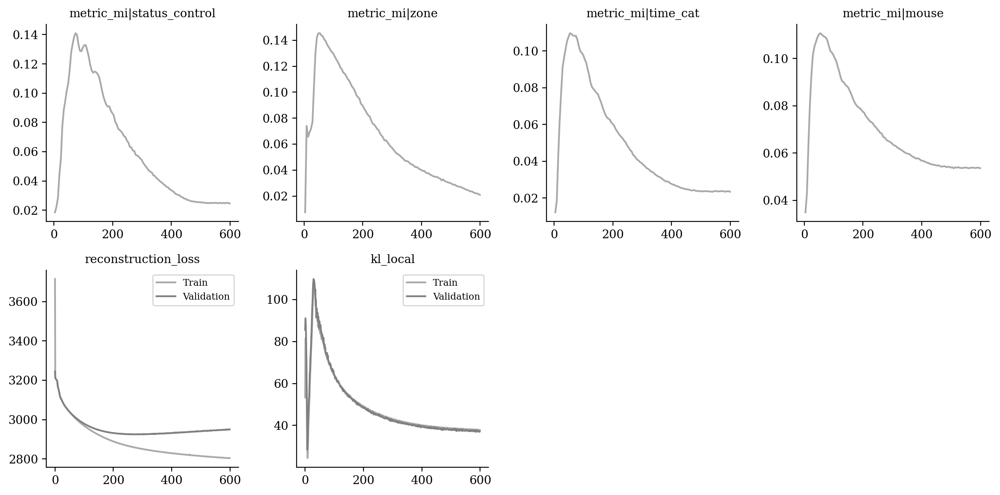

In [12]:
vae.plot_training_history(
    ignore_first=0,
    n_col=4,
    metrics_name=["metric_mi|status_control", "metric_mi|zone", "metric_mi|time_cat", "metric_mi|mouse",
                 "reconstruction_loss", "kl_local"]
)

In [13]:
from tardis._disentanglementmanager import DisentanglementManager as DM

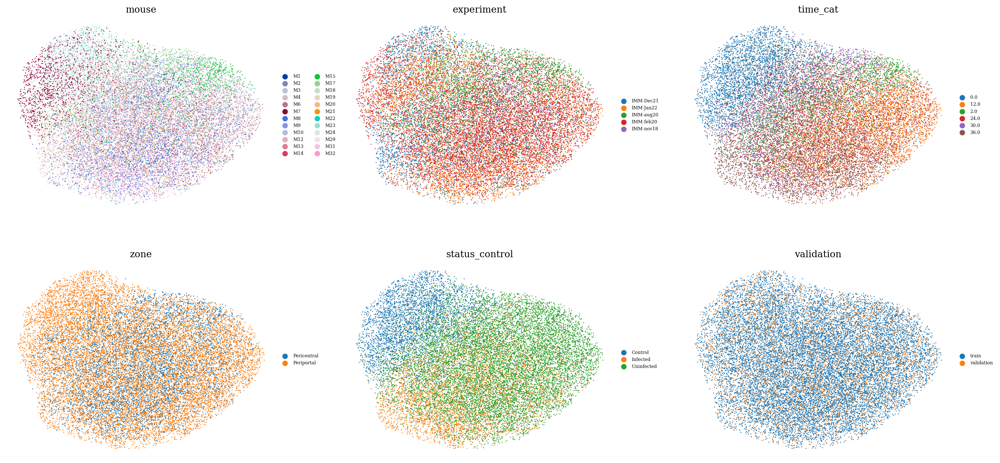

In [14]:
sublatent = DM.configurations.get_by_obs_key("status_control").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

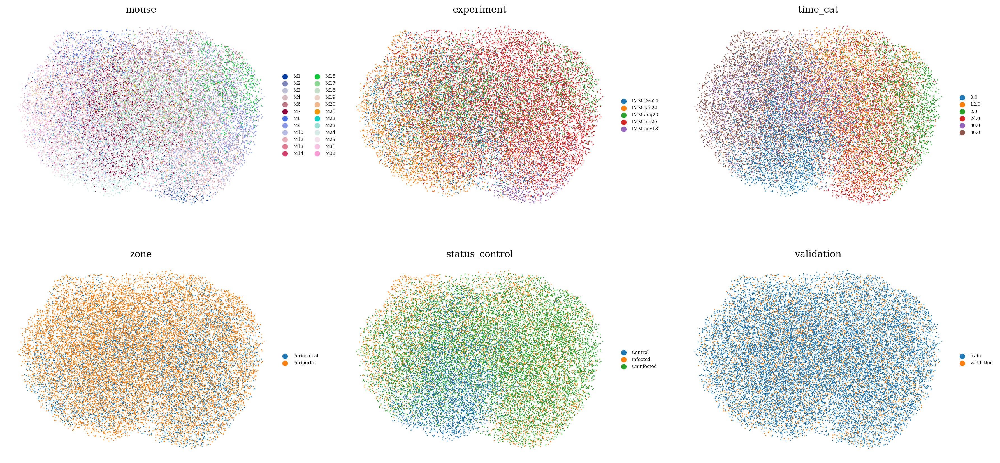

In [15]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

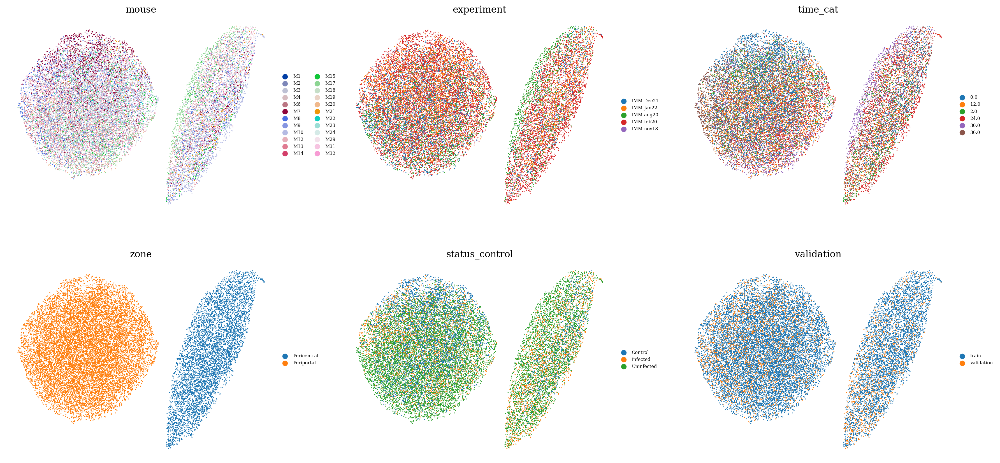

In [16]:
sublatent = DM.configurations.get_by_obs_key("zone").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

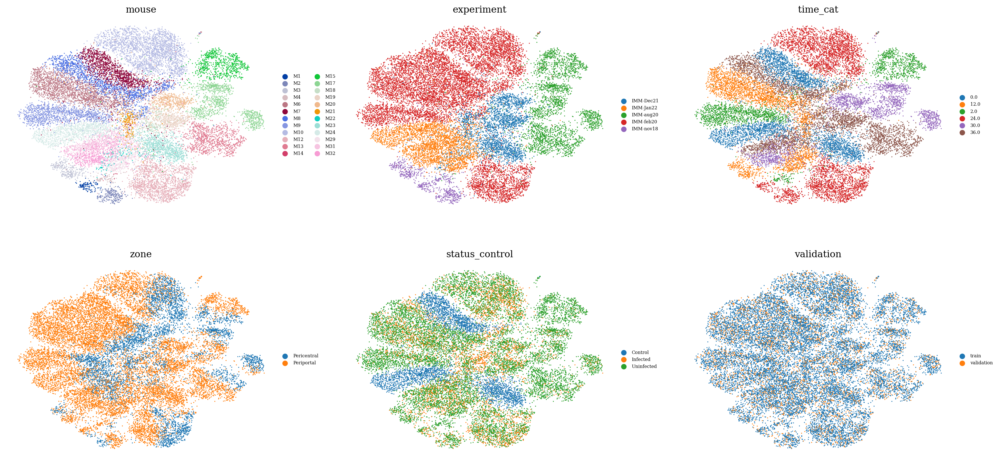

In [17]:
sublatent = DM.configurations.unreserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

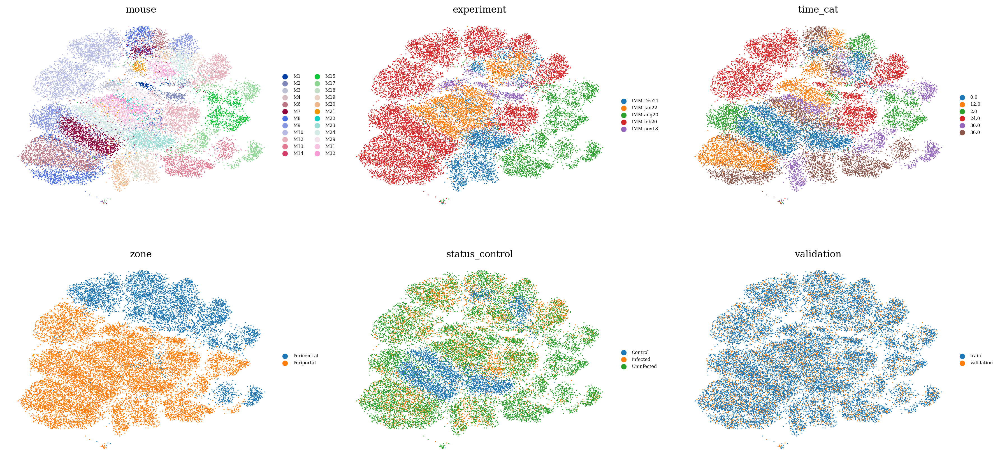

In [18]:
latent = ad.AnnData(X=vae.get_latent_representation(), obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

In [19]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())

In [20]:
latent = latent[latent.obs["time_cat"] == "12.0"]

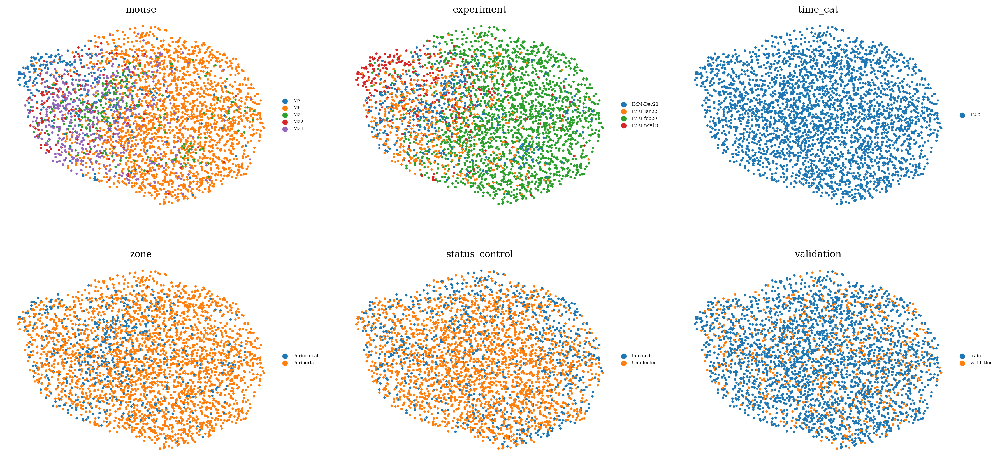

In [21]:
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )